# Studio del dataset Pima Indiands Diabete, EDA + Classificatore + Clustering + Modelli ensemble

## Step 1: Analisi Esplorativa dei dati


Per prima cosa, andiamo a caricare il dataset e capire come sono fatti i nostri dati, in particolare le dimensioni del dataset e le nostre feature


In [12]:
import pandas as pd
df = pd.read_csv('diabetes.csv')

In [13]:
df.shape

(768, 9)

In [14]:
df

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148,72,35,0,33.6,0.627,50,1
1,1,85,66,29,0,26.6,0.351,31,0
2,8,183,64,0,0,23.3,0.672,32,1
3,1,89,66,23,94,28.1,0.167,21,0
4,0,137,40,35,168,43.1,2.288,33,1
...,...,...,...,...,...,...,...,...,...
763,10,101,76,48,180,32.9,0.171,63,0
764,2,122,70,27,0,36.8,0.340,27,0
765,5,121,72,23,112,26.2,0.245,30,0
766,1,126,60,0,0,30.1,0.349,47,1


In [15]:
for ele in df.columns:
  print(ele)


Pregnancies
Glucose
BloodPressure
SkinThickness
Insulin
BMI
DiabetesPedigreeFunction
Age
Outcome


In [16]:
target_name='Outcome'

df_distr(df,target_name)


percentuale di classe 1: 35%
percentuale di classe 0: 65%
il dataset non è bilanciato


A questo punto, non essendo il dataset bilanciado è necessario usare tecniche di stratificazione negli step successivi


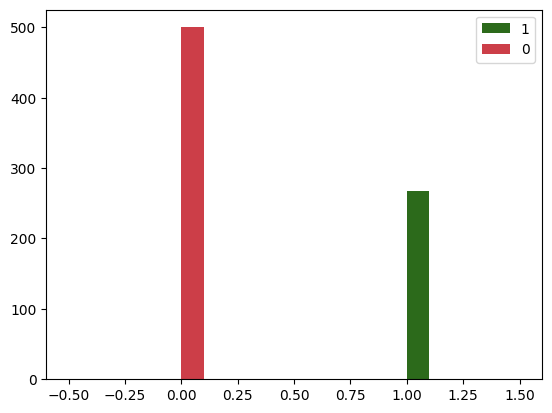

In [17]:
target_plot(df,target_name)

C:\Users\rocco\AppData\Local\Temp\ipykernel_17004\3868331504.py:58: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


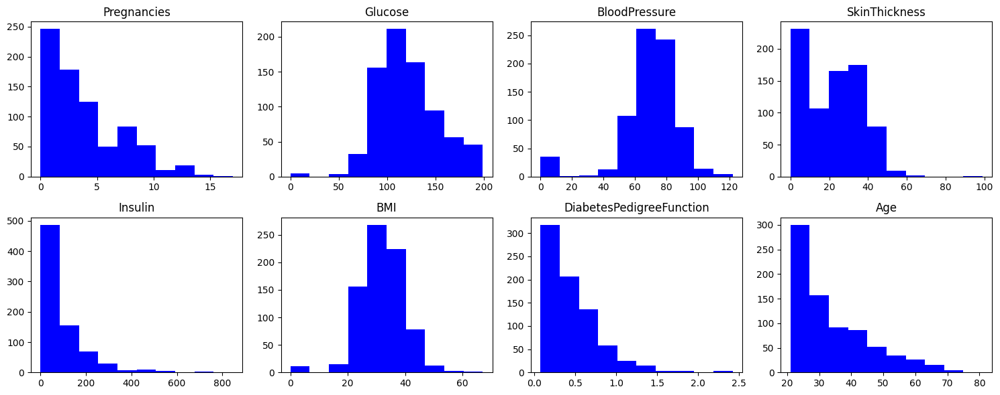

In [18]:
feature_hist(df, n_col=4)

Osserviamo a questo punto che ci sono diversi valori nulli in delle feature che non dovrebbero avere valori nulli, ad esempio BMI=0 implica un peso nullo e pressione sanguigna pari a 0 implica che il sangue sia fermo nei vasi sanguigni.

In [19]:
for ele in (df.columns):
  print("La variabile:",ele, "ha",(df[ele]==0).sum(),"valori nulli che equivalgono al:", round((df[ele]==0).sum()/len(df[ele])*100), "%")

La variabile: Pregnancies ha 111 valori nulli che equivalgono al: 14 %
La variabile: Glucose ha 5 valori nulli che equivalgono al: 1 %
La variabile: BloodPressure ha 35 valori nulli che equivalgono al: 5 %
La variabile: SkinThickness ha 227 valori nulli che equivalgono al: 30 %
La variabile: Insulin ha 374 valori nulli che equivalgono al: 49 %
La variabile: BMI ha 11 valori nulli che equivalgono al: 1 %
La variabile: DiabetesPedigreeFunction ha 0 valori nulli che equivalgono al: 0 %
La variabile: Age ha 0 valori nulli che equivalgono al: 0 %
La variabile: Outcome ha 500 valori nulli che equivalgono al: 65 %


Visto che nelle variabili BloodPressure e BMI la percentuale di zeri è bassa possiamo pensare di sostituire quei valori con la media della colonna eccetto quei valori, mentre per le variabili "Insulin" e "SkinThickness" avendo 49% e 30% potremmo pensare di eliminare entrambe le variabili per tale motivo piuttosto che sostituire i valori nulli, successivamente, proveremo entrambe le condizioni anche se possiamo dire che ragionevolmente che senza queste due variabili il nostro modello non dovrebbe peggiorare in termini di performance anzi potrebbe migliorare perchè un valore medio sul 50% del dataset potrebbe essere visto come una variabile di "rumore" piuttosto che come variabile informativa.
Di seguito proveremo diversi approcci per la gestione di questi valori nulli

### Correzione dei dati

Per le colonne che hanno pochi valori nulli possiamo sostituire con la media dei valori eccetto gli zeri

In [20]:
selection=["Glucose","BloodPressure","BMI"]
medie=[]
for col in selection:
    non_zero = df[col][df[col] != 0]
    medie.append(non_zero.mean())

df_adj=df.copy()
for col, media in zip(selection, medie):
    df_adj.loc[df_adj[col] == 0, col] = media

for ele in (df_adj.columns):
  print("La variabile:",ele, "ha",(df_adj[ele]==0).sum(),"valori nulli che equivalgono al:", round((df_adj[ele]==0).sum()/len(df_adj[ele])*100), "%")

La variabile: Pregnancies ha 111 valori nulli che equivalgono al: 14 %
La variabile: Glucose ha 0 valori nulli che equivalgono al: 0 %
La variabile: BloodPressure ha 0 valori nulli che equivalgono al: 0 %
La variabile: SkinThickness ha 227 valori nulli che equivalgono al: 30 %
La variabile: Insulin ha 374 valori nulli che equivalgono al: 49 %
La variabile: BMI ha 0 valori nulli che equivalgono al: 0 %
La variabile: DiabetesPedigreeFunction ha 0 valori nulli che equivalgono al: 0 %
La variabile: Age ha 0 valori nulli che equivalgono al: 0 %
La variabile: Outcome ha 500 valori nulli che equivalgono al: 65 %


Per le variabili "Insulin" e "SkinThickness" andiamo ad investigare meglio la natura dei dati considerando le sole righe che non hanno valori nulli e scartando l'altra variabile di indagine


#### Insulin

In [21]:
df_Insulin = df_adj.drop(columns=["SkinThickness", "Outcome"])
df_Insulin=df_Insulin.loc[df_adj["Insulin"] != 0, :]

df_Insulin

,Pregnancies,Glucose,BloodPressure,Insulin,BMI,DiabetesPedigreeFunction,Age
3,1,89.0,66.0,94,28.1,0.167,21
4,0,137.0,40.0,168,43.1,2.288,33
6,3,78.0,50.0,88,31.0,0.248,26
8,2,197.0,70.0,543,30.5,0.158,53
13,1,189.0,60.0,846,30.1,0.398,59
...,...,...,...,...,...,...,...
753,0,181.0,88.0,510,43.3,0.222,26
755,1,128.0,88.0,110,36.5,1.057,37
760,2,88.0,58.0,16,28.4,0.766,22
763,10,101.0,76.0,180,32.9,0.171,63


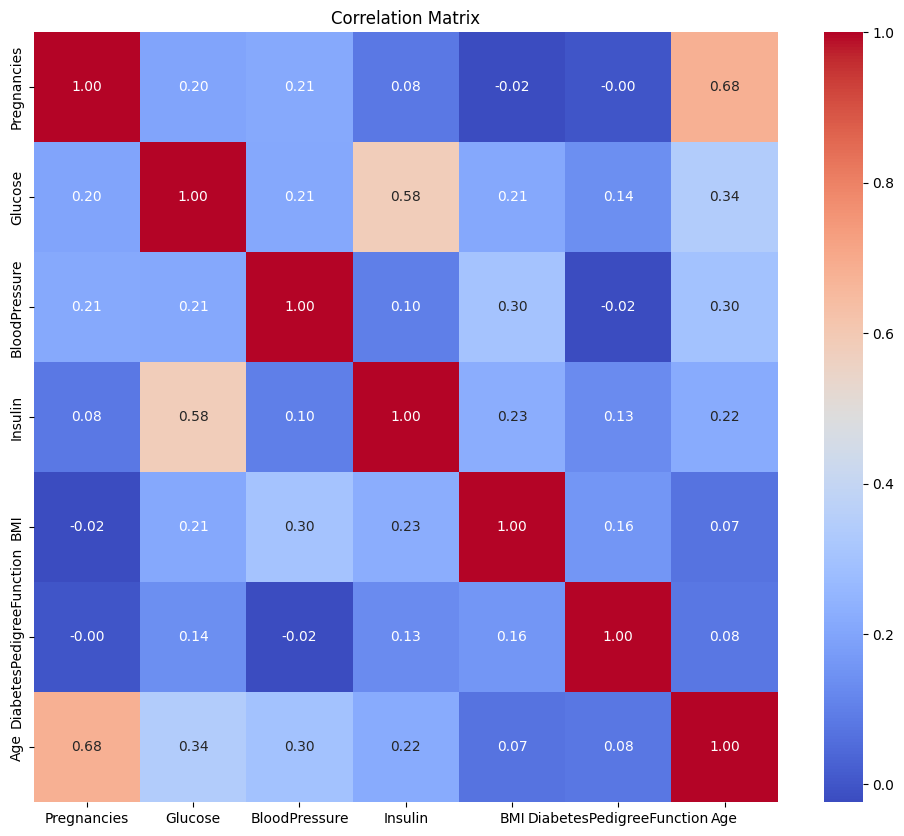

In [22]:
corr_matrix = df_Insulin.corr()
plt.figure(figsize=(12, 10))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Matrix')
plt.show()

Possiamo osservare come la variabile insulin sia correlata alla variabile Glucosio quindi possiamo andare a scartare la variabile risolvendo il problema dei valori nulli e senza perdere molta informazione in relazione al problema

In [23]:
df_adj = df_adj.drop(columns=["Insulin"])
df_adj

,Pregnancies,Glucose,BloodPressure,SkinThickness,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148.0,72.0,35,33.6,0.627,50,1
1,1,85.0,66.0,29,26.6,0.351,31,0
2,8,183.0,64.0,0,23.3,0.672,32,1
3,1,89.0,66.0,23,28.1,0.167,21,0
4,0,137.0,40.0,35,43.1,2.288,33,1
...,...,...,...,...,...,...,...,...
763,10,101.0,76.0,48,32.9,0.171,63,0
764,2,122.0,70.0,27,36.8,0.340,27,0
765,5,121.0,72.0,23,26.2,0.245,30,0
766,1,126.0,60.0,0,30.1,0.349,47,1


#### SkinThickness

In [24]:
df_st = df_adj.drop(columns=[ "Outcome"])
df_st=df_st.loc[df_adj["SkinThickness"] != 0, :]
df_st

,Pregnancies,Glucose,BloodPressure,SkinThickness,BMI,DiabetesPedigreeFunction,Age
0,6,148.0,72.0,35,33.6,0.627,50
1,1,85.0,66.0,29,26.6,0.351,31
3,1,89.0,66.0,23,28.1,0.167,21
4,0,137.0,40.0,35,43.1,2.288,33
6,3,78.0,50.0,32,31.0,0.248,26
...,...,...,...,...,...,...,...
761,9,170.0,74.0,31,44.0,0.403,43
763,10,101.0,76.0,48,32.9,0.171,63
764,2,122.0,70.0,27,36.8,0.340,27
765,5,121.0,72.0,23,26.2,0.245,30


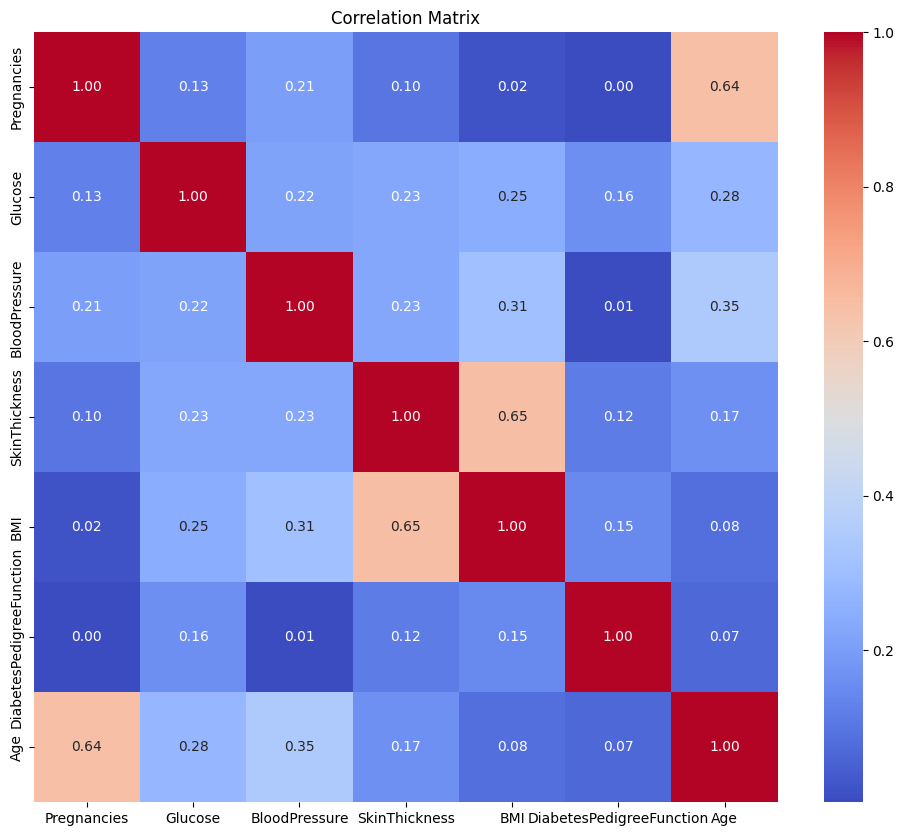

In [25]:
corr_matrix = df_st.corr()
plt.figure(figsize=(12, 10))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Matrix')
plt.show()

Possiamo osservare come la variabile SkinThickness sia correlata alla variabile BMI quindi possiamo andare a scartare la variabile risolvendo il problema dei valori nulli e senza perdere molta informazione in relazione al problema

In [26]:
df_adj = df_adj.drop(columns=["SkinThickness"])
df_adj

,Pregnancies,Glucose,BloodPressure,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148.0,72.0,33.6,0.627,50,1
1,1,85.0,66.0,26.6,0.351,31,0
2,8,183.0,64.0,23.3,0.672,32,1
3,1,89.0,66.0,28.1,0.167,21,0
4,0,137.0,40.0,43.1,2.288,33,1
...,...,...,...,...,...,...,...
763,10,101.0,76.0,32.9,0.171,63,0
764,2,122.0,70.0,36.8,0.340,27,0
765,5,121.0,72.0,26.2,0.245,30,0
766,1,126.0,60.0,30.1,0.349,47,1


#### Plot dei risultati

C:\Users\rocco\AppData\Local\Temp\ipykernel_17004\3868331504.py:89: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


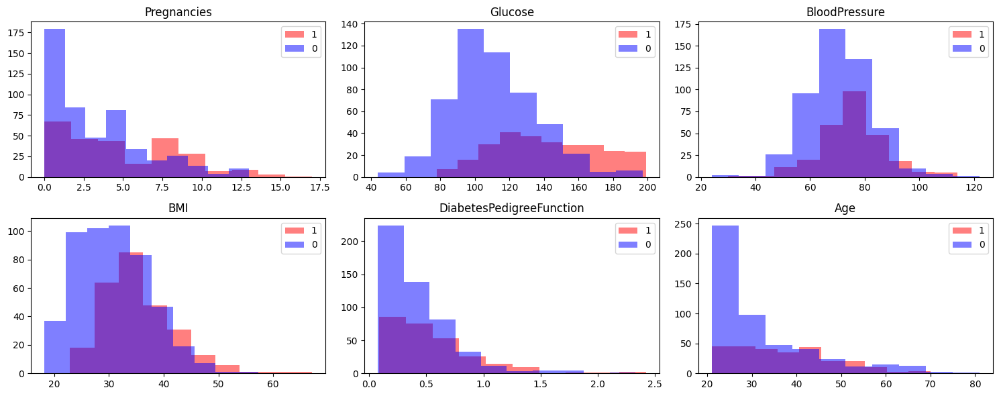

In [27]:
feature_in_labels(df_adj, 'Outcome',n_col=3)

Da questi grafici osserviamo come non ci sia una variabile che rimarca una netta separazione tra i nostri dati e quella che effettua una separazione maggiore rispetto alle altre ma comunque non rilevante è il Glucosio (il che ha senso dato che stiamo parlando di Diabete)

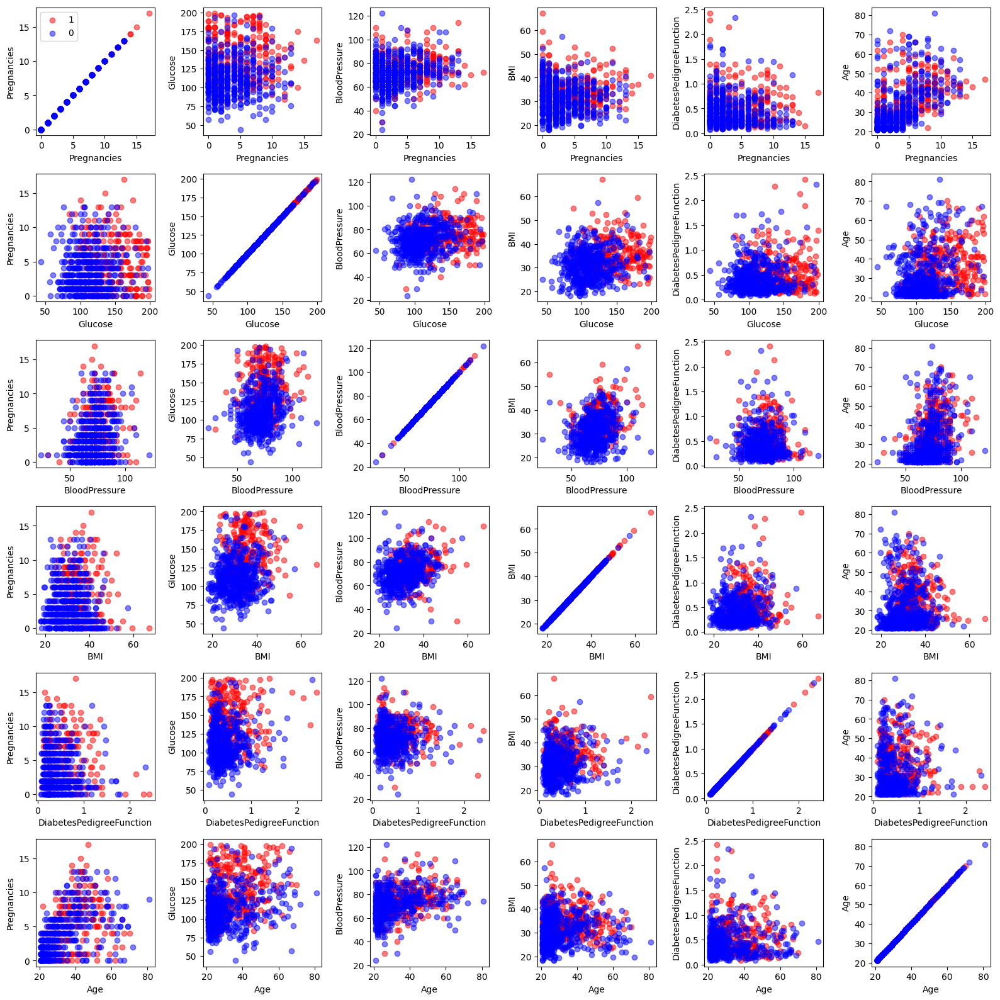

In [28]:
feature_in_labels_scatter(df_adj, 'Outcome')


Dagli scatterplot possiamo osservare che i nostri dati non sono linearmente separabili

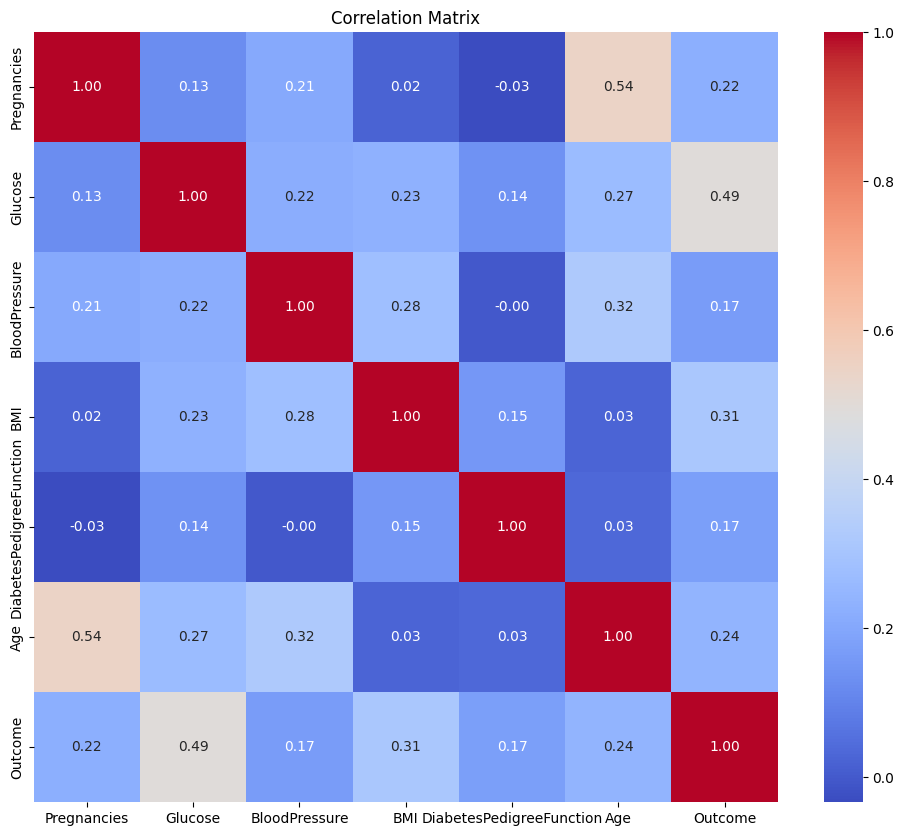

In [29]:
corr_matrix = df_adj.corr()
plt.figure(figsize=(12, 10))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Matrix')
plt.show()

Osserviamo che in generale non ci sono forti correlazioni tra le nostre feature, c'è una maggior correlazione tra età e gravidanze, il che ha senso essendo che una maggiore età implica un periodo di fertilità maggiore e quindi una probabilità di gravidanza più altra ma portandosi informazioni concettualmente diverse.
Inoltre osserviamo che la variabile outcome ha una forte correlazione con i livelli di Glucosio il che è coerente con il fatto che stiamo avendo a che fare con un dataset a tema diabete ed è coerente con l'osservazione fatta in precedenza relativamente alla minor sovrapposizione degli istogrammi per classe

## Step 2: Modello di predizione


Dato che abbiamo a fa che fare con pochi dati, 729 osservazioni non possiamo estrapolare fuori un validation set, tra i diversi modelli possiamo provare con un decision tree essendo che stiamo parlato di un dataset in ambito sanitario, dunque l'interpretabilità del modello può essere un fattore importante per poter estrapolare nuova conoscenza sul problema ed una SVM data la sua versatilità di configurazione grazie a tutti i suoi Kernel che effettuano una feature map e 


### Decision tree


Proviamo con un decision tree, facendo attenzione alla stratificazione di training e test set e scegliendo come criterio di split gini

Accuracy: 0.7316017316017316
              precision    recall  f1-score   support

           0       0.78      0.81      0.80       150
           1       0.63      0.58      0.60        81

    accuracy                           0.73       231
   macro avg       0.70      0.70      0.70       231
weighted avg       0.73      0.73      0.73       231

Outcome
0    150
1     81
Name: count, dtype: int64


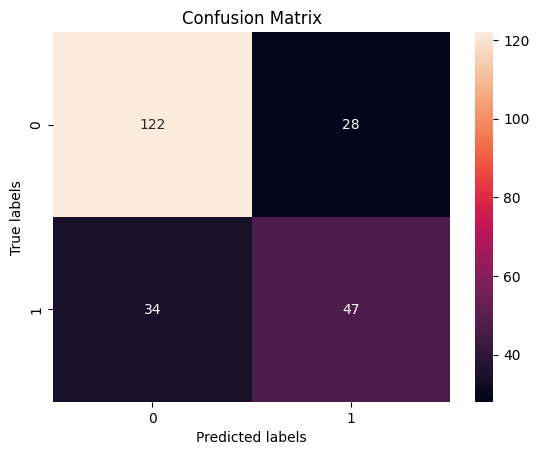

In [196]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score, classification_report, roc_curve, roc_auc_score
from sklearn import metrics
import matplotlib.pyplot as plt
import seaborn as sns

X = df_adj.drop(columns=['Outcome'])
y = df_adj['Outcome']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, stratify=y, random_state=42)

gini = DecisionTreeClassifier(
    criterion='gini',
    max_depth=10,
    random_state=42)

gini.fit(X_train, y_train)

y_pred = gini.predict(X_test)

accuracy = accuracy_score(y_test, y_pred)

print(f"Accuracy: {accuracy}")
print(classification_report(y_test, y_pred))

cf_matrix = metrics.confusion_matrix(y_test,y_pred, labels=[0,1])

ax= plt.subplot()

sns.heatmap(cf_matrix, annot=True, ax=ax, fmt='g')

ax.set_xlabel('Predicted labels');

ax.set_ylabel('True labels');

ax.set_title('Confusion Matrix');

print(y_test.value_counts())

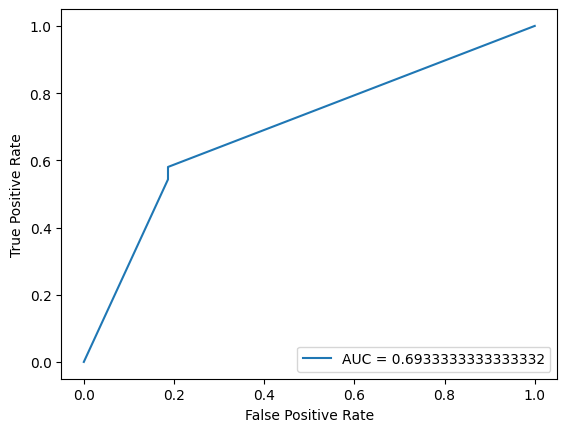

In [197]:
y_test_pred_prob = gini.predict_proba(X_test)[:, 1]
fpr, tpr, _ = roc_curve(y_test, y_test_pred_prob)
auc = roc_auc_score(y_test, y_test_pred_prob)
plt.figure()
plt.plot(fpr, tpr, label="AUC = " + str(auc))
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend(loc=4)
plt.show()


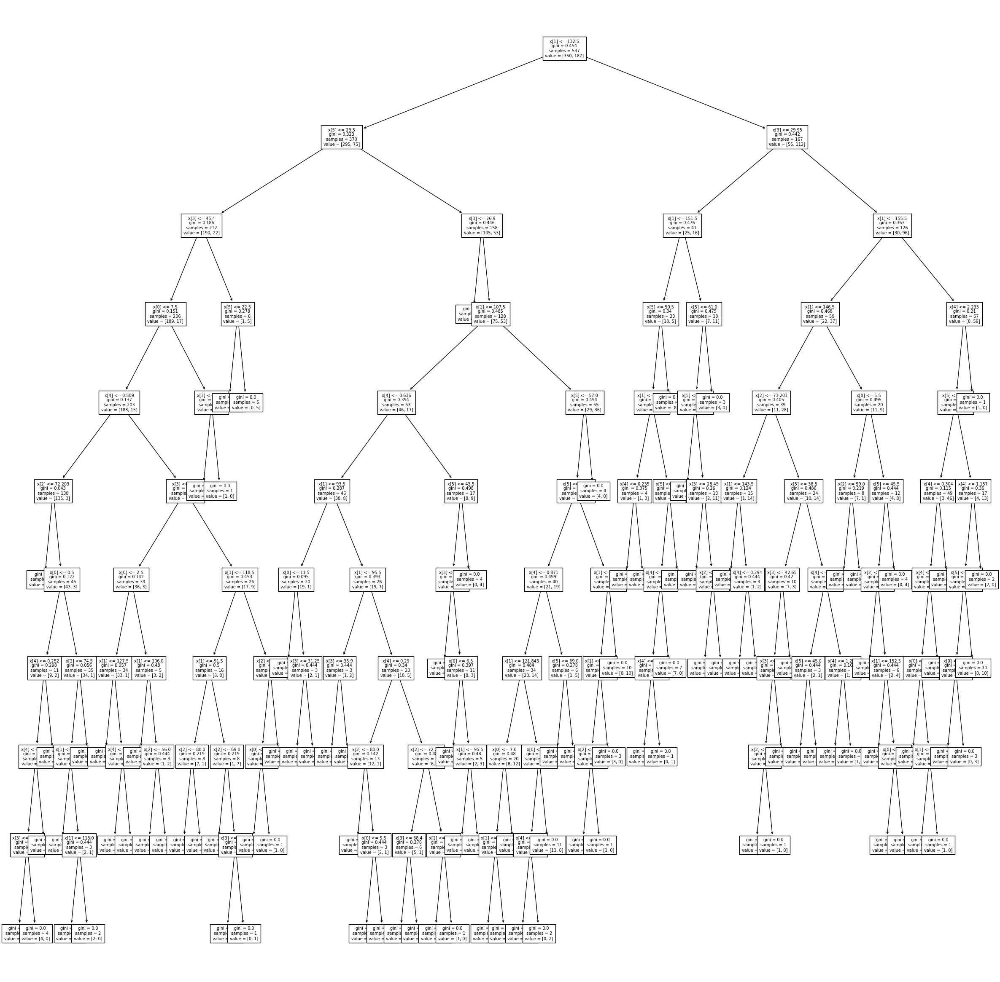

In [198]:
from sklearn import tree

plt.figure(figsize=(30,30))
tree.plot_tree(gini,fontsize=7)
plt.show()

Oltre alle performance, che non sono delle migliori, osserviamo come l'albero sia troppo profondo e vada creare dei nodi foglia con un solo campione, diventa necessario applicare dei criteri di pruning

Accuracy: 0.7705627705627706
              precision    recall  f1-score   support

           0       0.82      0.83      0.82       150
           1       0.68      0.67      0.67        81

    accuracy                           0.77       231
   macro avg       0.75      0.75      0.75       231
weighted avg       0.77      0.77      0.77       231

Outcome
0    150
1     81
Name: count, dtype: int64


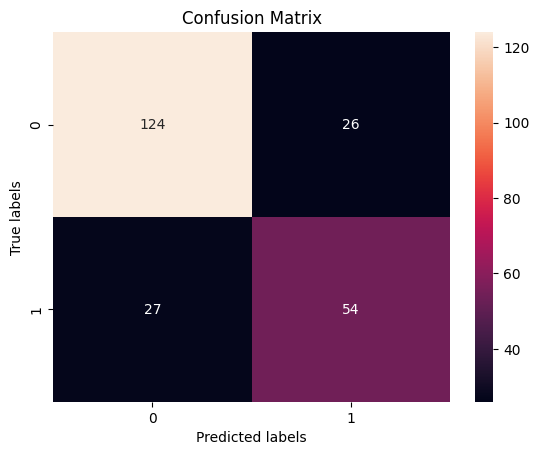

In [199]:
gini_prun = DecisionTreeClassifier(
    criterion='gini',
    max_depth=4,
    min_samples_leaf=10,
    random_state=42)

gini_prun.fit(X_train, y_train)

y_pred = gini_prun.predict(X_test)

accuracy = accuracy_score(y_test, y_pred)

print(f"Accuracy: {accuracy}")
print(classification_report(y_test, y_pred))

cf_matrix = metrics.confusion_matrix(y_test,y_pred, labels=[0,1])

ax= plt.subplot()

sns.heatmap(cf_matrix, annot=True, ax=ax, fmt='g')

ax.set_xlabel('Predicted labels');

ax.set_ylabel('True labels');

ax.set_title('Confusion Matrix');

print(y_test.value_counts())

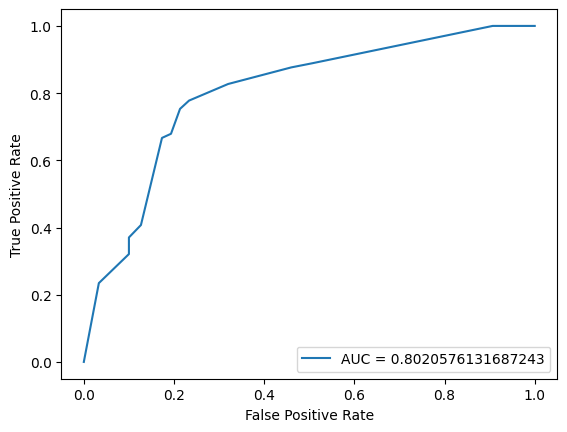

In [200]:
y_test_pred_prob = gini_prun.predict_proba(X_test)[:, 1]
fpr, tpr, _ = roc_curve(y_test, y_test_pred_prob)
auc = roc_auc_score(y_test, y_test_pred_prob)
plt.figure()
plt.plot(fpr, tpr, label="AUC = " + str(auc))
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')

plt.legend(loc=4)
plt.show()


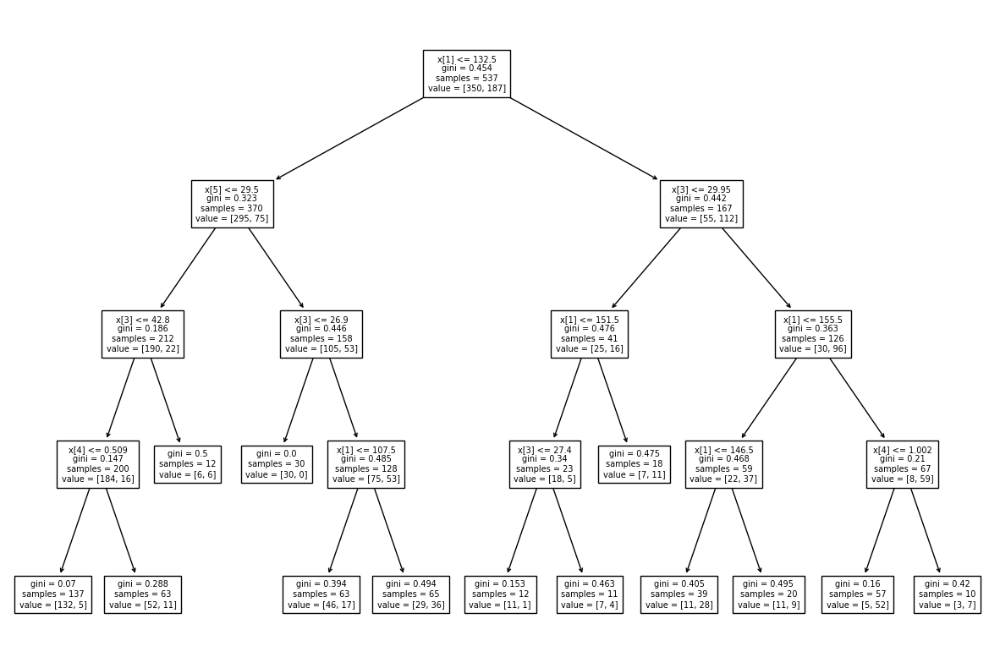

In [201]:
from sklearn import tree

plt.figure(figsize=(15,10))
tree.plot_tree(gini_prun,fontsize=7)
plt.show()

Osserviamo che a seguito del pruning le nostre performance sono visibilmente migliorate e abbiamo ottenuto nodi foglia con almeno 10 campioni all'interno, ci chiediamo quindi se con una scelta di iperparametri diversi otteniamo risultati che possono andarci meglio rispetto ai già buoni risultati ottenuti poichè abbiamo recall della classe "Diabetico" pari a 0.72 con una sorta di "Bilanciamento" tra Falsi positivi e Falsi negativi, dato che stiamo parlando di diabete possiamo accettare un minimo sbilanciamento a favore della riduzione dei falsi negativi perchè è un tipo di malattia cronica degenerativa

Accuracy: 0.7987012987012987
              precision    recall  f1-score   support

           0       0.89      0.79      0.84       100
           1       0.68      0.81      0.74        54

    accuracy                           0.80       154
   macro avg       0.78      0.80      0.79       154
weighted avg       0.81      0.80      0.80       154



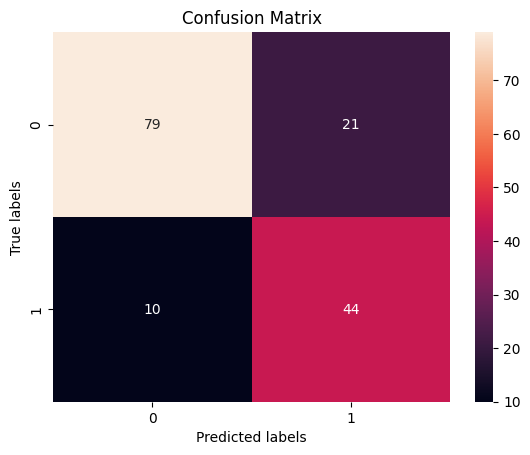

In [216]:
entropy_prun = DecisionTreeClassifier(
    criterion='entropy',
    max_depth=4,
    min_samples_leaf=10,
    random_state=42)

entropy_prun.fit(X_train, y_train)

y_pred = entropy_prun.predict(X_test)

accuracy = accuracy_score(y_test, y_pred)

print(f"Accuracy: {accuracy}")
print(classification_report(y_test, y_pred))

cf_matrix = metrics.confusion_matrix(y_test,y_pred, labels=[0,1])

ax= plt.subplot()

sns.heatmap(cf_matrix, annot=True, ax=ax, fmt='g')

ax.set_xlabel('Predicted labels');

ax.set_ylabel('True labels');

ax.set_title('Confusion Matrix');



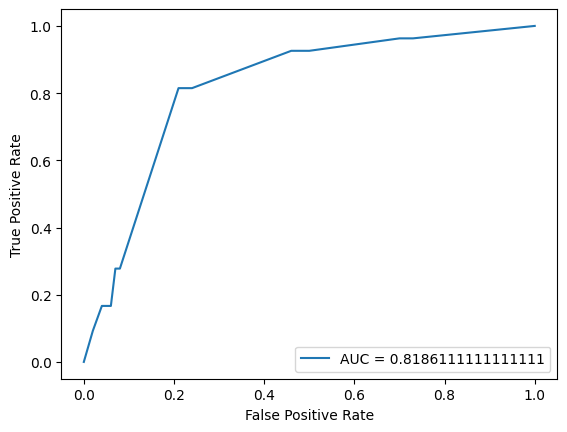

In [217]:
y_test_pred_prob = entropy_prun.predict_proba(X_test)[:, 1]
fpr, tpr, _ = roc_curve(y_test, y_test_pred_prob)
auc = roc_auc_score(y_test, y_test_pred_prob)
plt.figure()
plt.plot(fpr, tpr, label="AUC = " + str(auc))
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend(loc=4)
plt.show()


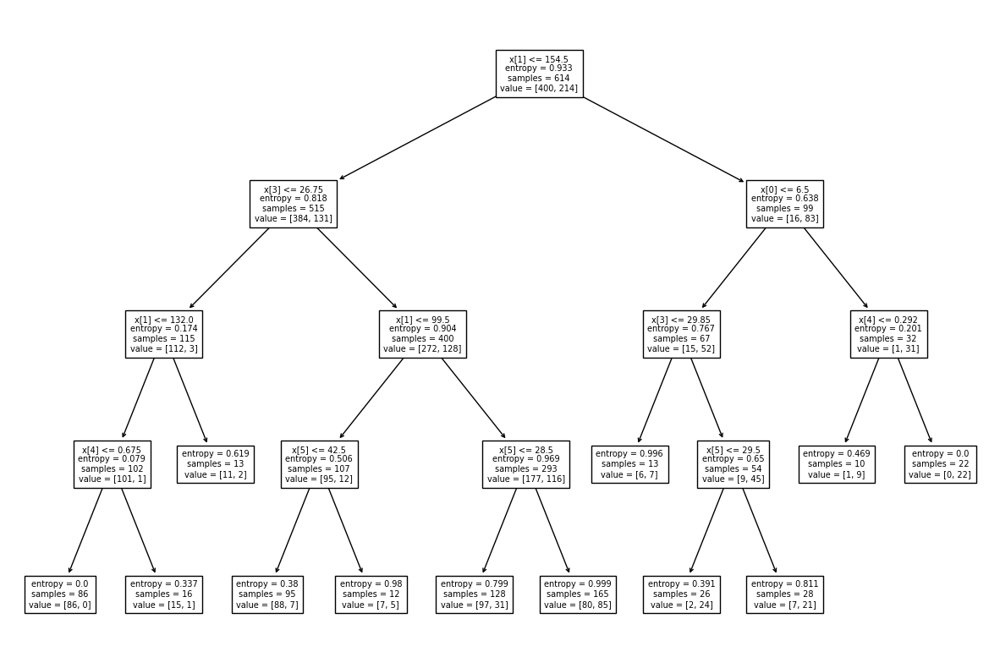

In [218]:
plt.figure(figsize=(15,10))
tree.plot_tree(entropy_prun,fontsize=7)
plt.show()

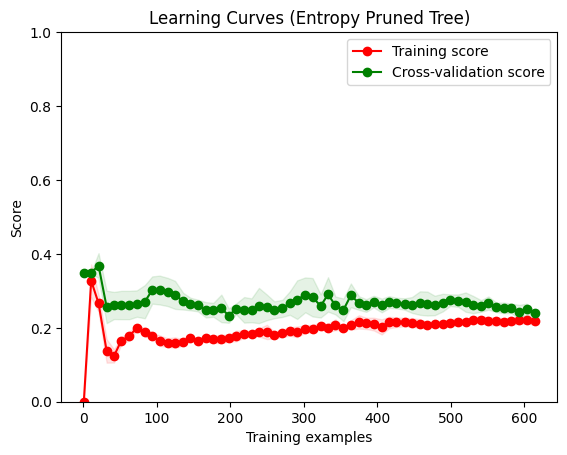

In [227]:
 cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

 train_sizes = np.linspace(1, 614, 60).astype(int)
 train_sizes, train_scores, test_scores = learning_curve(entropy_prun, np.concatenate([X_train, X_test]), np.concatenate([y_train, y_test]), cv=cv, train_sizes=train_sizes, scoring='accuracy')

 train_scores_mean = 1-np.mean(train_scores, axis=1)
 train_scores_std = np.std(train_scores, axis=1)
 test_scores_mean = 1-np.mean(test_scores, axis=1)
 test_scores_std = np.std(test_scores, axis=1)

 plt.figure()
 plt.title('Learning Curves (Entropy Pruned Tree)')
 plt.xlabel('Training examples')
 plt.ylabel('Score')
 plt.ylim(0.0,1)

 plt.fill_between(train_sizes, train_scores_mean - train_scores_std, train_scores_mean + train_scores_std, alpha=0.1, color='r')
 plt.plot(train_sizes, train_scores_mean, 'o-', color='r', label='Training score')

 plt.fill_between(train_sizes, test_scores_mean - test_scores_std, test_scores_mean + test_scores_std, alpha=0.1, color='g')
 plt.plot(train_sizes, test_scores_mean, 'o-', color='g', label='Cross-validation score')

 plt.legend(loc='best')
 plt.show()

Cambiando il metodo di split da gini ad entropy abbiamo ottenuto un miglioramento dell'accuracy che non ci entusiasma più di tanto, il risultato che a mio avviso ci fa scegliere questa come configurazione finale per questa famiglia di modelli è la recall sui diabetici di 0.82 nettamente migliore rispetto allo 0.71 del modello gini, questo ci porta come abbiamo detto in precedenza a favorire la presenza di falsi positivi che diventano 21 rispetto ai 17 precedenti ma allo stesso tempo ci porta la diminuzione dei falsi negativi che diventano 10 rispetto ai 15 di prima.

In definitiva applicando in maniera opporturna le teniche di pruning siamo riusciti a migliorare l'accuracy da 0.69 a 0.8 e grazie alla scelta del criterio di splitting abbiamo favorito la recall della classe "Diabetico" essendo una malattia degenerativa

### SVM

Proviamo con una SVM data la sua versatilità sfruttando i diversi kernel, analizziamo quindi per diversi kernel le condizioni di Hard e Soft Margin e gli iperparametri

#### Kernel Lineare

##### funzioni

In [403]:
def linear_svm(X_train, y_train, X_test, y_test, C, stratified = False):
 lin_svm= SVC(kernel='linear', probability=True, C=C)
 lin_svm.fit(X_train, y_train)
 y_pred = lin_svm.predict(X_test)
 accuracy = accuracy_score(y_test, y_pred)
 print(f"Accuracy: {accuracy}")
 print(classification_report(y_test, y_pred))
 cf_matrix = metrics.confusion_matrix(y_test, y_pred, labels=[0, 1])
 ax = plt.subplot()
 sns.heatmap(cf_matrix, annot=True, ax=ax, fmt='g')
 ax.set_xlabel('Predicted labels')
 ax.set_ylabel('True labels')
 ax.set_title('Confusion Matrix')
 y_test_pred_prob = lin_svm.predict_proba(X_test)[:, 1]
 fpr, tpr, _ = roc_curve(y_test, y_test_pred_prob)
 auc = roc_auc_score(y_test, y_test_pred_prob)
 plt.figure()
 plt.plot(fpr, tpr, label="AUC = " + str(auc))
 plt.xlabel('False Positive Rate')
 plt.ylabel('True Positive Rate')
 plt.legend(loc=4)
 plt.show()
 if (stratified == True):
  cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
 else:
  cv = KFold(n_splits=5, shuffle=True, random_state=42)
 train_sizes = np.linspace(1, 614, 50).astype(int)

 train_sizes, train_scores, test_scores = learning_curve(lin_svm, np.concatenate([X_train, X_test]), np.concatenate([y_train, y_test]), cv=cv, train_sizes=train_sizes, scoring='accuracy')

 train_scores_mean = 1-np.mean(train_scores, axis=1)
 train_scores_std = np.std(train_scores, axis=1)
 test_scores_mean = 1-np.mean(test_scores, axis=1)
 test_scores_std = np.std(test_scores, axis=1)

 plt.figure()
 plt.title('Learning Curves (Linear SVM)')
 plt.xlabel('Training examples')
 plt.ylabel('Score')
 plt.ylim(0.0, 1.1)

 plt.fill_between(train_sizes, train_scores_mean - train_scores_std, train_scores_mean + train_scores_std, alpha=0.1, color='r')
 plt.plot(train_sizes, train_scores_mean, 'o-', color='r', label='Training score')

 plt.fill_between(train_sizes, test_scores_mean - test_scores_std, test_scores_mean + test_scores_std, alpha=0.1, color='g')
 plt.plot(train_sizes, test_scores_mean, 'o-', color='g', label='Cross-validation score')

 plt.legend(loc='best')
 plt.show()

##### Modelli

Risultati per Kernel Lineare SVM Soft Margin, dati stratificati
Accuracy: 0.7012987012987013
              precision    recall  f1-score   support

           0       0.75      0.82      0.78       100
           1       0.59      0.48      0.53        54

    accuracy                           0.70       154
   macro avg       0.67      0.65      0.66       154
weighted avg       0.69      0.70      0.69       154



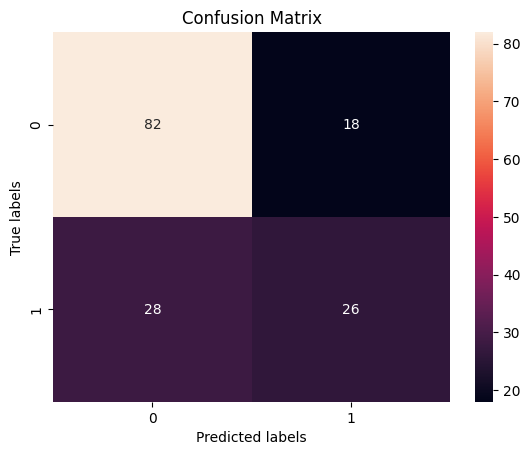

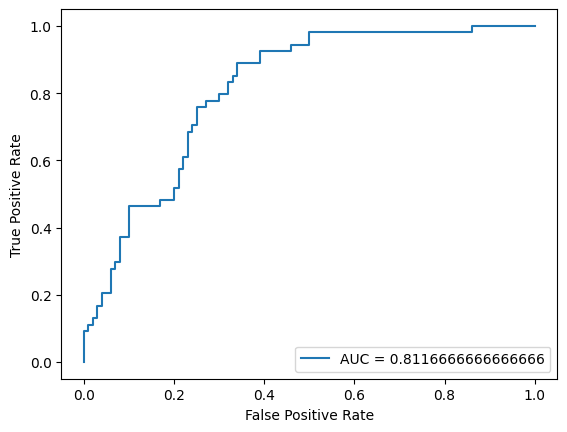

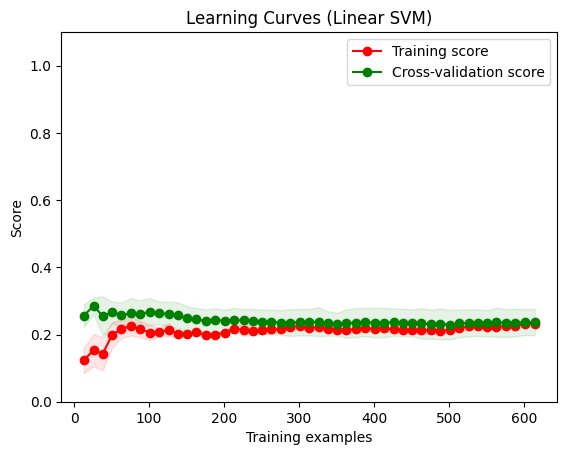

In [23]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, classification_report, roc_curve, roc_auc_score, make_scorer
from sklearn import metrics
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler

X = df_adj.drop(columns=['Outcome'])
y = df_adj['Outcome']

X_train_s, X_test_s, y_train_s, y_test_s = train_test_split(X, y, test_size=0.2, stratify=y, random_state=42)

scaler=StandardScaler()
scaler.fit(X_train_s)
X_train_s = scaler.transform(X_train_s)
X_test_s = scaler.transform(X_test_s)

print("Risultati per Kernel Lineare SVM Soft Margin, dati stratificati")
linear_svm(X_train_s, y_train_s, X_test_s, y_test_s, 0.1, True)

Risultati per Kernel Lineare SVM Soft Margin, dati NON stratificati
Accuracy: 0.7532467532467533
              precision    recall  f1-score   support

           0       0.80      0.83      0.81        99
           1       0.67      0.62      0.64        55

    accuracy                           0.75       154
   macro avg       0.73      0.72      0.73       154
weighted avg       0.75      0.75      0.75       154



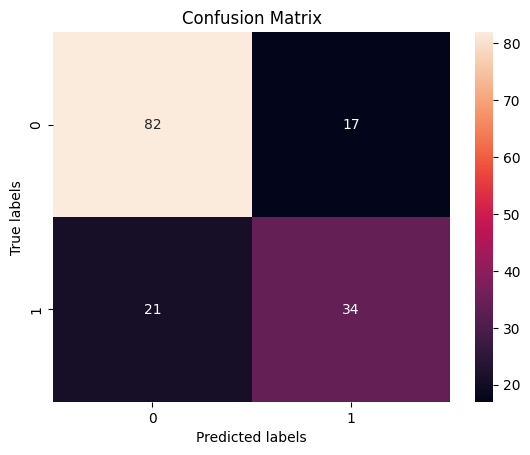

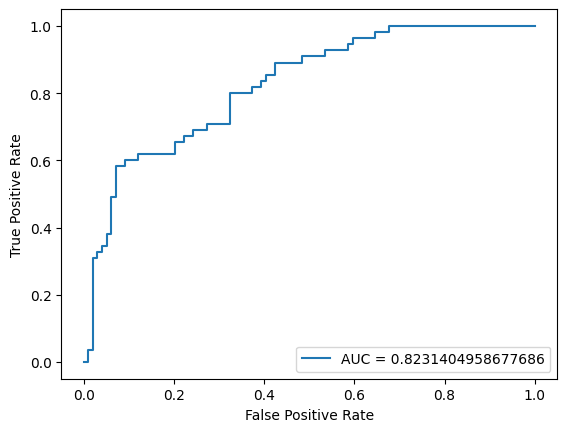

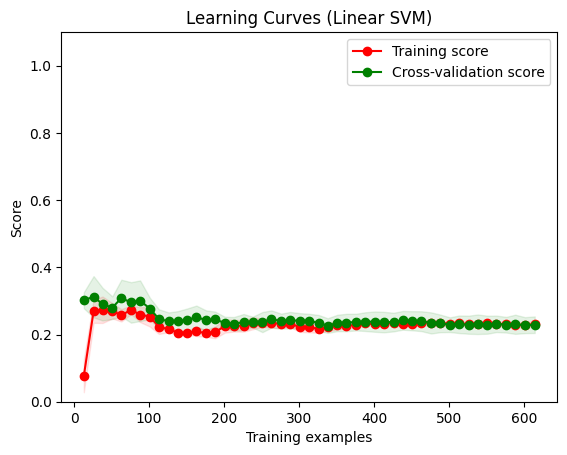

In [404]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

scaler=StandardScaler()
scaler.fit(X_train)
X_train = scaler.transform(X_train)
X_test = scaler.transform(X_test)

print("Risultati per Kernel Lineare SVM Soft Margin, dati NON stratificati")
linear_svm(X_train, y_train, X_test, y_test, 0.1)


Osserviamo che per una SVM a Kernel lineare Soft margin, i dati non stratificati ci danno risultati migliori in termini di metriche, vediamo adesso una SVM Hard Margin

Risultati per Kernel Lineare SVM Hard Margin, dati stratificati
Accuracy: 0.7077922077922078
              precision    recall  f1-score   support

           0       0.75      0.83      0.79       100
           1       0.60      0.48      0.54        54

    accuracy                           0.71       154
   macro avg       0.68      0.66      0.66       154
weighted avg       0.70      0.71      0.70       154



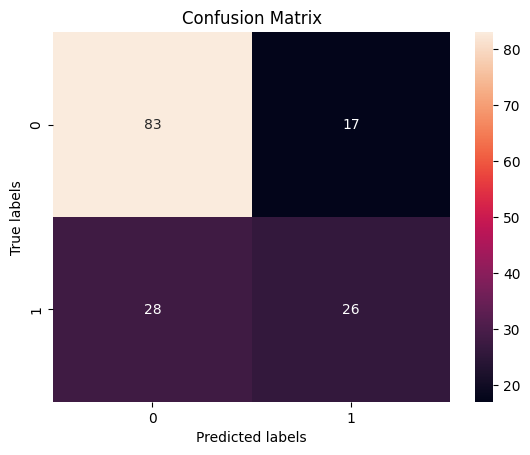

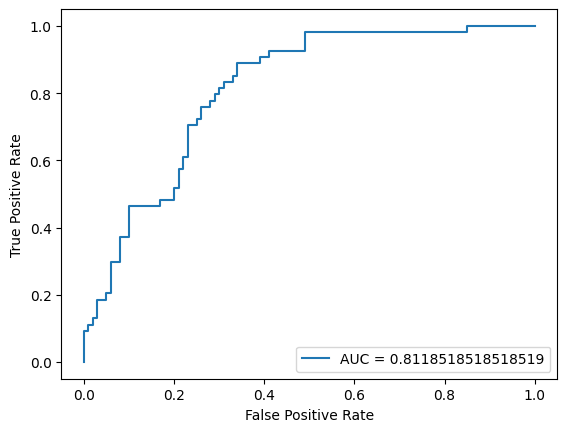

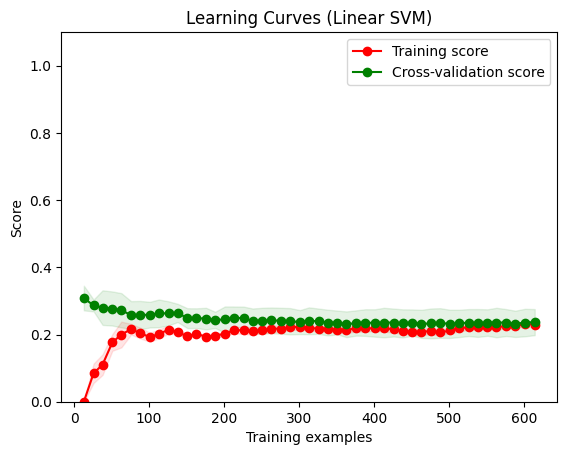

In [25]:
print("Risultati per Kernel Lineare SVM Hard Margin, dati stratificati")
linear_svm(X_train_s, y_train_s, X_test_s, y_test_s, 1000, True)


Risultati per Kernel Lineare SVM Hard margin, dati  NON stratificati
Accuracy: 0.7402597402597403
              precision    recall  f1-score   support

           0       0.79      0.81      0.80        99
           1       0.64      0.62      0.63        55

    accuracy                           0.74       154
   macro avg       0.72      0.71      0.71       154
weighted avg       0.74      0.74      0.74       154



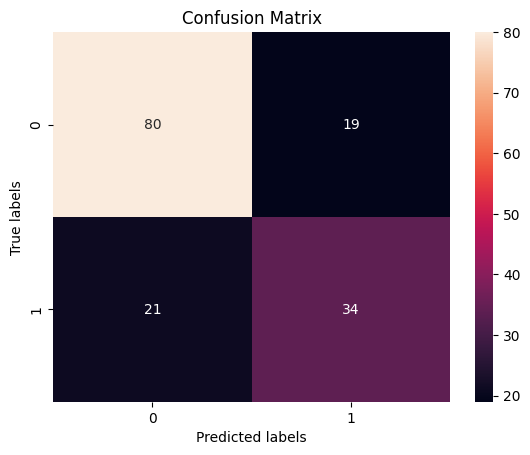

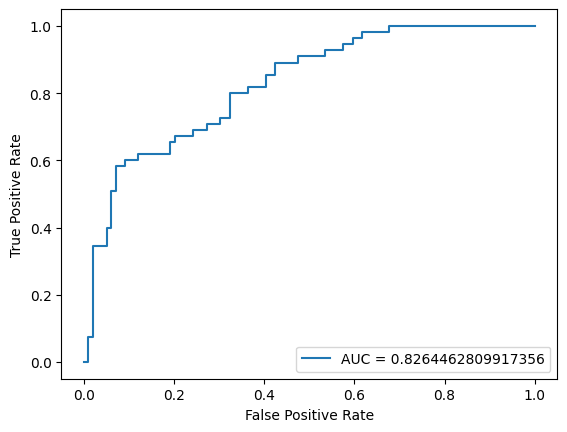

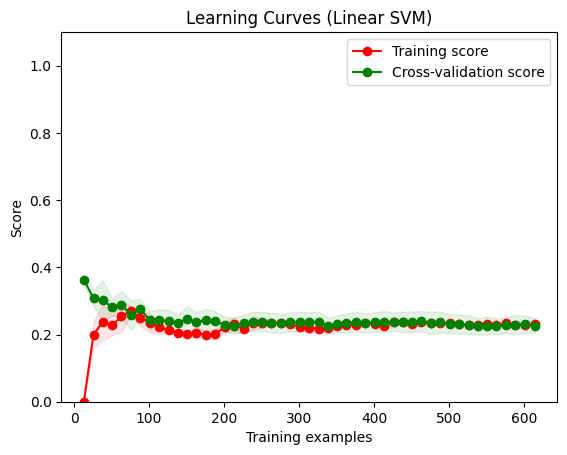

In [26]:
print("Risultati per Kernel Lineare SVM Hard margin, dati  NON stratificati")
linear_svm(X_train, y_train, X_test, y_test, 1000)

Possiamo osservare che il miglior modello ottenuto per il kernel lineare è una SVM Hard Margin con dati training e test stratificati, questo non solo in virtù delle metriche di score che sono identiche a quelle per una SVM Soft Margin stratificata ma anche osservando le learning curve e l'AUC che è lievemente maggiore

#### Kernel Gaussiano

##### funzioni

In [405]:
def gauss_svm(X_train, y_train, X_test, y_test, C, gamma, stratified = False):
 gaus_svm = SVC(kernel='rbf', C=C, gamma=gamma, probability=True)
 gaus_svm.fit(X_train, y_train)
 y_pred = gaus_svm.predict(X_test)
 y_test_pred_prob = gaus_svm.predict_proba(X_test)[:, 1]

 accuracy = accuracy_score(y_test, y_pred)


 uc = roc_auc_score(y_test, y_test_pred_prob)
 print(f"Accuracy: {accuracy}")
 print(classification_report(y_test, y_pred))

 cf_matrix = metrics.confusion_matrix(y_test, y_pred, labels=[0, 1])
 ax = plt.subplot()
 sns.heatmap(cf_matrix, annot=True, ax=ax, fmt='g')
 ax.set_xlabel('Predicted labels')
 ax.set_ylabel('True labels')
 ax.set_title('Confusion Matrix')
 plt.show()
 y_test_pred_prob = gaus_svm.predict_proba(X_test)[:, 1]
 fpr, tpr, _ = roc_curve(y_test, y_test_pred_prob)
 auc = roc_auc_score(y_test, y_test_pred_prob)
 plt.figure()
 plt.plot(fpr, tpr, label="AUC = " + str(auc))
 plt.xlabel('False Positive Rate')
 plt.ylabel('True Positive Rate')
 plt.legend(loc=4)
 plt.show()
 if (stratified == True):
  cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
 else:
  cv = KFold(n_splits=5, shuffle=True, random_state=42)
 train_sizes = np.linspace(1, 614, 50).astype(int)

 train_sizes, train_scores, test_scores = learning_curve(gaus_svm, np.concatenate([X_train, X_test]), np.concatenate([y_train, y_test]), cv=cv, train_sizes=train_sizes, scoring='accuracy')

 train_scores_mean = 1-np.mean(train_scores, axis=1)
 train_scores_std = np.std(train_scores, axis=1)
 test_scores_mean = 1-np.mean(test_scores, axis=1)
 test_scores_std = np.std(test_scores, axis=1)

 plt.figure()
 plt.title('Learning Curves (Linear SVM)')
 plt.xlabel('Training examples')
 plt.ylabel('Score')
 plt.ylim(0.0, 1.1)

 plt.fill_between(train_sizes, train_scores_mean - train_scores_std, train_scores_mean + train_scores_std, alpha=0.1, color='r')
 plt.plot(train_sizes, train_scores_mean, 'o-', color='r', label='Training score')

 plt.fill_between(train_sizes, test_scores_mean - test_scores_std, test_scores_mean + test_scores_std, alpha=0.1, color='g')
 plt.plot(train_sizes, test_scores_mean, 'o-', color='g', label='Cross-validation score')

 plt.legend(loc='best')
 plt.show()


##### Modelli

###### Dati Stratificati

Risultati per Kernel Gaussiano Soft margin, gamma basso, dati stratificati
Accuracy: 0.7337662337662337
              precision    recall  f1-score   support

           0       0.76      0.87      0.81       100
           1       0.67      0.48      0.56        54

    accuracy                           0.73       154
   macro avg       0.71      0.68      0.68       154
weighted avg       0.73      0.73      0.72       154



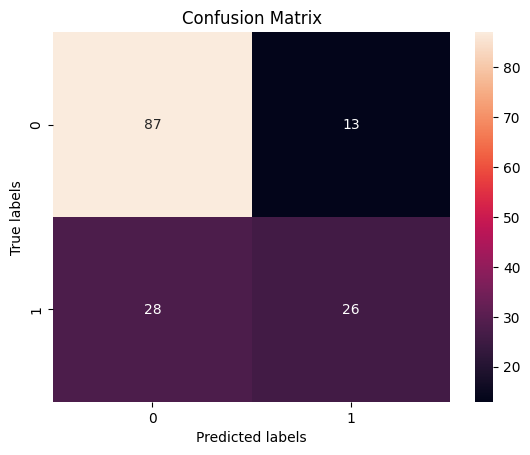

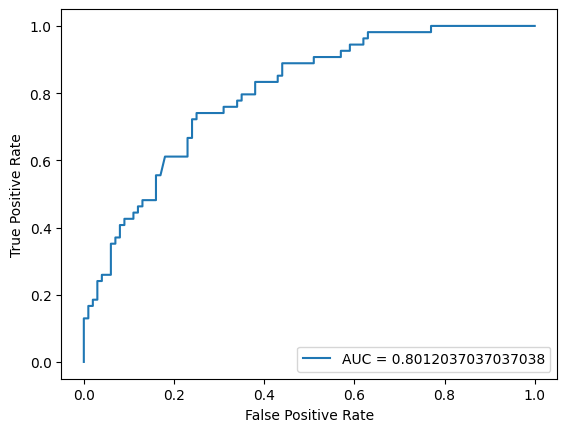

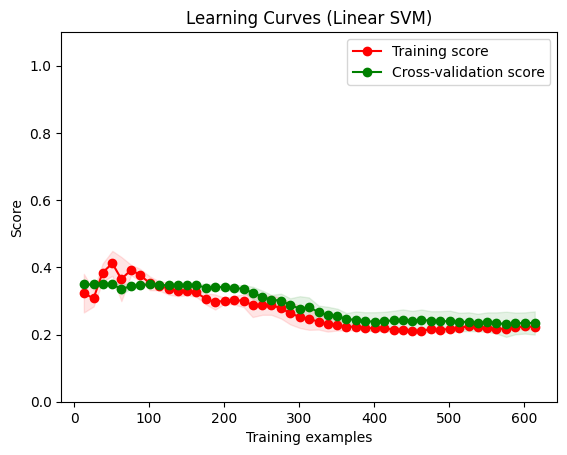

In [30]:
print("Risultati per Kernel Gaussiano Soft margin, gamma basso, dati stratificati")
gauss_svm(X_train_s, y_train_s, X_test_s, y_test_s, C=0.1, gamma=0.1, stratified =True)

Risultati per Kernel Gaussiano Hard margin, gamma basso, dati stratificati
Accuracy: 0.6753246753246753
              precision    recall  f1-score   support

           0       0.73      0.80      0.76       100
           1       0.55      0.44      0.49        54

    accuracy                           0.68       154
   macro avg       0.64      0.62      0.63       154
weighted avg       0.66      0.68      0.67       154



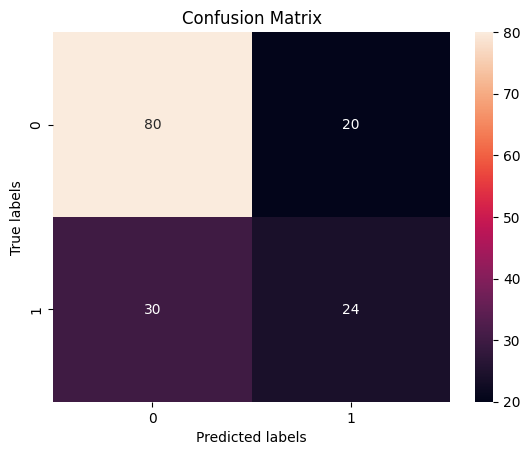

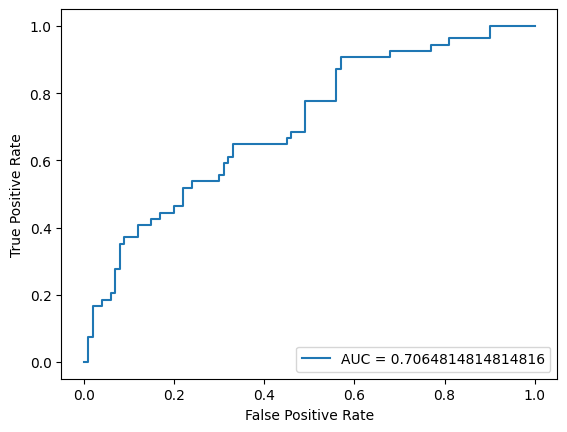

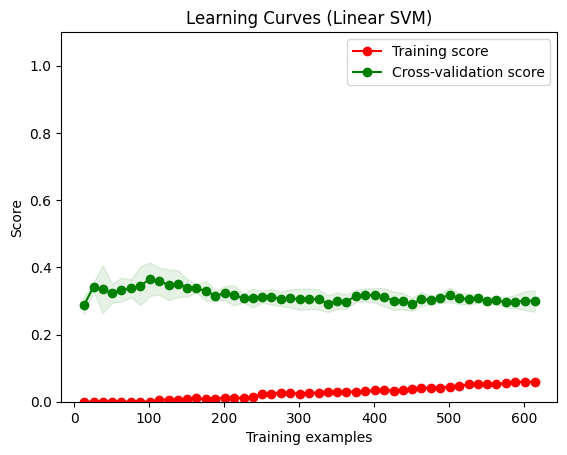

In [31]:
print("Risultati per Kernel Gaussiano Hard margin, gamma basso, dati stratificati")
gauss_svm(X_train_s, y_train_s, X_test_s, y_test_s, C=1000, gamma=0.1, stratified =True)

Risultati per Kernel Gaussiano Soft margin, gamma alto, dati stratificati
Accuracy: 0.6493506493506493
              precision    recall  f1-score   support

           0       0.65      1.00      0.79       100
           1       0.00      0.00      0.00        54

    accuracy                           0.65       154
   macro avg       0.32      0.50      0.39       154
weighted avg       0.42      0.65      0.51       154



c:\Users\rocco\AppData\Local\Programs\Python\Python39\lib\site-packages\sklearn\metrics\_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\rocco\AppData\Local\Programs\Python\Python39\lib\site-packages\sklearn\metrics\_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\rocco\AppData\Local\Programs\Python\Python39\lib\site-packages\sklearn\metrics\_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, mo

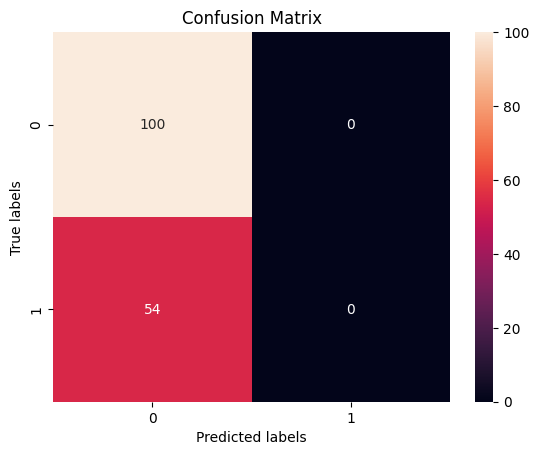

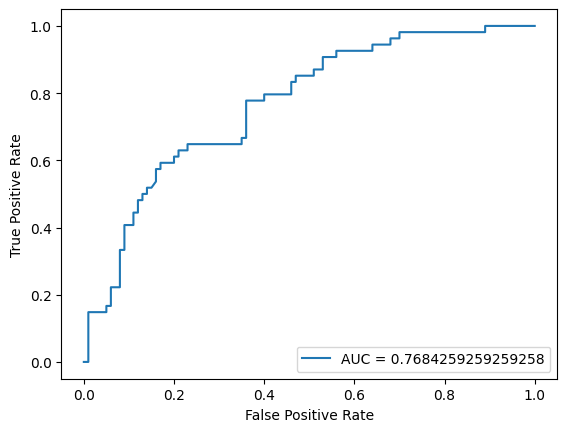

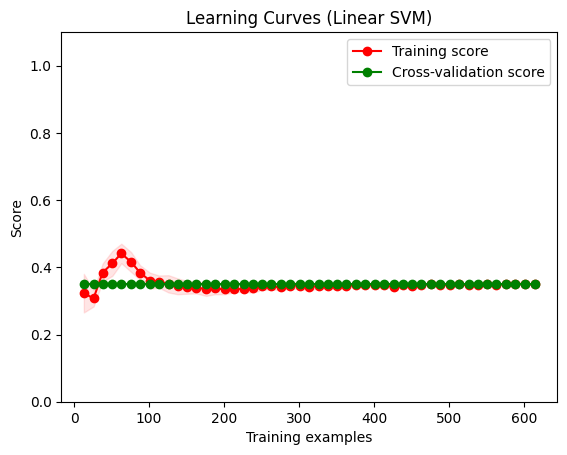

In [32]:
print("Risultati per Kernel Gaussiano Soft margin, gamma alto, dati stratificati")
gauss_svm(X_train_s, y_train_s, X_test_s, y_test_s, C=0.01, gamma=1, stratified =True)

Risultati per Kernel Gaussiano Hard margin, gamma alto, dati stratificati
Accuracy: 0.7207792207792207
              precision    recall  f1-score   support

           0       0.77      0.82      0.79       100
           1       0.62      0.54      0.57        54

    accuracy                           0.72       154
   macro avg       0.69      0.68      0.68       154
weighted avg       0.71      0.72      0.72       154



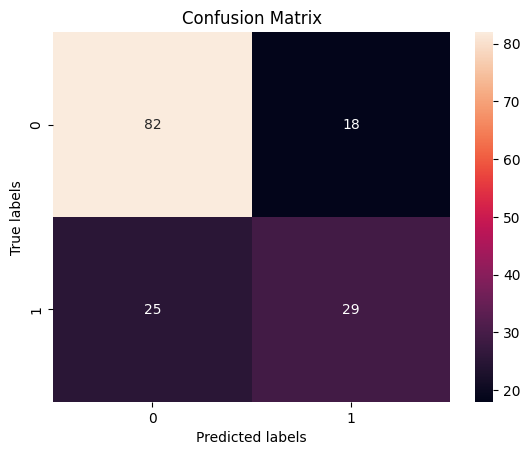

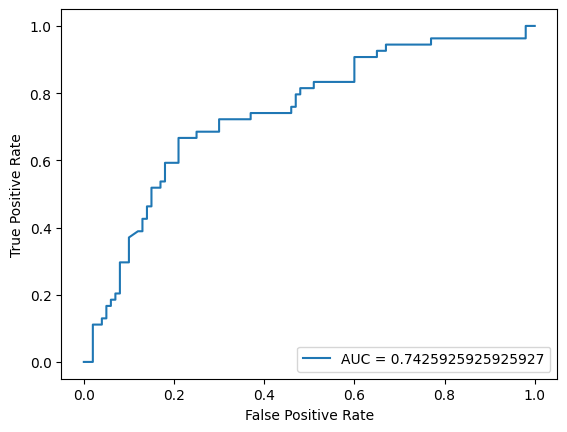

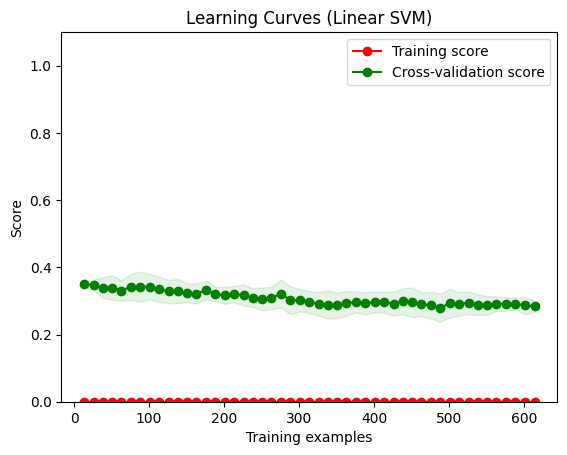

In [33]:
print("Risultati per Kernel Gaussiano Hard margin, gamma alto, dati stratificati")
gauss_svm(X_train_s, y_train_s, X_test_s, y_test_s, C=1000, gamma=1, stratified =True)

###### Dati NON Stratificati

Risultati per Kernel Gaussiano Soft margin, gamma basso, dati NON stratificati
Accuracy: 0.7857142857142857
              precision    recall  f1-score   support

           0       0.81      0.88      0.84        99
           1       0.74      0.62      0.67        55

    accuracy                           0.79       154
   macro avg       0.77      0.75      0.76       154
weighted avg       0.78      0.79      0.78       154



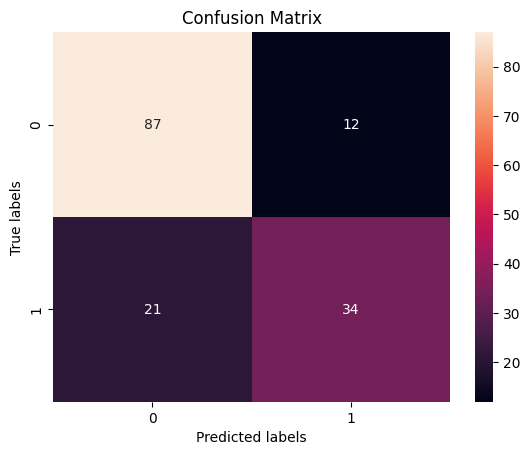

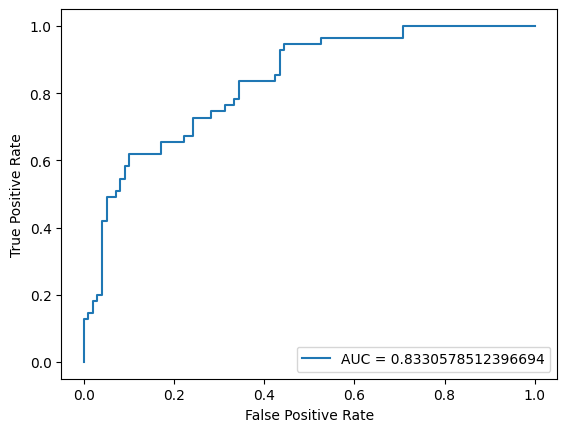

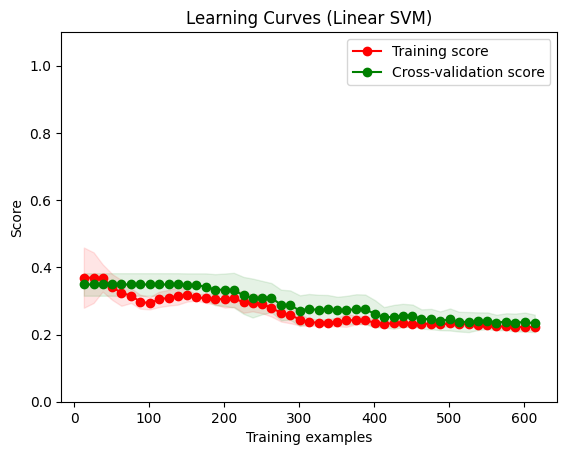

In [34]:
print("Risultati per Kernel Gaussiano Soft margin, gamma basso, dati NON stratificati")
gauss_svm(X_train, y_train, X_test, y_test, C=0.1, gamma=0.1)

Risultati per Kernel Gaussiano Hard margin, gamma basso, dati NON stratificati
Accuracy: 0.7467532467532467
              precision    recall  f1-score   support

           0       0.81      0.79      0.80        99
           1       0.64      0.67      0.65        55

    accuracy                           0.75       154
   macro avg       0.73      0.73      0.73       154
weighted avg       0.75      0.75      0.75       154



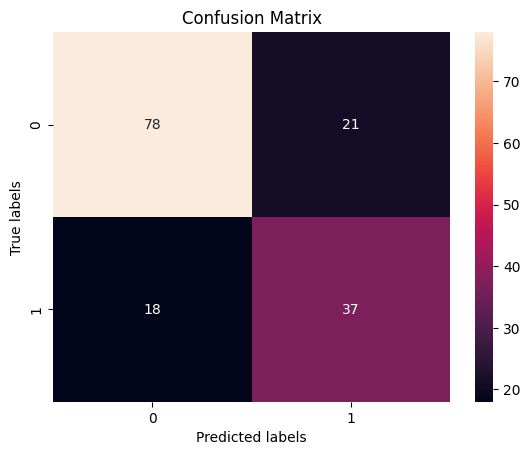

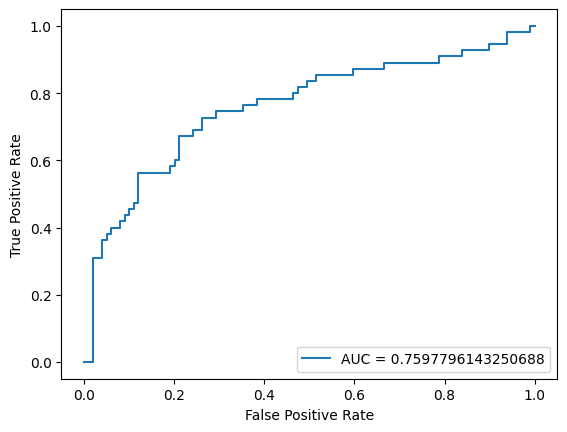

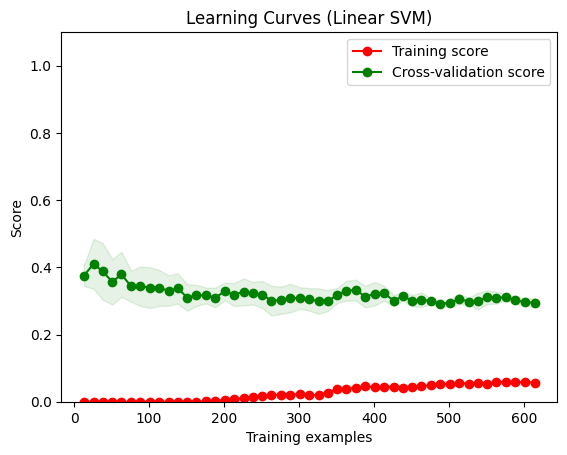

In [35]:
print("Risultati per Kernel Gaussiano Hard margin, gamma basso, dati NON stratificati")
gauss_svm(X_train, y_train, X_test, y_test, C=1000, gamma=0.1)

Risultati per Kernel Gaussiano Soft margin, gamma alto, dati NON stratificati
Accuracy: 0.6428571428571429
              precision    recall  f1-score   support

           0       0.64      1.00      0.78        99
           1       0.00      0.00      0.00        55

    accuracy                           0.64       154
   macro avg       0.32      0.50      0.39       154
weighted avg       0.41      0.64      0.50       154



c:\Users\rocco\AppData\Local\Programs\Python\Python39\lib\site-packages\sklearn\metrics\_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\rocco\AppData\Local\Programs\Python\Python39\lib\site-packages\sklearn\metrics\_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\rocco\AppData\Local\Programs\Python\Python39\lib\site-packages\sklearn\metrics\_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, mo

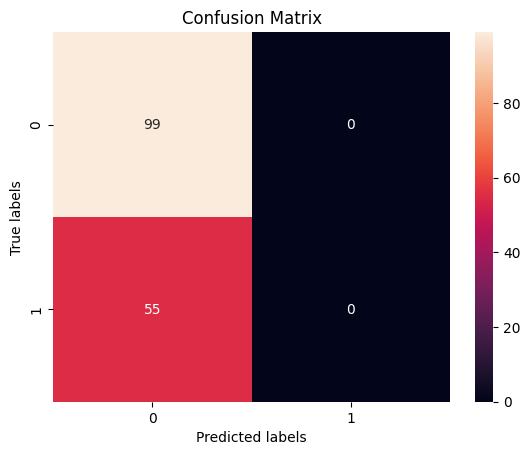

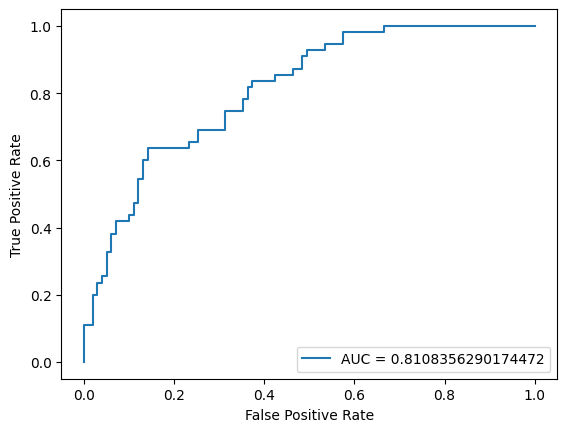

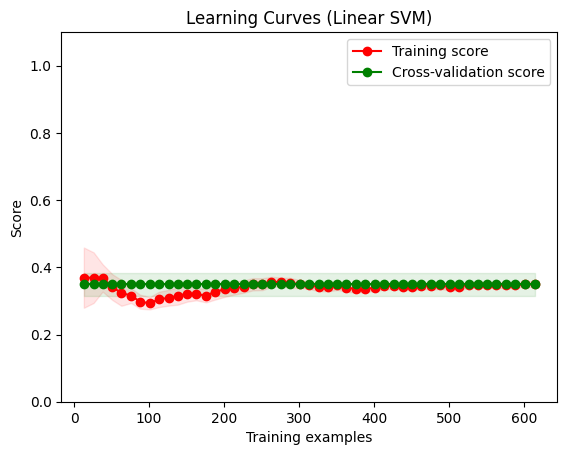

In [36]:
print("Risultati per Kernel Gaussiano Soft margin, gamma alto, dati NON stratificati")
gauss_svm(X_train, y_train, X_test, y_test, C=0.01, gamma=1)

Risultati per Kernel Gaussiano Hard margin, gamma alto, dati NON stratificati
Accuracy: 0.7272727272727273
              precision    recall  f1-score   support

           0       0.80      0.77      0.78        99
           1       0.61      0.65      0.63        55

    accuracy                           0.73       154
   macro avg       0.71      0.71      0.71       154
weighted avg       0.73      0.73      0.73       154



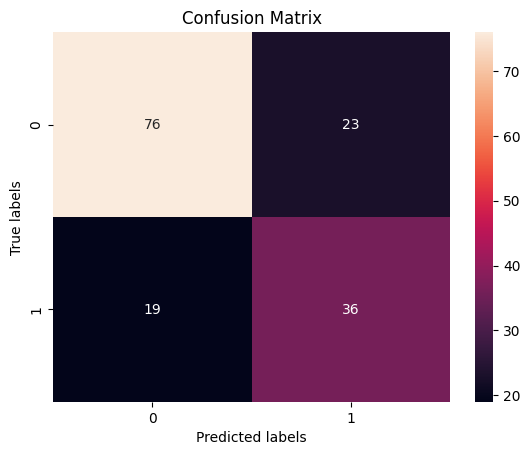

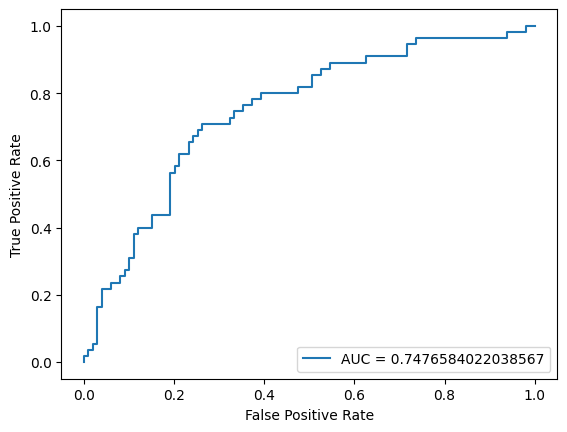

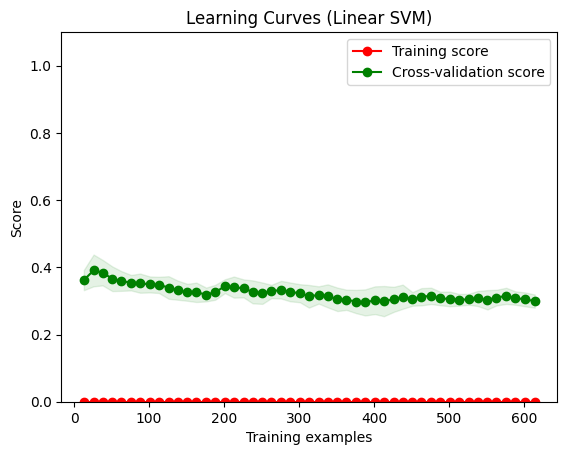

In [37]:
print("Risultati per Kernel Gaussiano Hard margin, gamma alto, dati NON stratificati")
gauss_svm(X_train, y_train, X_test, y_test, C=1000, gamma=1)

Osserviamo che per un Kernel Gaussiano i migliori risultati si ottengono per una SVM Soft margin, gamma basso, dati NON stratificati

#### Kernel Sigmoide

##### funzioni

In [407]:
def sigm_svm(X_train, y_train, X_test, y_test, C, gamma, stratified = False):
 sig_svm = SVC(kernel='sigmoid', C=C, gamma=gamma, probability=True)
 sig_svm.fit(X_train, y_train)
 y_pred = sig_svm.predict(X_test)
 y_test_pred_prob = sig_svm.predict_proba(X_test)[:, 1]

 accuracy = accuracy_score(y_test, y_pred)


 uc = roc_auc_score(y_test, y_test_pred_prob)
 print(f"Accuracy: {accuracy}")
 print(classification_report(y_test, y_pred))

 cf_matrix = metrics.confusion_matrix(y_test, y_pred, labels=[0, 1])
 ax = plt.subplot()
 sns.heatmap(cf_matrix, annot=True, ax=ax, fmt='g')
 ax.set_xlabel('Predicted labels')
 ax.set_ylabel('True labels')
 ax.set_title('Confusion Matrix')
 plt.show()
 y_test_pred_prob = sig_svm.predict_proba(X_test)[:, 1]
 fpr, tpr, _ = roc_curve(y_test, y_test_pred_prob)
 auc = roc_auc_score(y_test, y_test_pred_prob)
 plt.figure()
 plt.plot(fpr, tpr, label="AUC = " + str(auc))
 plt.xlabel('False Positive Rate')
 plt.ylabel('True Positive Rate')
 plt.legend(loc=4)
 plt.show()
 if (stratified == True):
  cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
 else:
  cv = KFold(n_splits=5, shuffle=True, random_state=42)
 train_sizes = np.linspace(1, 614, 50).astype(int)

 train_sizes, train_scores, test_scores = learning_curve(sig_svm, np.concatenate([X_train, X_test]), np.concatenate([y_train, y_test]), cv=cv, train_sizes=train_sizes, scoring='accuracy')

 train_scores_mean = 1-np.mean(train_scores, axis=1)
 train_scores_std = np.std(train_scores, axis=1)
 test_scores_mean = 1-np.mean(test_scores, axis=1)
 test_scores_std = np.std(test_scores, axis=1)

 plt.figure()
 plt.title('Learning Curves (Linear SVM)')
 plt.xlabel('Training examples')
 plt.ylabel('Score')
 plt.ylim(0.0, 1.1)

 plt.fill_between(train_sizes, train_scores_mean - train_scores_std, train_scores_mean + train_scores_std, alpha=0.1, color='r')
 plt.plot(train_sizes, train_scores_mean, 'o-', color='r', label='Training score')

 plt.fill_between(train_sizes, test_scores_mean - test_scores_std, test_scores_mean + test_scores_std, alpha=0.1, color='g')
 plt.plot(train_sizes, test_scores_mean, 'o-', color='g', label='Cross-validation score')

 plt.legend(loc='best')
 plt.show()


##### Modelli

###### Dati Stratificati

Risultati per Kernel Sigmoide Soft margin, gamma basso, dati stratificati
Accuracy: 0.7207792207792207
              precision    recall  f1-score   support

           0       0.75      0.85      0.80       100
           1       0.63      0.48      0.55        54

    accuracy                           0.72       154
   macro avg       0.69      0.67      0.67       154
weighted avg       0.71      0.72      0.71       154



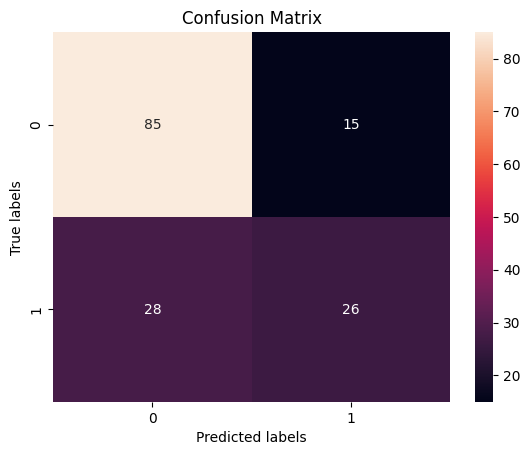

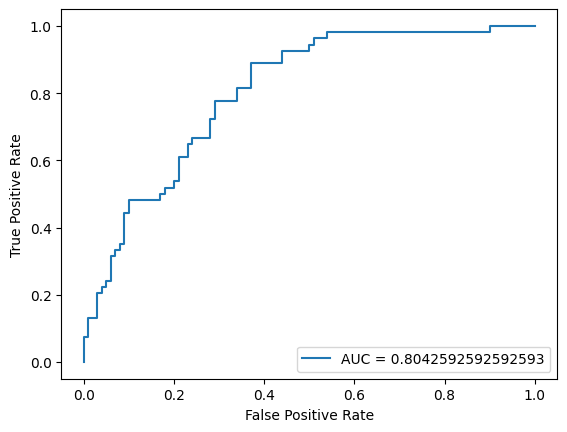

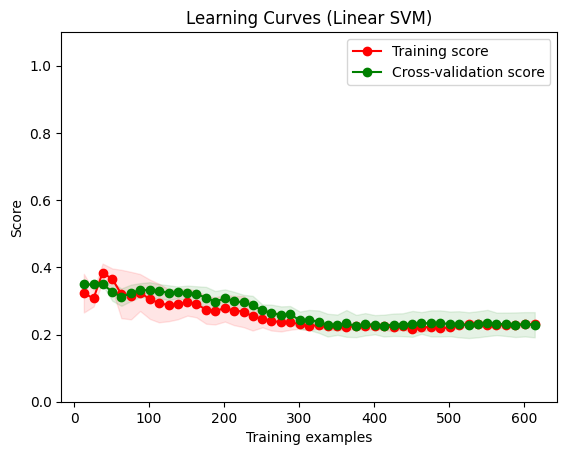

In [45]:
print("Risultati per Kernel Sigmoide Soft margin, gamma basso, dati stratificati")
sigm_svm(X_train_s, y_train_s, X_test_s, y_test_s, C=0.1, gamma=0.1, stratified =True)

Risultati per Kernel Sigmoide Hard margin, gamma basso, dati stratificati
Accuracy: 0.6753246753246753
              precision    recall  f1-score   support

           0       0.76      0.73      0.74       100
           1       0.53      0.57      0.55        54

    accuracy                           0.68       154
   macro avg       0.65      0.65      0.65       154
weighted avg       0.68      0.68      0.68       154



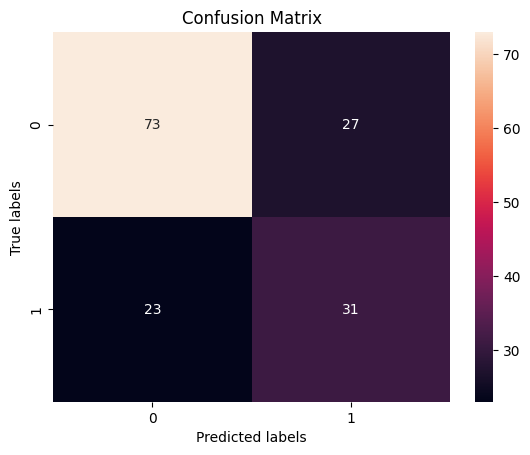

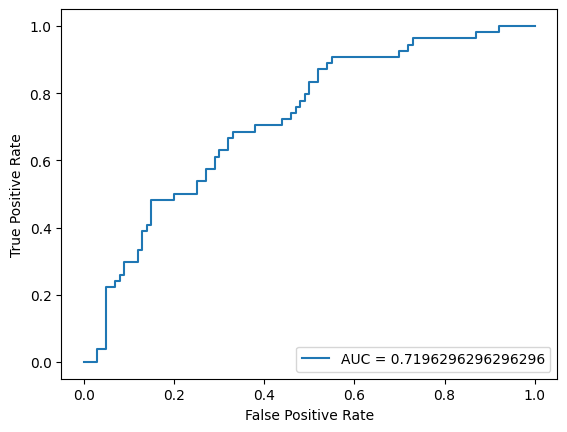

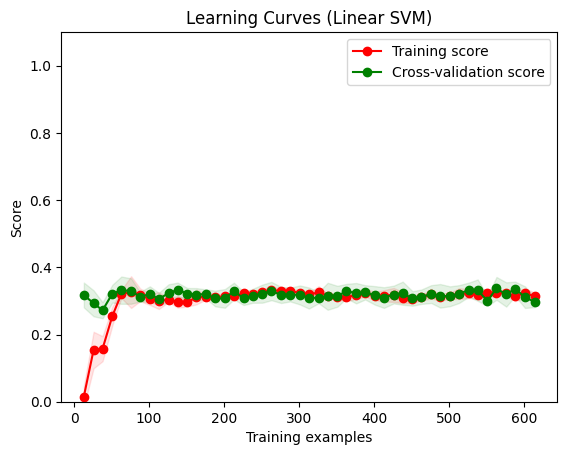

In [46]:
print("Risultati per Kernel Sigmoide Hard margin, gamma basso, dati stratificati")
sigm_svm(X_train_s, y_train_s, X_test_s, y_test_s, C=1000, gamma=0.1, stratified =True)

Risultati per Kernel Sigmoide Soft margin, gamma alto, dati stratificati
Accuracy: 0.7272727272727273
              precision    recall  f1-score   support

           0       0.72      0.96      0.82       100
           1       0.80      0.30      0.43        54

    accuracy                           0.73       154
   macro avg       0.76      0.63      0.63       154
weighted avg       0.75      0.73      0.68       154



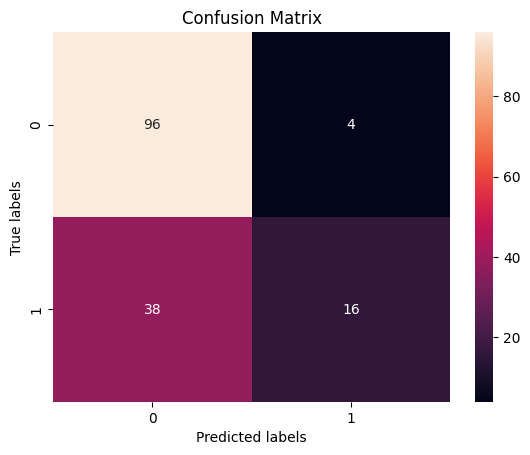

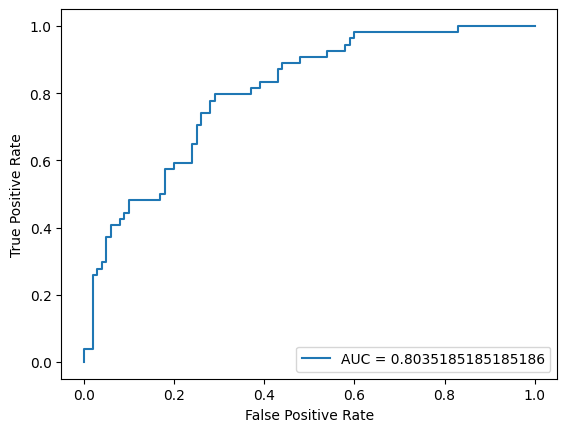

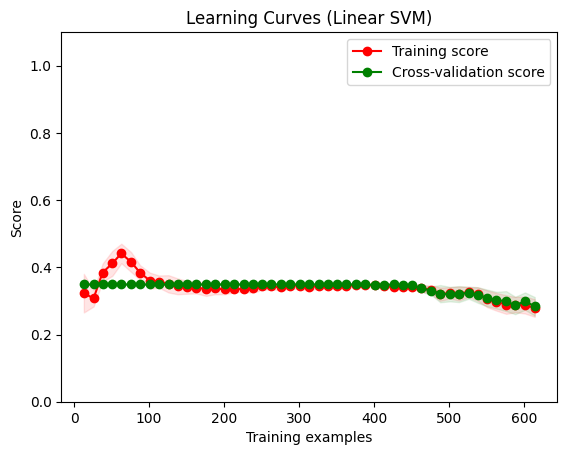

In [47]:
print("Risultati per Kernel Sigmoide Soft margin, gamma alto, dati stratificati")
sigm_svm(X_train_s, y_train_s, X_test_s, y_test_s, C=0.01, gamma=1, stratified =True)

Risultati per Kernel Sigmoide Hard margin, gamma alto, dati stratificati
Accuracy: 0.7337662337662337
              precision    recall  f1-score   support

           0       0.79      0.80      0.80       100
           1       0.62      0.61      0.62        54

    accuracy                           0.73       154
   macro avg       0.71      0.71      0.71       154
weighted avg       0.73      0.73      0.73       154



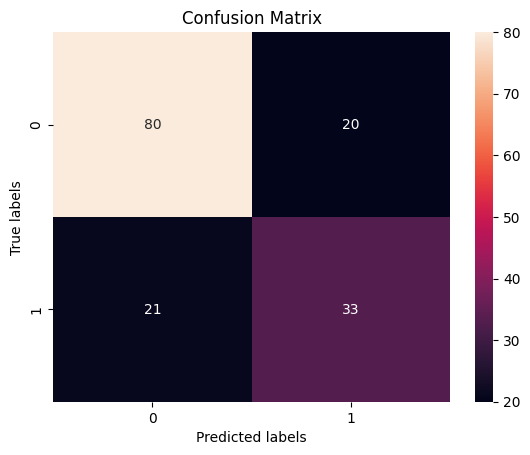

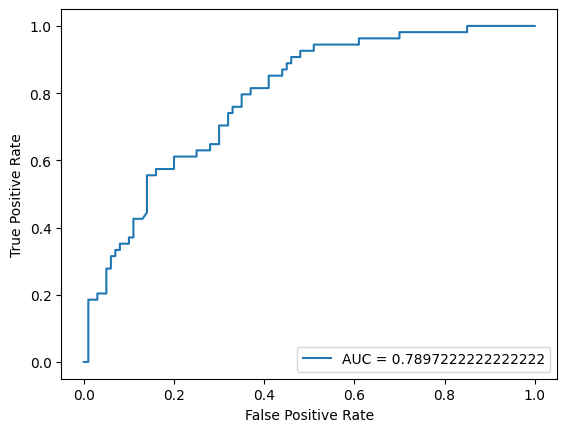

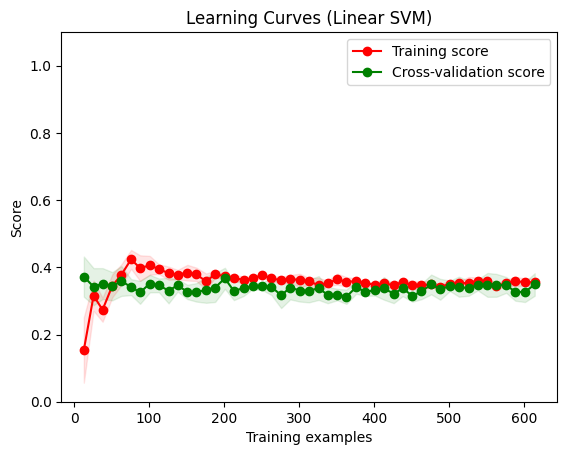

In [48]:
print("Risultati per Kernel Sigmoide Hard margin, gamma alto, dati stratificati")
sigm_svm(X_train_s, y_train_s, X_test_s, y_test_s, C=1000, gamma=1, stratified =True)

###### Dati NON Stratificati

Risultati per Kernel Sigmoide Soft margin, gamma basso, dati NON stratificati
Accuracy: 0.7727272727272727
              precision    recall  f1-score   support

           0       0.80      0.87      0.83        99
           1       0.72      0.60      0.65        55

    accuracy                           0.77       154
   macro avg       0.76      0.73      0.74       154
weighted avg       0.77      0.77      0.77       154



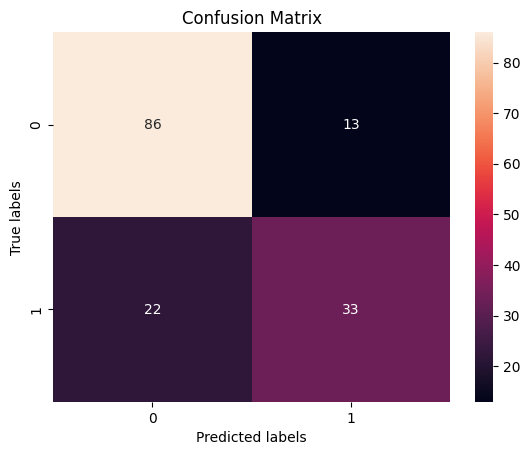

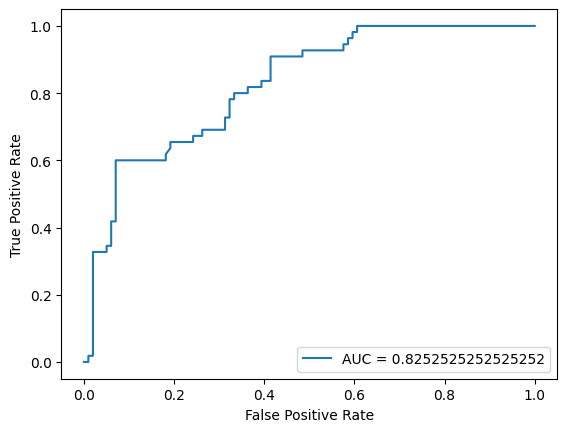

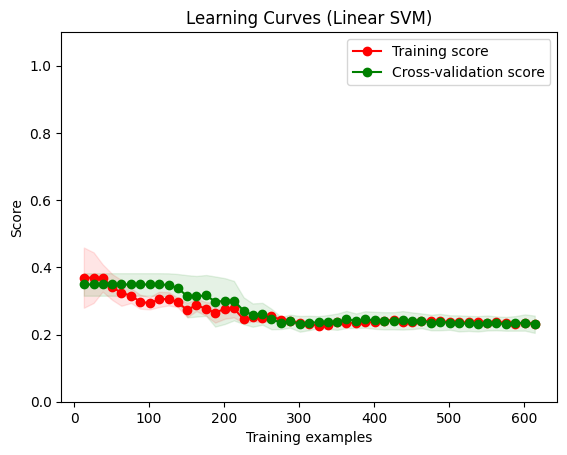

In [408]:
print("Risultati per Kernel Sigmoide Soft margin, gamma basso, dati NON stratificati")
sigm_svm(X_train, y_train, X_test, y_test, C=0.1, gamma=0.1)

Risultati per Kernel Sigmoide Hard margin, gamma basso, dati NON stratificati
Accuracy: 0.6688311688311688
              precision    recall  f1-score   support

           0       0.75      0.73      0.74        99
           1       0.53      0.56      0.55        55

    accuracy                           0.67       154
   macro avg       0.64      0.65      0.64       154
weighted avg       0.67      0.67      0.67       154



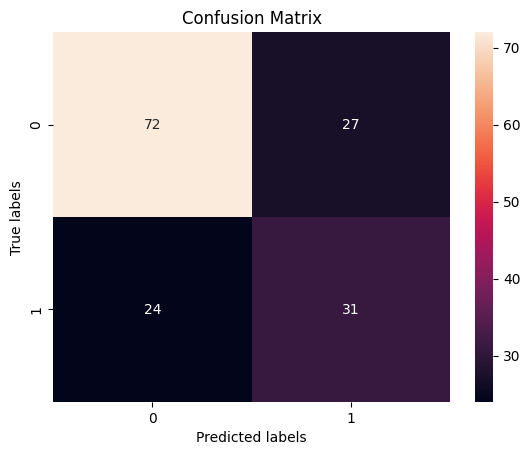

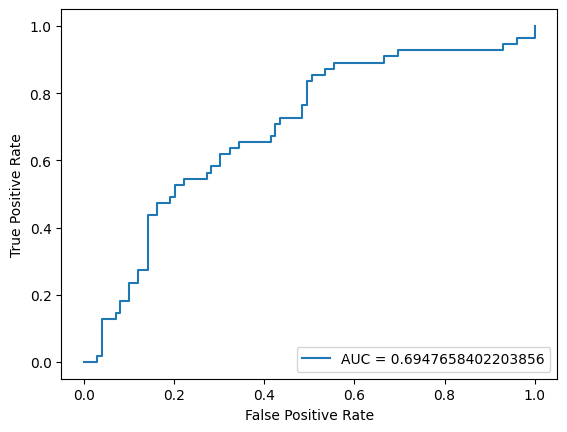

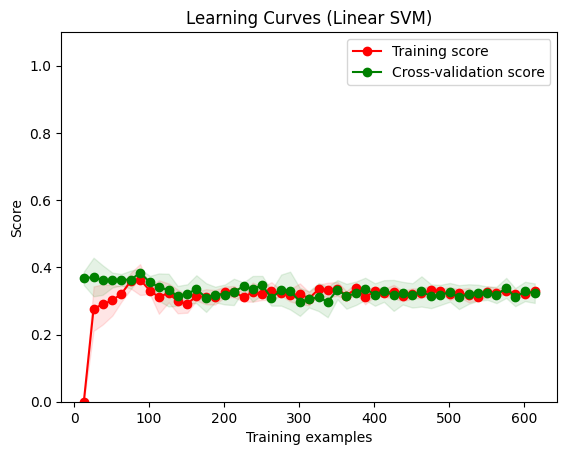

In [50]:
print("Risultati per Kernel Sigmoide Hard margin, gamma basso, dati NON stratificati")
sigm_svm(X_train, y_train, X_test, y_test, C=1000, gamma=0.1)

Risultati per Kernel Sigmoide Soft margin, gamma alto, dati NON stratificati
Accuracy: 0.7077922077922078
              precision    recall  f1-score   support

           0       0.70      0.94      0.81        99
           1       0.73      0.29      0.42        55

    accuracy                           0.71       154
   macro avg       0.72      0.62      0.61       154
weighted avg       0.71      0.71      0.67       154



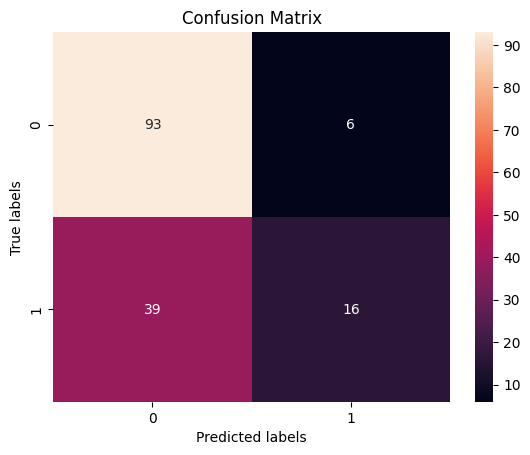

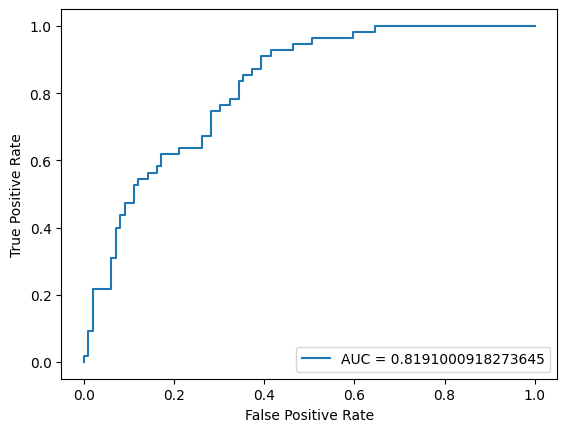

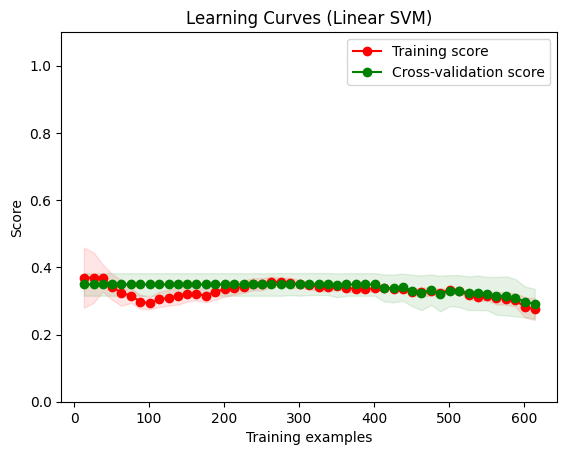

In [51]:
print("Risultati per Kernel Sigmoide Soft margin, gamma alto, dati NON stratificati")
sigm_svm(X_train, y_train, X_test, y_test, C=0.01, gamma=1)

Risultati per Kernel Sigmoide Hard margin, gamma alto, dati stratificati
Accuracy: 0.6103896103896104
              precision    recall  f1-score   support

           0       0.70      0.70      0.70        99
           1       0.45      0.45      0.45        55

    accuracy                           0.61       154
   macro avg       0.58      0.58      0.58       154
weighted avg       0.61      0.61      0.61       154



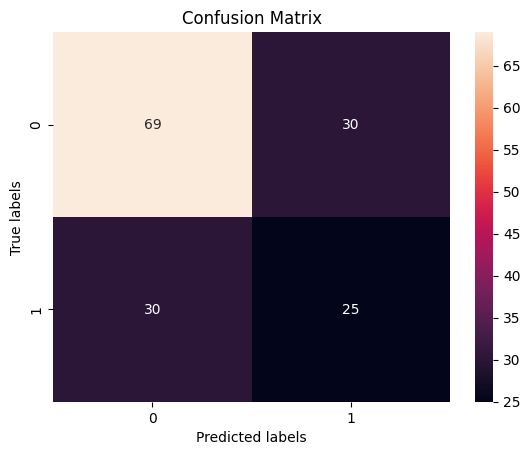

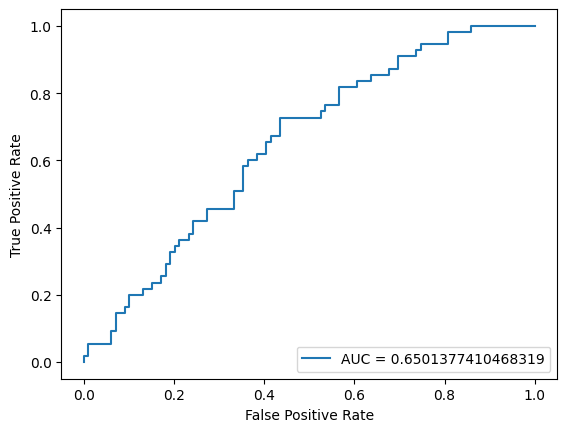

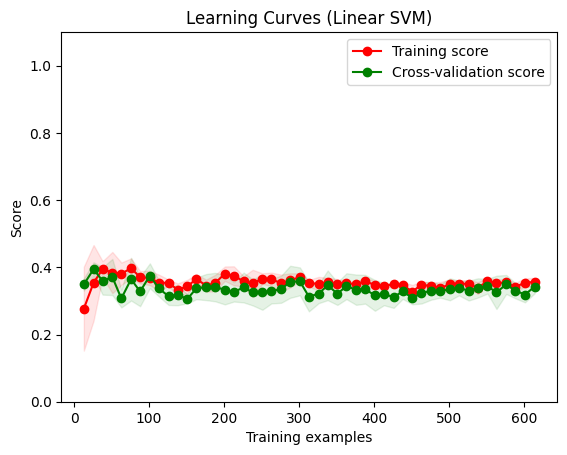

In [52]:
print("Risultati per Kernel Sigmoide Hard margin, gamma alto, dati stratificati")
sigm_svm(X_train, y_train, X_test, y_test, C=1000, gamma=1)

Osserviamo che per un Kernel Sigmoide i migliori risultati si hanno per una SVM Soft margin, gamma basso con dati NON stratificati

#### SVM - Valutazioni


Kernel Lineare SVM Soft Margin, dati NON stratificati

|           | precision | recall | f1-score | support |
|-----------|-----------|--------|----------|---------|
| 0         | 0.80      | 0.83   | 0.81     | 99      |
| 1         | 0.67      | 0.62   | 0.64     | 55      |
| **accuracy**   |           |        | 0.75     | 154     |
| **macro avg**  | 0.73      | 0.72   | 0.73     | 154     |
| **weighted avg** | 0.75   | 0.75   | 0.75     | 154     |

**AUC = 0.823**

Kernel Lineare SVM Hard Margin, dati NON stratificati

|           | precision | recall | f1-score | support |
|-----------|-----------|--------|----------|---------|
| 0         | 0.79      | 0.81   | 0.80     | 99      |
| 1         | 0.64      | 0.62   | 0.63     | 55      |
| **accuracy**   |           |        | 0.74     | 154     |
| **macro avg**  | 0.72      | 0.71   | 0.71     | 154     |
| **weighted avg** | 0.74   | 0.74   | 0.74     | 154     |

**AUC = 0.826**

Kernel Sigmoide Hard Margin, gamma alto, dati stratificati

|           | precision | recall | f1-score | support |
|-----------|-----------|--------|----------|---------|
| 0         | 0.79      | 0.80   | 0.80     | 100     |
| 1         | 0.62      | 0.61   | 0.62     | 54      |
| **accuracy**   |           |        | 0.73     | 154     |
| **macro avg**  | 0.71      | 0.71   | 0.71     | 154     |
| **weighted avg** | 0.73   | 0.73   | 0.73     | 154     |

**AUC = 0.79**

Kernel Sigmoide Soft Margin, gamma basso, dati NON stratificati

|           | precision | recall | f1-score | support |
|-----------|-----------|--------|----------|---------|
| 0         | 0.80      | 0.87   | 0.83     | 99      |
| 1         | 0.72      | 0.60   | 0.65     | 55      |
| **accuracy**   |           |        | 0.77     | 154     |
| **macro avg**  | 0.76      | 0.73   | 0.74     | 154     |
| **weighted avg** | 0.77   | 0.77   | 0.77     | 154     |

**AUC = 0.825**


Possiamo quindi osservare come il migliore tra questi modelli considerando tutti i parametri sembra essere la SVM Soft Margin con Kernel Sigmoide, un gamma basso e sfruttando un dataset non stratificato di cui osserviamo anche la learning curve

Accuracy: 0.7727272727272727
              precision    recall  f1-score   support

           0       0.80      0.87      0.83        99
           1       0.72      0.60      0.65        55

    accuracy                           0.77       154
   macro avg       0.76      0.73      0.74       154
weighted avg       0.77      0.77      0.77       154



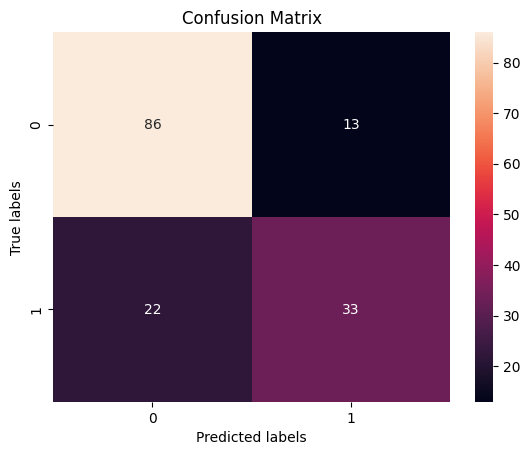

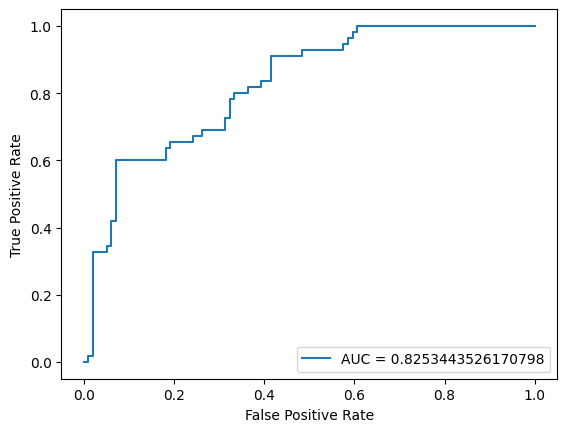

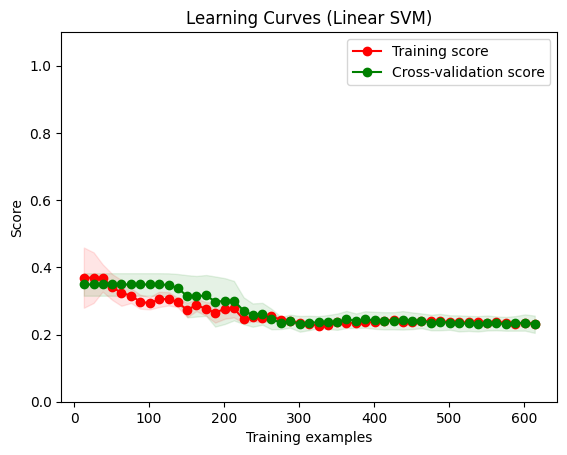

In [54]:
sigm_svm(X_train, y_train, X_test, y_test, C=0.1, gamma=0.1)

La Learning curve ci dive che tutto sommato il modello all'aumentare degli esempi di training tende al miglioramento sui sul training e si comporta in maniera simile sul test arrivando a convergenza indicando un good fitting del nostro modello

### Modello di predizione - Valutazioni Finali

Considerando i risultati ottenuti per la miglior SVM e il miglior Decision Tree:

| Metric             | SVM (Kernel Lineare Soft Margin) | Decision Tree (Entropy, max_depth=4, min_samples_leaf=10) |
|--------------------|-----------------------------------|----------------------------------------------------------|
| **Classe 0**        |                                   |                                                          |
| Precision          | 0.80                              | 0.89                                                     |
| Recall             | 0.83                              | 0.79                                                     |
| F1-Score           | 0.81                              | 0.84                                                     |
| **Classe 1**        |                                   |                                                          |
| Precision          | 0.67                              | 0.68                                                     |
| Recall             | 0.62                              | 0.81                                                     |
| F1-Score           | 0.64                              | 0.74                                                     |
| **Generali**|                                   |                                                          |
| Accuracy           | 0.75                              | 0.80                                                     |
| Macro Avg Precision| 0.73                              | 0.78                                                     |
| Macro Avg Recall   | 0.72                              | 0.80                                                     |
| Macro Avg F1-Score | 0.73                              | 0.79                                                     |
| Weighted Avg Precision | 0.75                          | 0.81                                                     |
| Weighted Avg Recall| 0.75                              | 0.80                                                     |
| Weighted Avg F1-Score | 0.75                          | 0.80                                                     |
| **AUC**            | 0.823                             | 0.81                                                     |

Risulta dunque nettamente migliore il decision tree non solo in termini di metriche ma anche in temini di interpretabilità perchè possiamo guardare la struttura dell'albero per capire precisamente in che modo si dividono i dati in base alle diverse feature al fine della separazione di classi, inoltre abbiamo anche un'ottima recall sulla classe malato il che ci piace essendo il diabete una malattia cronica degenerativa, inoltre non stiamo perdendo in precisione andando a favorire la recall perchè questa è quasi uguale nei due modelli

## Step 3: Clustering

In questo step vederemo il clustering applicato ai nostri dati, mediante questa tecnica di addestramento automatico non supervisionata ci poniamo l'obbiettivo di dividere i nostri dati in diverse partizioni, avendo però noi un dataset etichettato a monte andiamo a sfruttare l'etichettatura per capire se possiamo utilizzare i nostri cluster per effettuare delle predizioni 

### K-Means 

Il primo metodo che utilizziamo è il K-Means che prevede la formazione di K partizioni dei nostri dati e andremo poi a vedere nei nostri cluster se c'è coerenza nei dati 

#### K-Means - StandardScaler 

In [67]:
from sklearn.preprocessing import StandardScaler, Normalizer

X_n = df_adj.drop(columns=["Outcome"])
y = df_adj["Outcome"]
 
X = StandardScaler().fit_transform(X_n)

c:\Users\rocco\AppData\Local\Programs\Python\Python39\lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


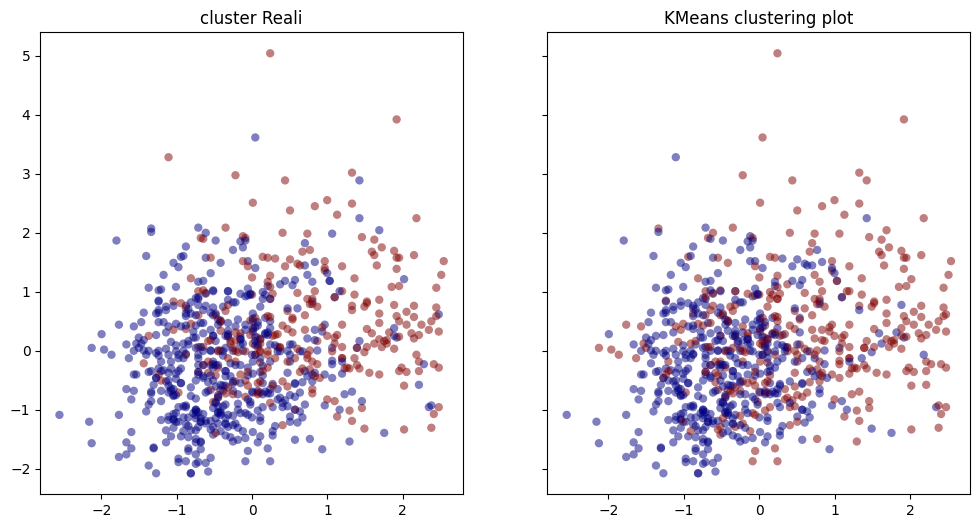

In [70]:
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

km = KMeans(n_clusters=2)
km_pred = km.fit_predict(X)
labels = km.labels_


glucose_index = X_n.columns.get_loc("Glucose")
bmi_index = X_n.columns.get_loc("BMI")

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6), sharey=True)

ax1.scatter(X[:, glucose_index], X[:, bmi_index], c=y, cmap="jet", edgecolors='none', alpha=0.5)
ax1.set_title("cluster Reali")

ax2.scatter(X[:, glucose_index], X[:, bmi_index], c=km_pred, cmap="jet", edgecolors='none', alpha=0.5)
ax2.set_title("KMeans clustering plot")

plt.show()



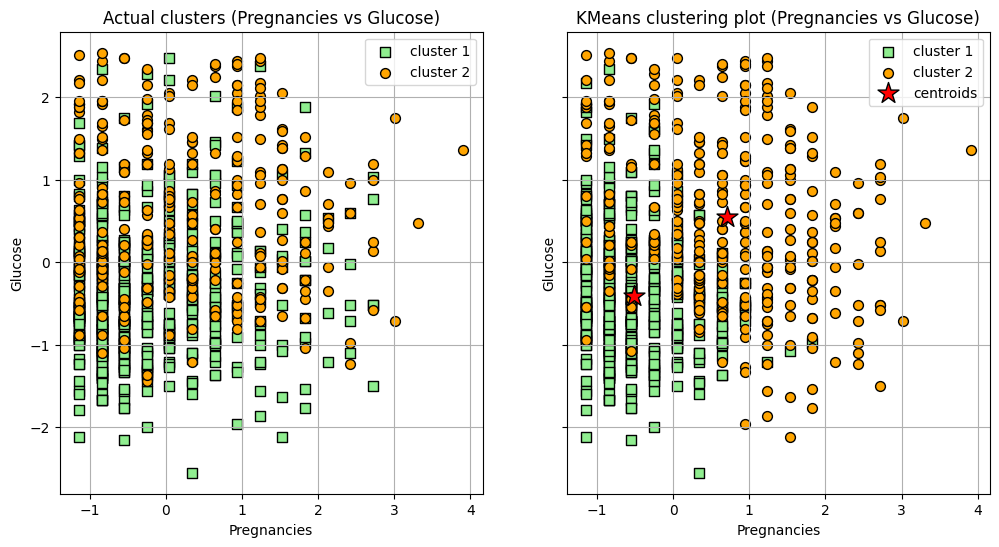

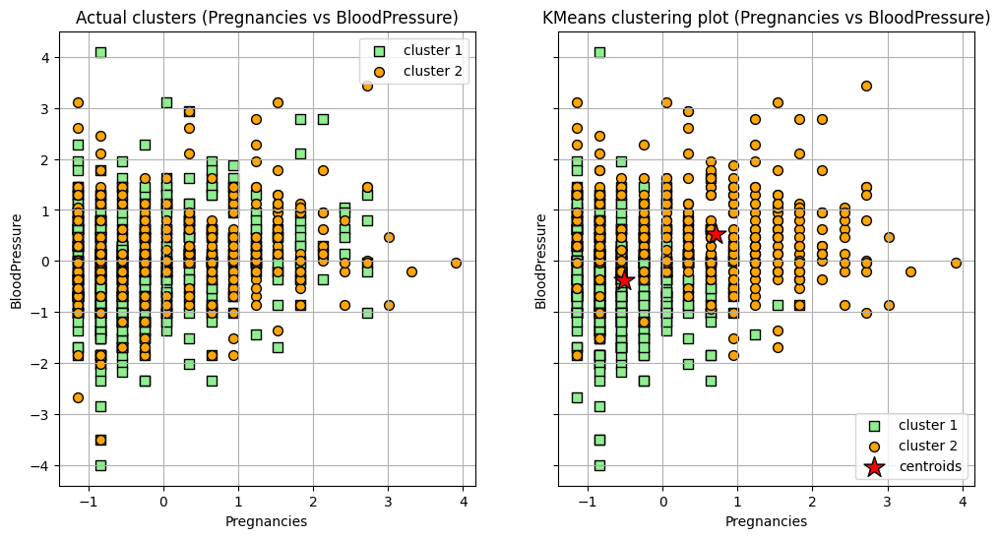

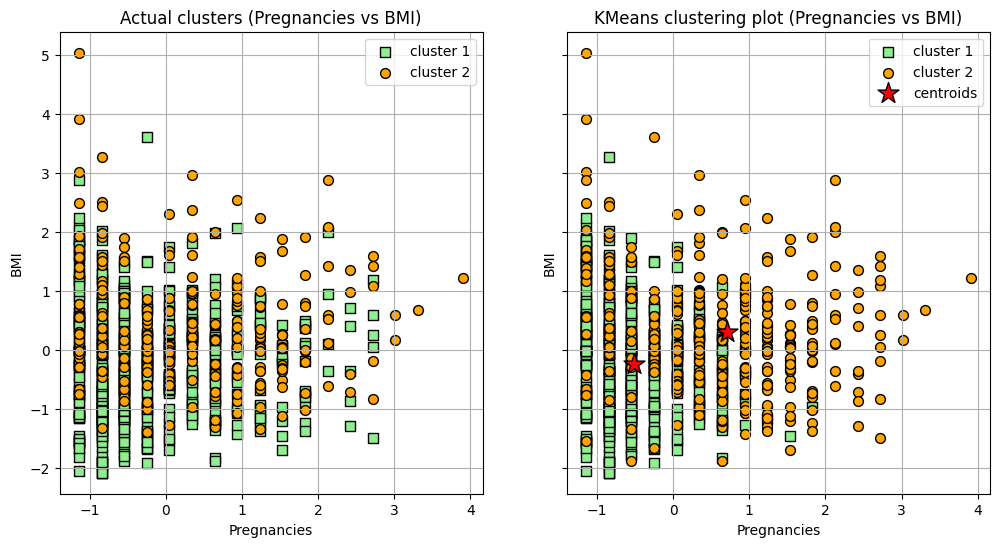

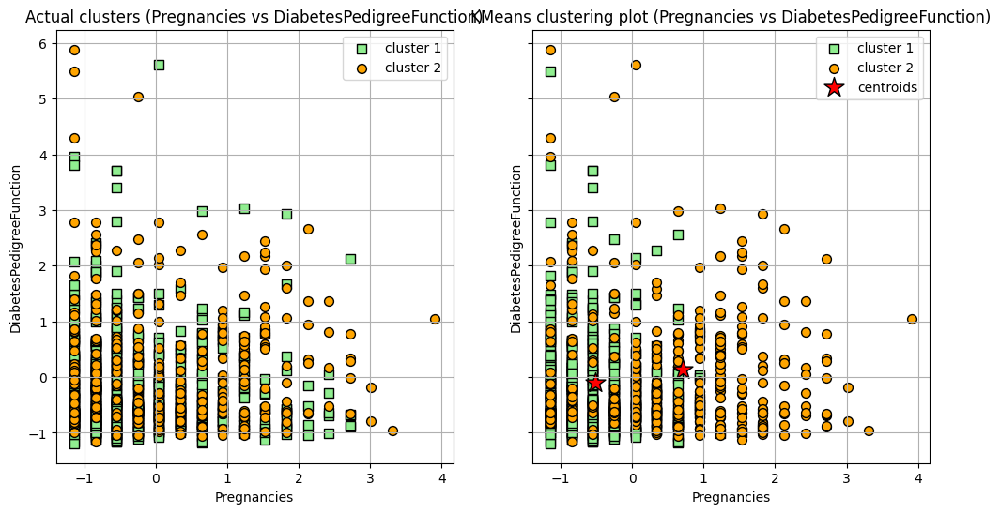

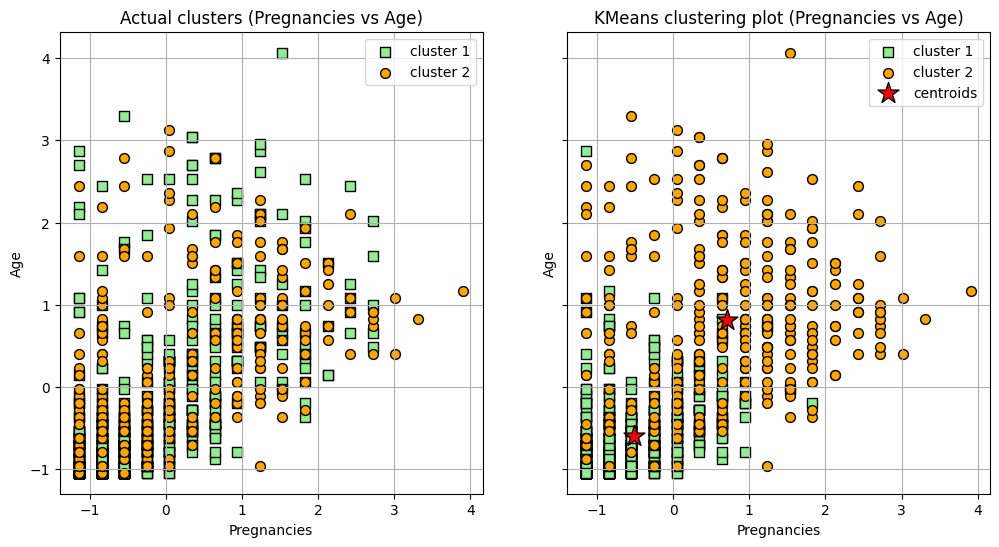

...

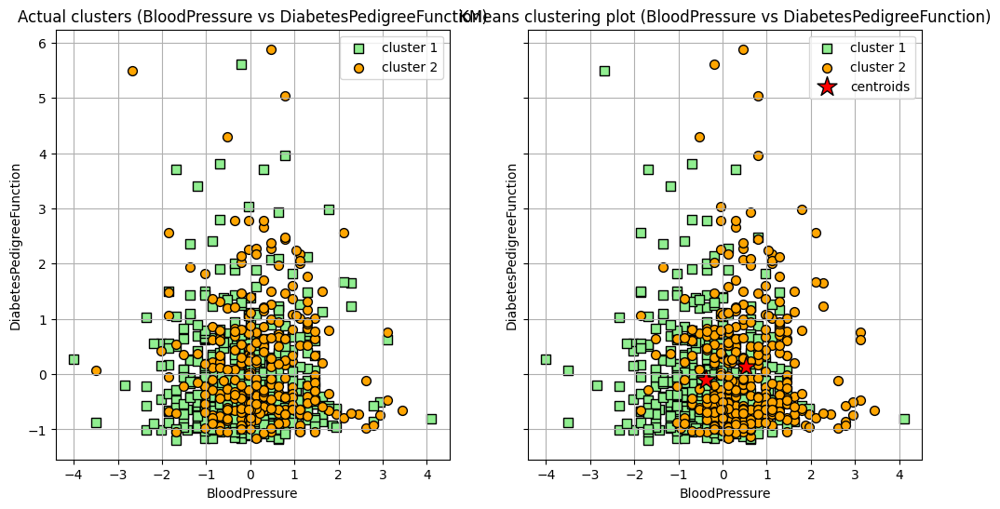

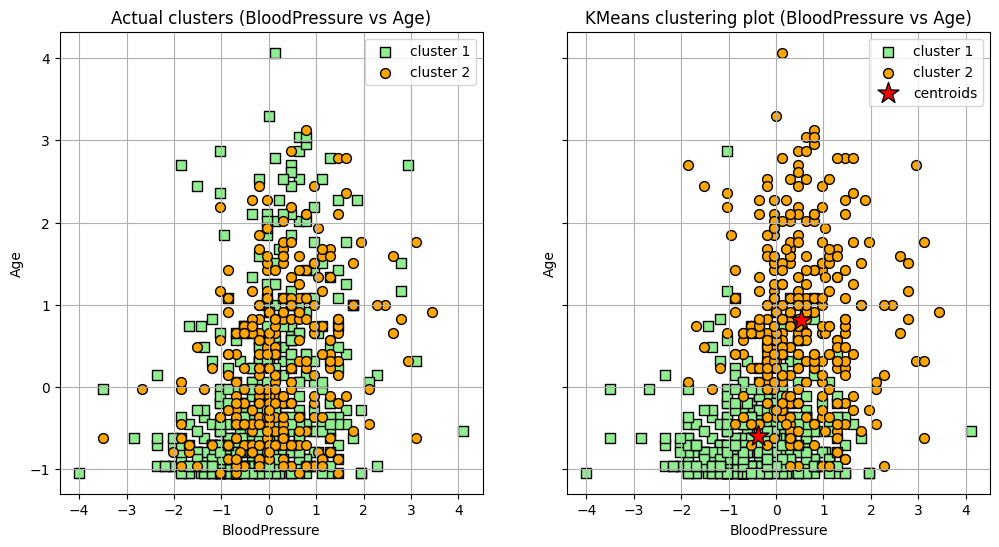

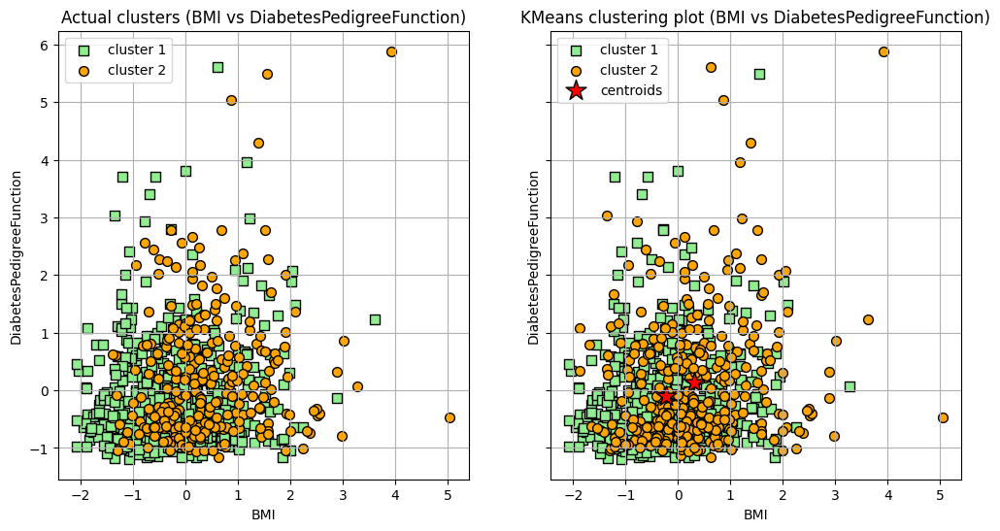

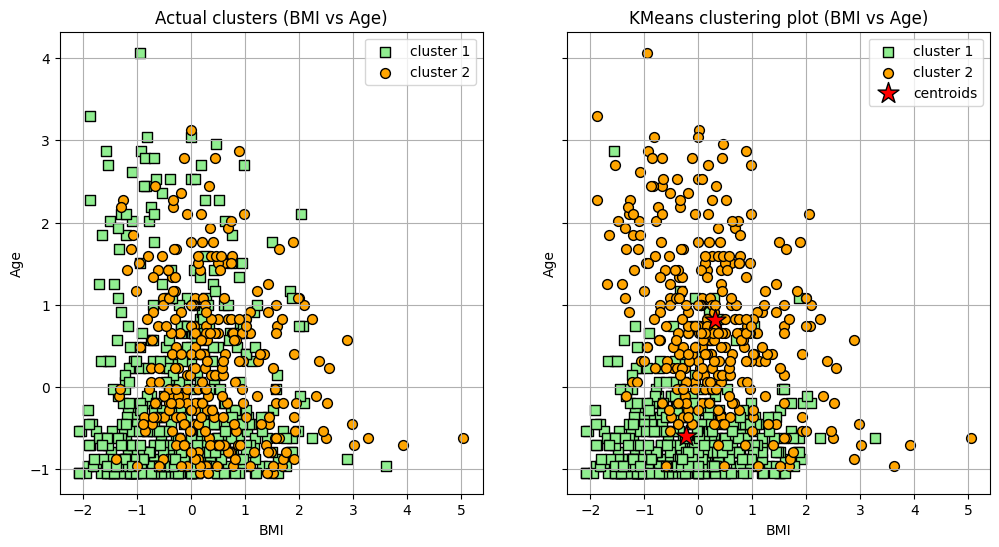

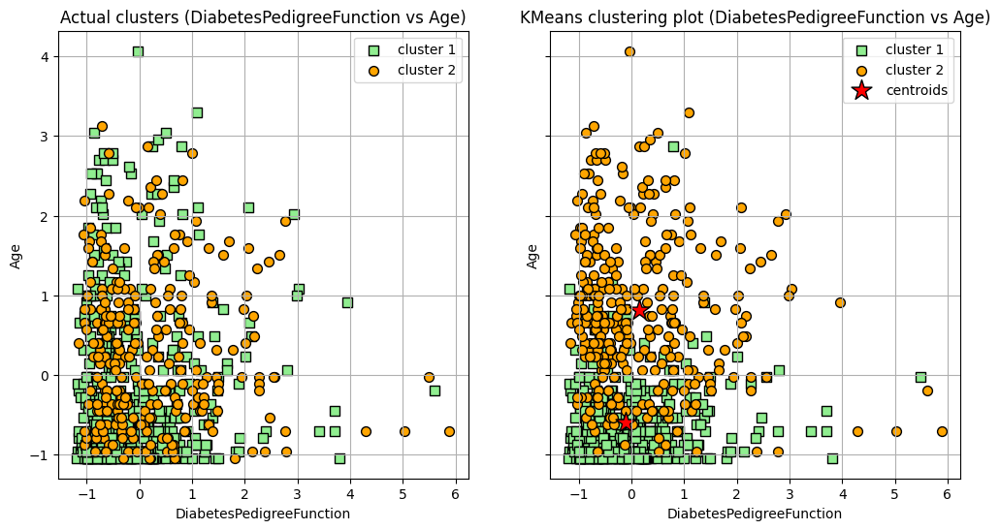

In [71]:
columns = X_n.columns

for i in range(len(columns)):
    for j in range(i + 1, len(columns)):
        col_i = columns[i]
        col_j = columns[j]
        

        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6), sharey=True)


        for label, color, marker in zip([0, 1], ['lightgreen', 'orange'], ['s', 'o']):
            ax1.scatter(X[y == label, i], X[y == label, j],
                        s=50, c=color, marker=marker, edgecolor="black", label=f'cluster {label + 1}')
        ax1.set_title(f"Actual clusters ({col_i} vs {col_j})")
        ax1.set_xlabel(col_i)
        ax1.set_ylabel(col_j)
        ax1.legend(scatterpoints=1)
        ax1.grid()


        ax2.scatter(X[km_pred == 0, i], X[km_pred == 0, j],
                    s=50, c='lightgreen', marker='s', edgecolor="black", label='cluster 1')
        ax2.scatter(X[km_pred == 1, i], X[km_pred == 1, j],
                    s=50, c='orange', marker='o', edgecolor='black', label='cluster 2')


        ax2.scatter(km.cluster_centers_[:, i], km.cluster_centers_[:, j],
                    s=250, marker='*', c='red', edgecolor="black", label='centroids')

        ax2.set_title(f"KMeans clustering plot ({col_i} vs {col_j})")
        ax2.set_xlabel(col_i)
        ax2.set_ylabel(col_j)
        ax2.legend(scatterpoints=1)
        ax2.grid()

        plt.show()

Risultati finali per Kmeans - StandardScaler con k=2
Silhouette score: 0.23434336526624464
Rand_score: 0.5884533898305084
Classification Report:
              precision    recall  f1-score   support

           0       0.81      0.72      0.76       500
           1       0.57      0.69      0.62       268

    accuracy                           0.71       768
   macro avg       0.69      0.71      0.69       768
weighted avg       0.73      0.71      0.72       768



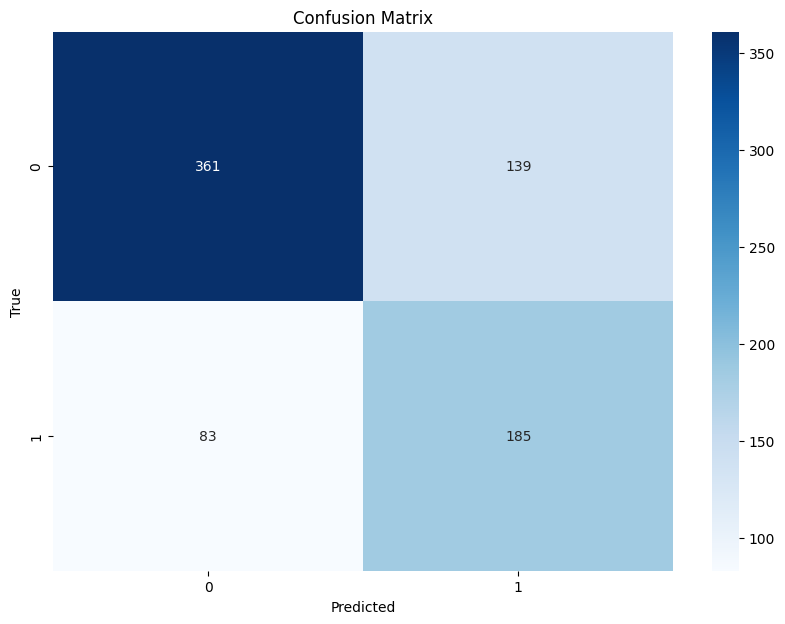

In [72]:
print("Risultati finali per Kmeans - StandardScaler con k=2")
from sklearn.metrics import silhouette_score, rand_score
ss=silhouette_score(X, km_pred, metric="euclidean" )
print("Silhouette score:",ss)

ris=rand_score(y,km_pred)
print("Rand_score:",ris)
report = classification_report(y, km_pred, target_names=[str(i) for i in np.unique(y)])
print("Classification Report:")
print(report)

conf_matrix = confusion_matrix(y, km_pred)
plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=np.unique(y), yticklabels=np.unique(y))
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

c:\Users\rocco\AppData\Local\Programs\Python\Python39\lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Users\rocco\AppData\Local\Programs\Python\Python39\lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Users\rocco\AppData\Local\Programs\Python\Python39\lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Users\rocco\AppData\Local\Programs\Python\Python39\lib\site-packages\sklearn\cluster\

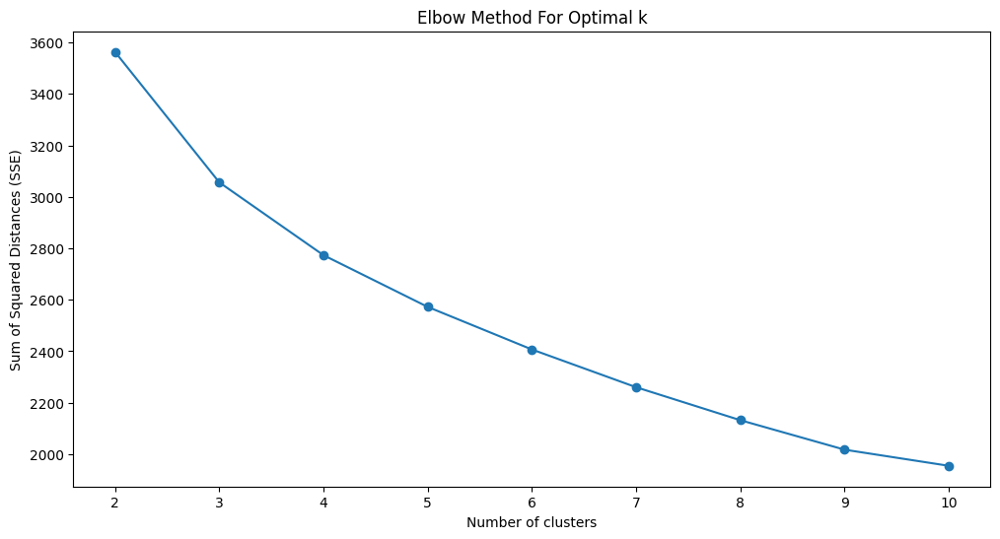

In [73]:
range_n_clusters = range(2, 11)

sse = []
silhouette_scores = []
rand_scores = []

for n_clusters in range_n_clusters:
    km = KMeans(n_clusters=n_clusters, random_state=42)
    km_pred = km.fit_predict(X)
    
    sse.append(km.inertia_)
    silhouette_scores.append(silhouette_score(X, km_pred, metric="euclidean"))
    rand_scores.append(rand_score(y, km_pred))

plt.figure(figsize=(12, 6))
plt.plot(range_n_clusters, sse, marker='o')
plt.title('Elbow Method For Optimal k')
plt.xlabel('Number of clusters')
plt.ylabel('Sum of Squared Distances (SSE)')
plt.show()


c:\Users\rocco\AppData\Local\Programs\Python\Python39\lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


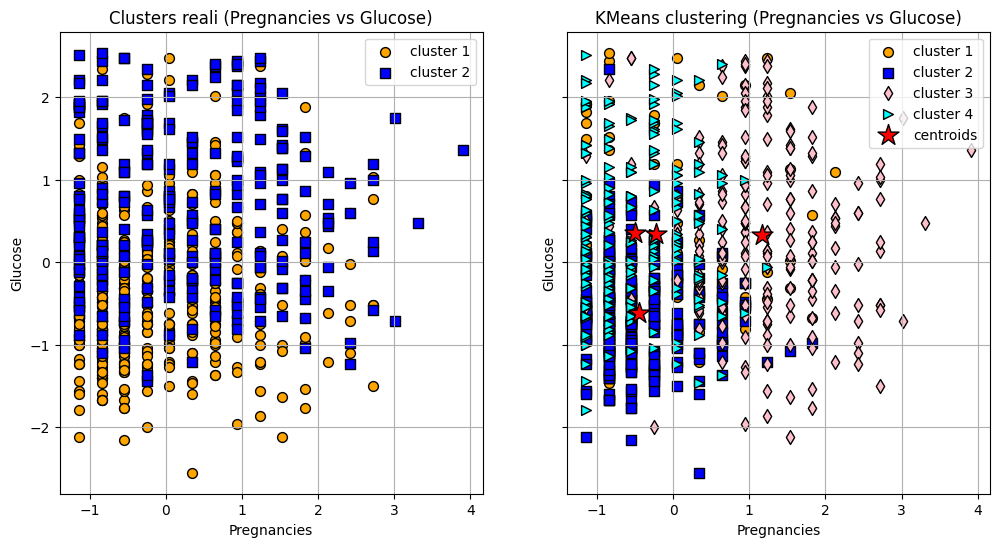

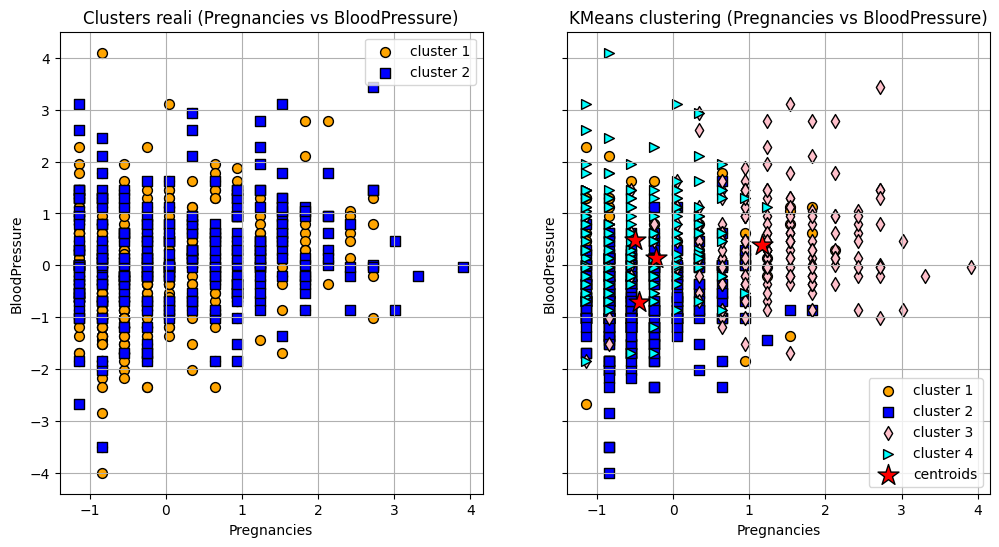

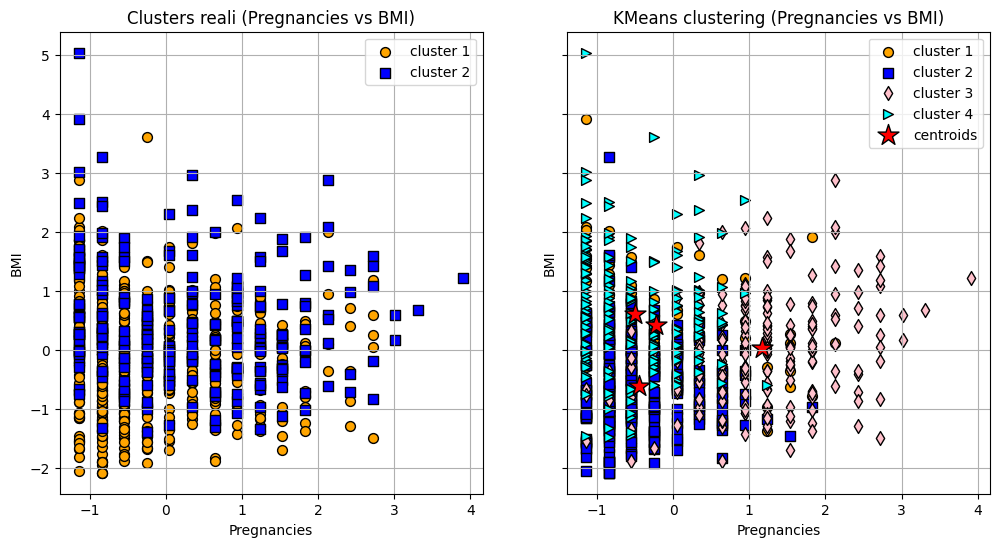

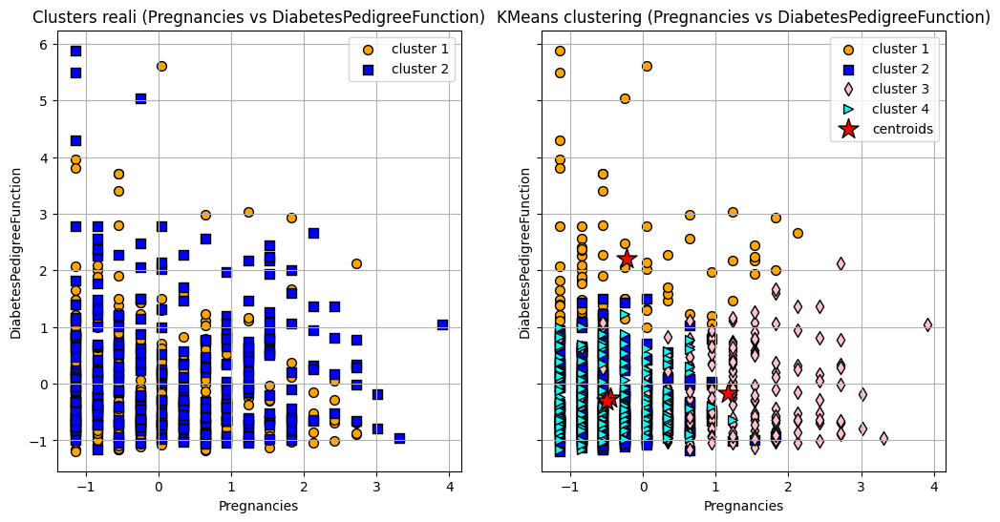

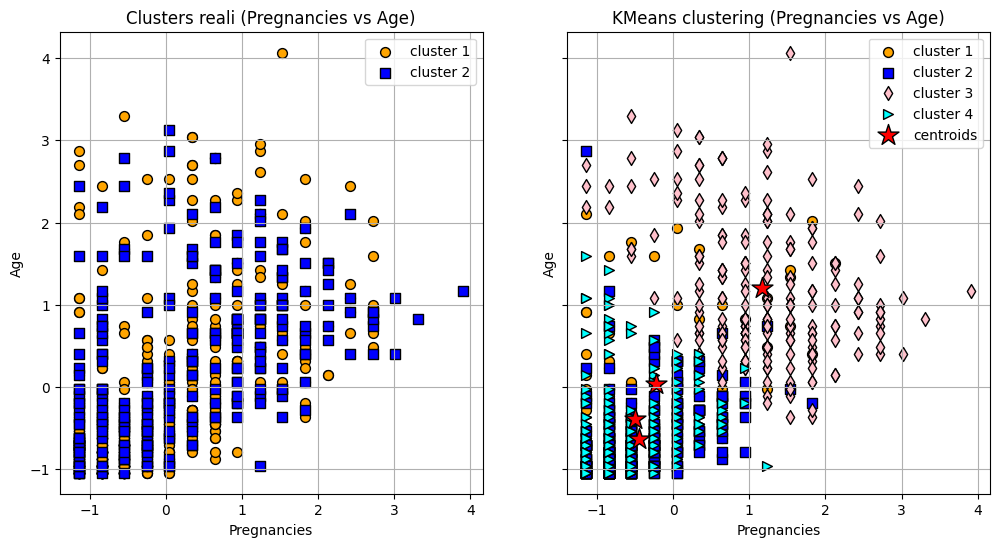

...

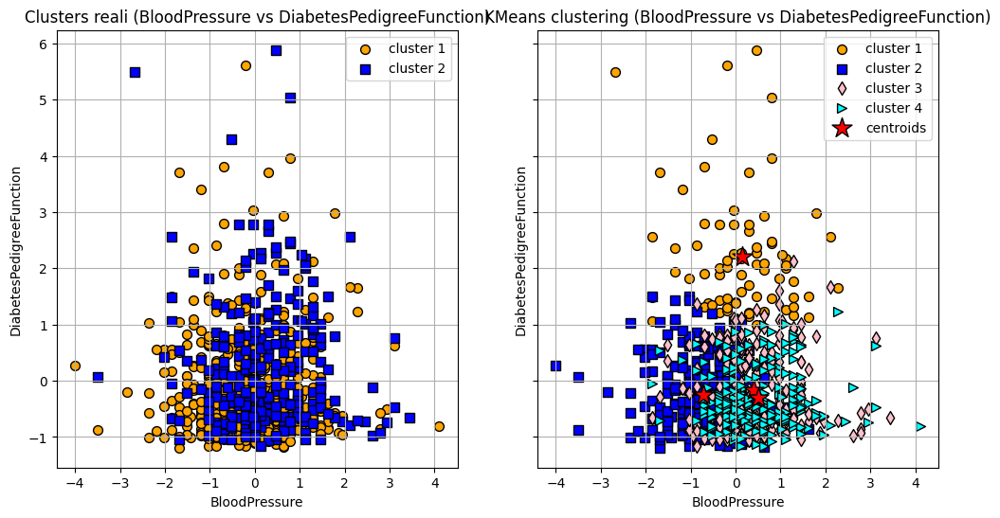

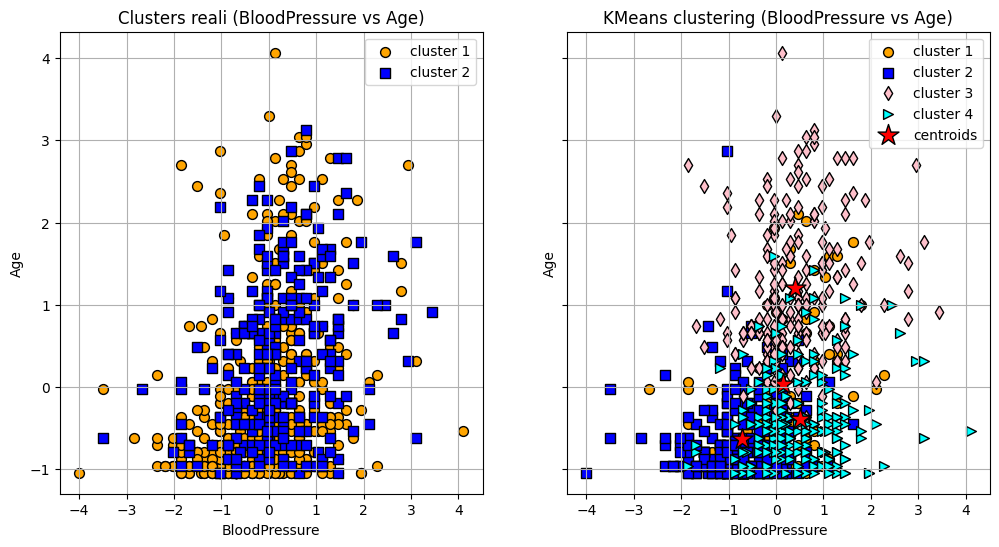

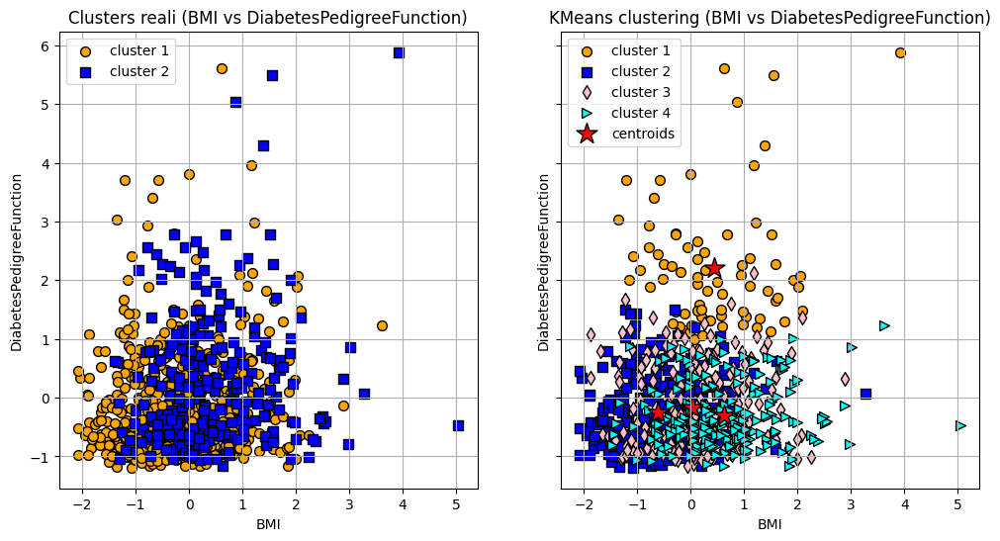

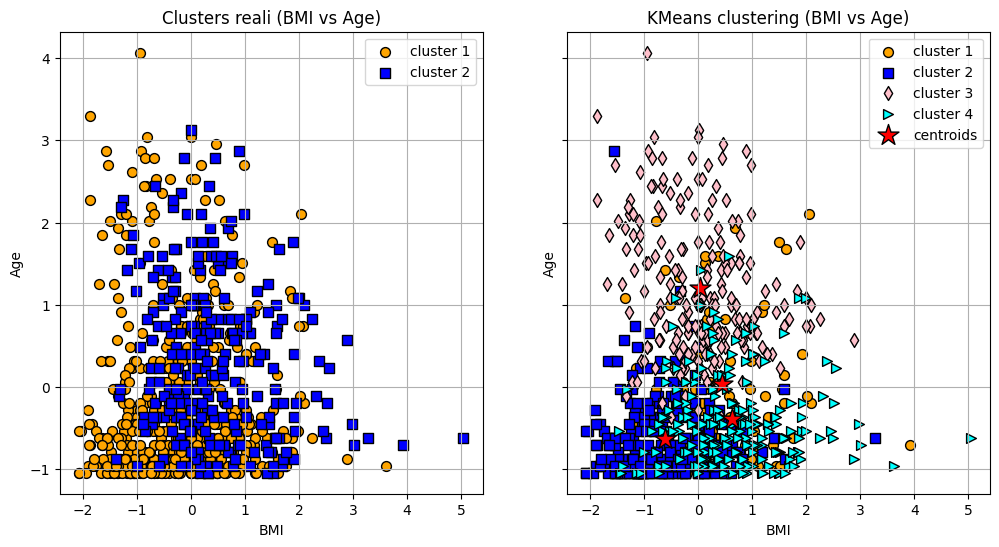

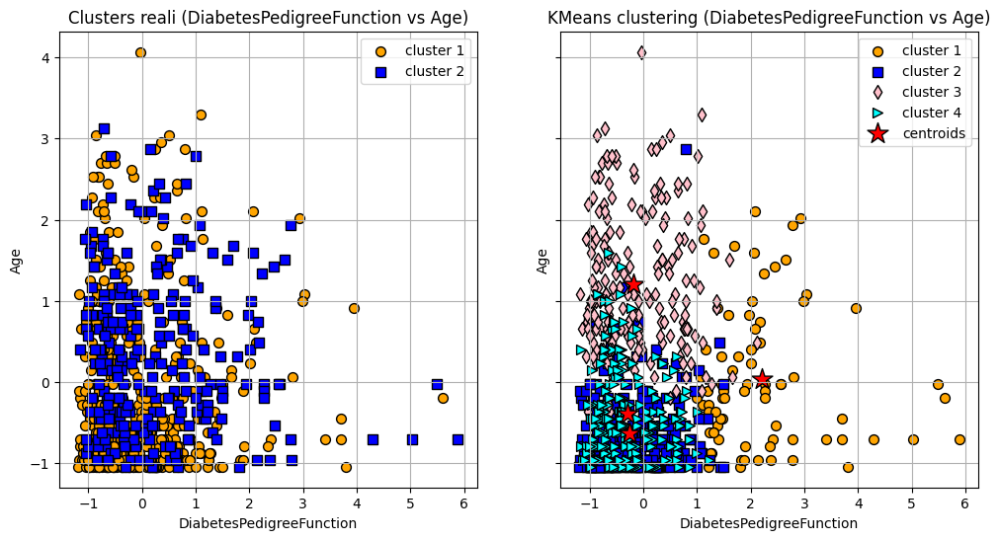

In [74]:
n_clusters = 4

km = KMeans(n_clusters=n_clusters, random_state=42)
km_pred = km.fit_predict(X)
labels = km.labels_
colors = [ 'orange', 'blue', 'pink', 'cyan']
markers = [ 'o', 's','d', '>']
columns = X_n.columns

for i in range(len(columns)):
    for j in range(i + 1, len(columns)):
        col_i = columns[i]
        col_j = columns[j]
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6), sharey=True)

        for label in np.unique(y):
            ax1.scatter(X[y == label, i], X[y == label, j],
                        s=50, c=colors[label % len(colors)], marker=markers[label % len(markers)],
                        edgecolor="black", label=f'cluster {label + 1}')
        ax1.set_title(f"Clusters reali ({col_i} vs {col_j})")
        ax1.set_xlabel(col_i)
        ax1.set_ylabel(col_j)
        ax1.legend(scatterpoints=1)
        ax1.grid()

        for cluster in range(n_clusters):
            ax2.scatter(X[km_pred == cluster, i], X[km_pred == cluster, j],
                        s=50, c=colors[cluster % len(colors)], marker=markers[cluster % len(markers)],
                        edgecolor="black", label=f'cluster {cluster + 1}')


        ax2.scatter(km.cluster_centers_[:, i], km.cluster_centers_[:, j],
                    s=250, marker='*', c='red', edgecolor="black", label='centroids')

        ax2.set_title(f"KMeans clustering ({col_i} vs {col_j})")
        ax2.set_xlabel(col_i)
        ax2.set_ylabel(col_j)
        ax2.legend(scatterpoints=1)
        ax2.grid()

        plt.show()

In [75]:
from sklearn.metrics import silhouette_score, rand_score
print("Risultati Intermedi per Kmeans - StandardScaler con k=4")
ss=silhouette_score(X, km_pred, metric="euclidean" )
print("Silhouette score:",ss)

ris=rand_score(y,km_pred)
print("Rand_score:",ris)

df_clusters = pd.DataFrame({'Cluster': km_pred, 'Classe': y})
cluster_percentages=df_clusters.groupby('Cluster')['Classe'].value_counts(normalize=True).unstack() * 100
cluster_info = cluster_percentages.copy()
cluster_info['Osservazioni'] = df_clusters['Cluster'].value_counts().sort_index()

print("Informazioni sui cluster:")
print(cluster_info)

Risultati Intermedi per Kmeans - StandardScaler con k=4
Silhouette score: 0.1866643408687756
Rand_score: 0.5345196382007823
Informazioni sui cluster:
Classe           0          1  Osservazioni
Cluster                                    
0        42.105263  57.894737            76
1        89.090909  10.909091           275
2        48.571429  51.428571           210
3        58.454106  41.545894           207


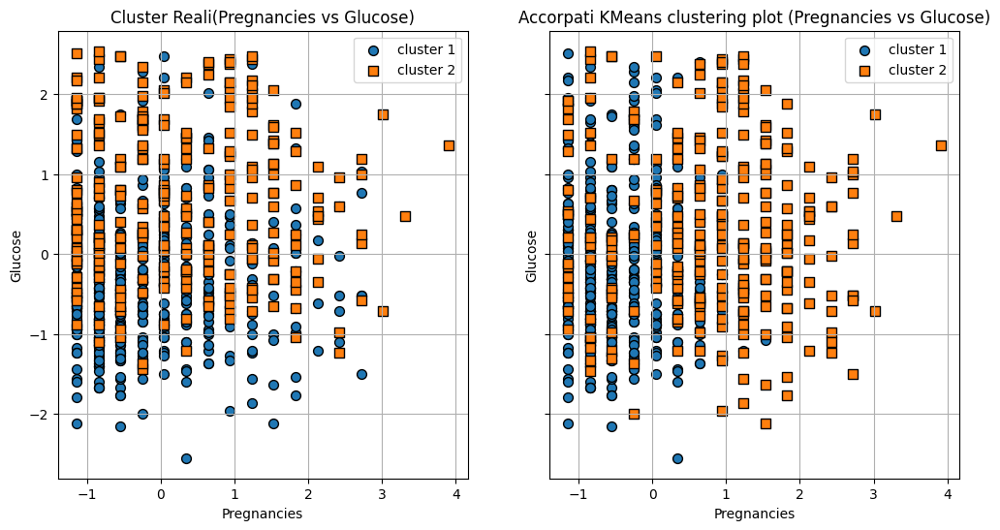

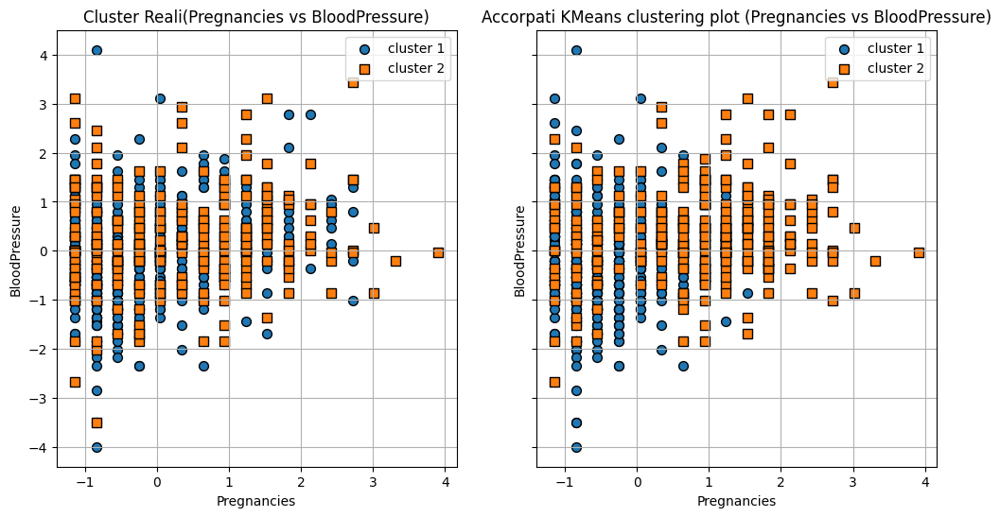

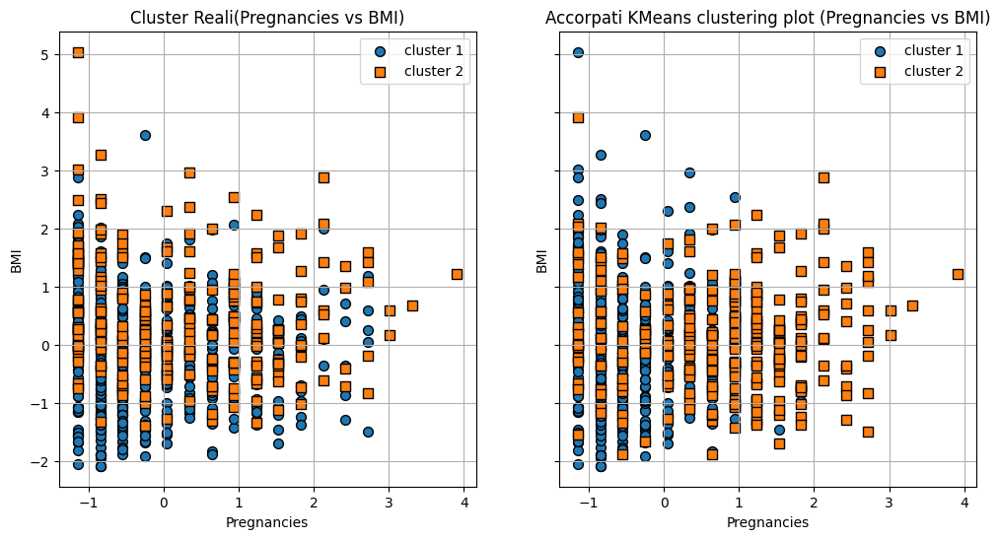

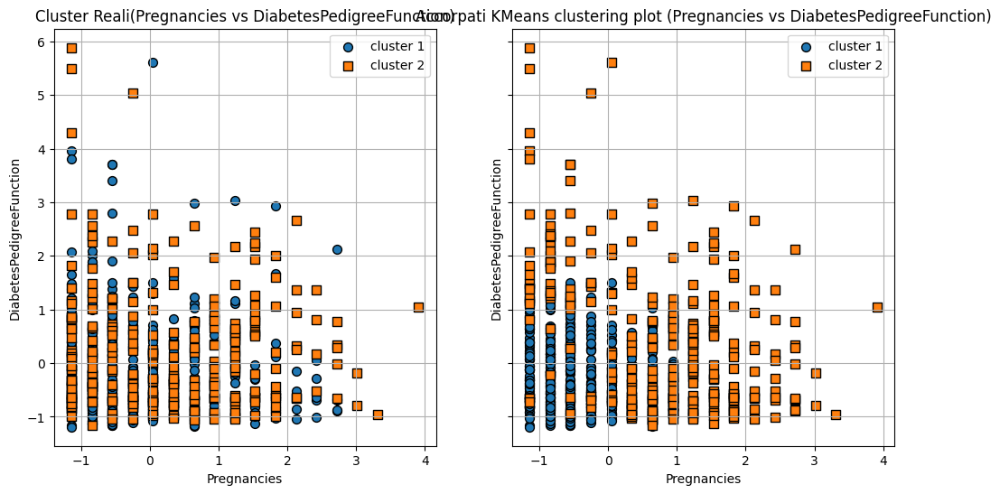

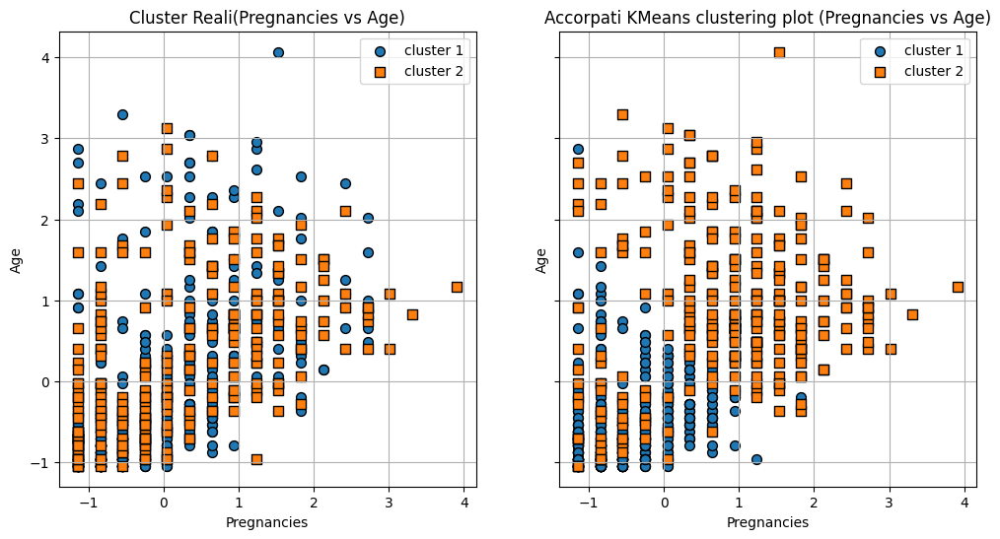

...

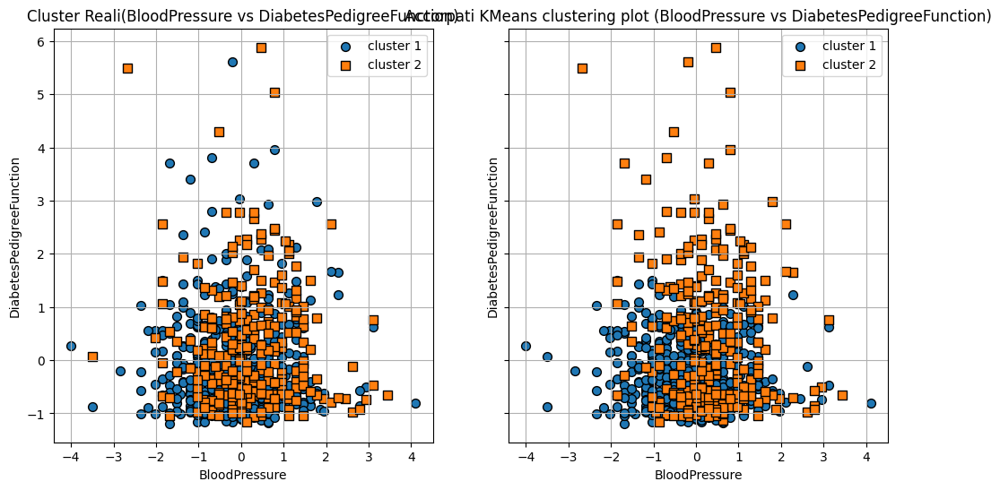

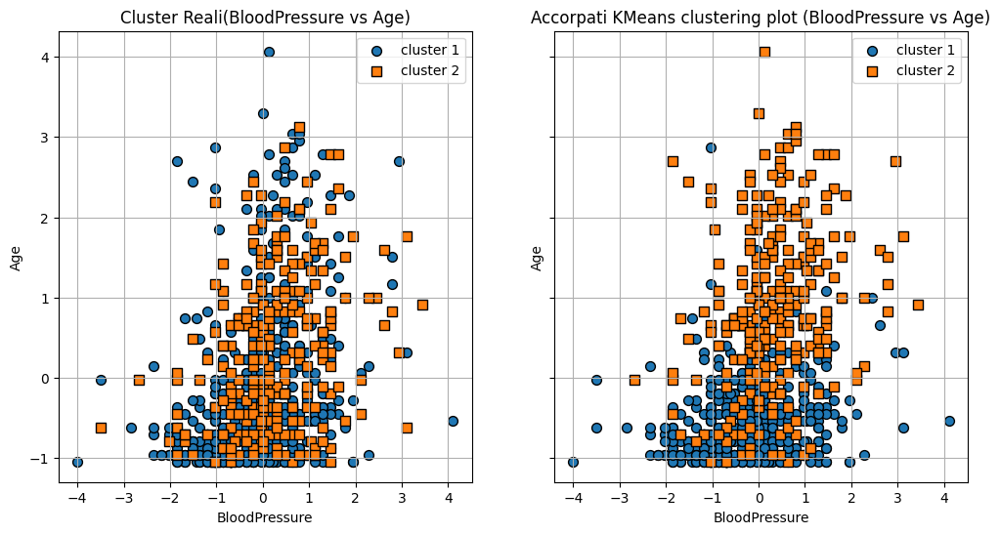

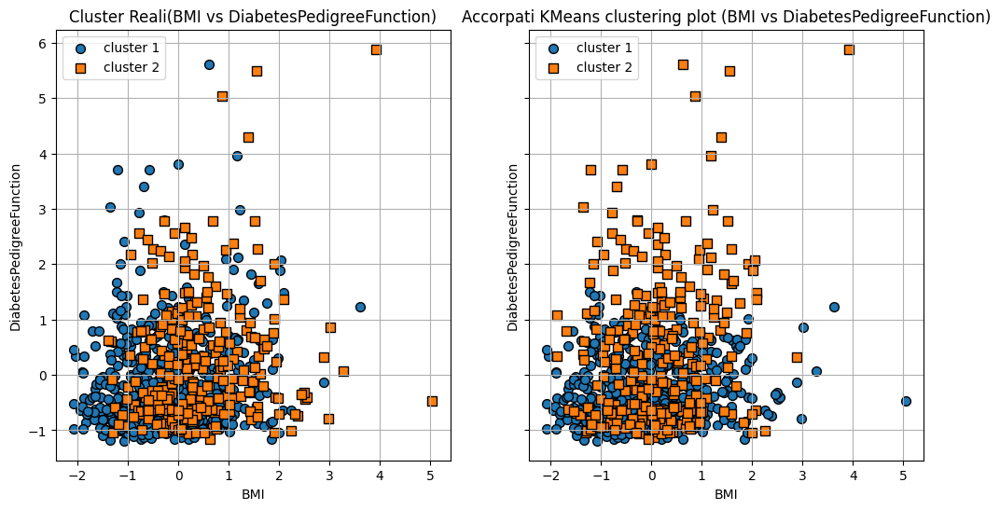

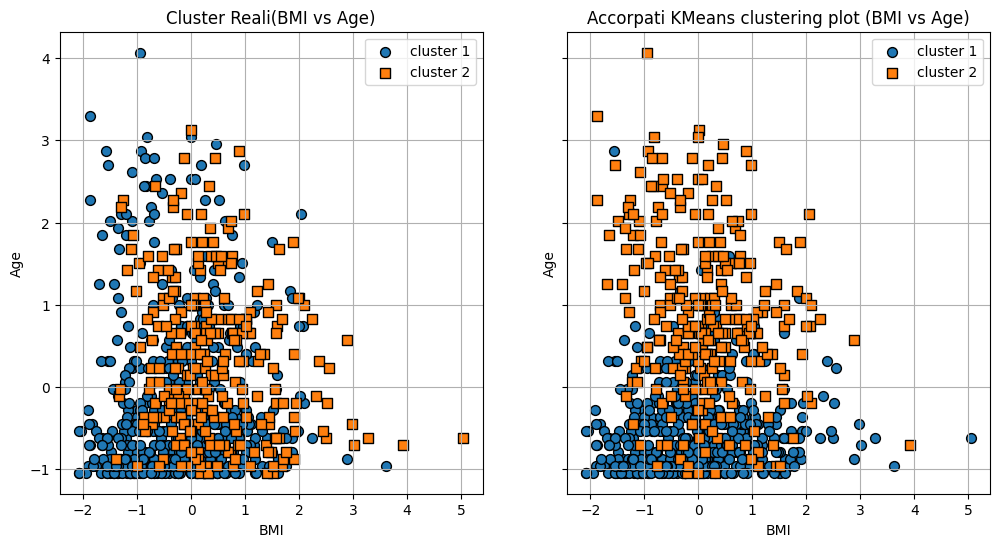

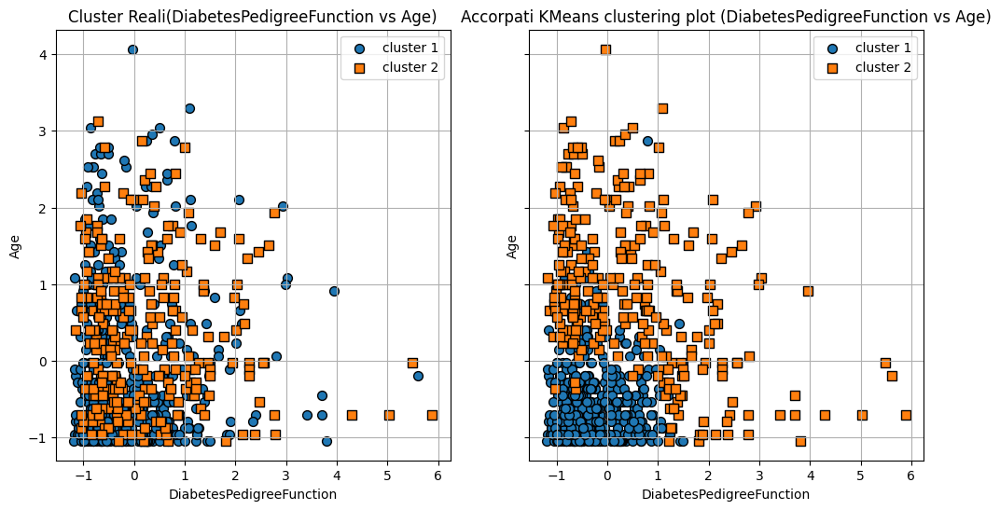

In [76]:

cluster_0 = cluster_percentages[cluster_percentages[0] >= 50].index.tolist()
cluster_1 = cluster_percentages[cluster_percentages[1] > 50].index.tolist()

km_pred_2_clusters = km_pred.copy()
for cluster in cluster_0:
    km_pred_2_clusters[km_pred == cluster] = 0
for cluster in cluster_1:
    km_pred_2_clusters[km_pred == cluster] = 1

columns = X_n.columns

for i in range(len(columns)):
    for j in range(i + 1, len(columns)):
        col_i = columns[i]
        col_j = columns[j]
        
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6), sharey=True)

        for label in np.unique(y):
            ax1.scatter(X[y == label, i], X[y == label, j],
                        s=50, edgecolor="black", label=f'cluster {label + 1}',marker=markers[label % len(markers)])
        ax1.set_title(f"Cluster Reali({col_i} vs {col_j})")
        ax1.set_xlabel(col_i)
        ax1.set_ylabel(col_j)
        ax1.legend(scatterpoints=1)
        ax1.grid()

        for cluster in range(2): 
            ax2.scatter(X[km_pred_2_clusters == cluster, i], X[km_pred_2_clusters == cluster, j],
                        s=50, edgecolor="black", label=f'cluster {cluster + 1}', marker=markers[cluster % len(markers)])
        
        ax2.set_title(f"Accorpati KMeans clustering plot ({col_i} vs {col_j})")
        ax2.set_xlabel(col_i)
        ax2.set_ylabel(col_j)
        ax2.legend(scatterpoints=1)
        ax2.grid()

        plt.show()

Risultati finali per Kmeans - StandardScaler con k=4
Final Silhouette score: 0.2186565373254017
Final Rand score: 0.5603134506736202
Classification Report:
              precision    recall  f1-score   support

           0       0.76      0.73      0.75       500
           1       0.53      0.57      0.55       268

    accuracy                           0.67       768
   macro avg       0.65      0.65      0.65       768
weighted avg       0.68      0.67      0.68       768



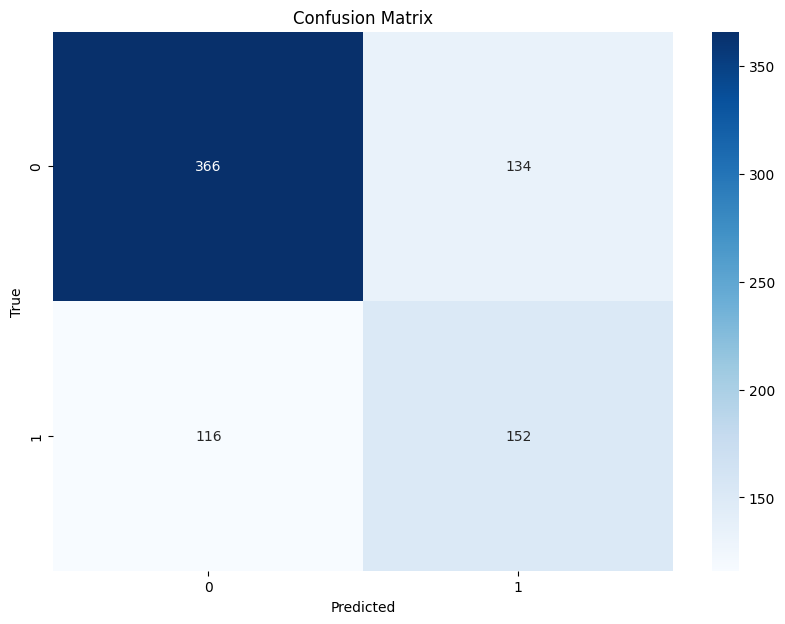

In [77]:
print("Risultati finali per Kmeans - StandardScaler con k=4")
ss_final = silhouette_score(X, km_pred_2_clusters, metric="euclidean")
rs_final = rand_score(y, km_pred_2_clusters)
print("Final Silhouette score:", ss_final)
print("Final Rand score:", rs_final)
report = classification_report(y, km_pred_2_clusters, target_names=[str(i) for i in np.unique(y)])
print("Classification Report:")
print(report)

conf_matrix = confusion_matrix(y, km_pred_2_clusters)

plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=np.unique(y), yticklabels=np.unique(y))
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

#### K-Means - Normalizer

In [79]:
from sklearn.preprocessing import StandardScaler, Normalizer

X_n = df_adj.drop(columns=["Outcome"])
y = df_adj["Outcome"]
 
X = Normalizer().fit_transform(X_n)

c:\Users\rocco\AppData\Local\Programs\Python\Python39\lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


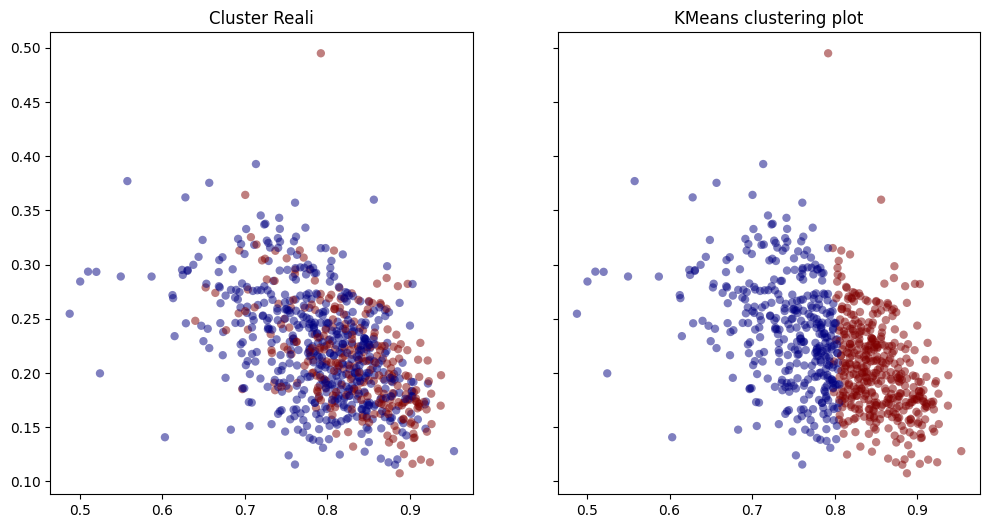

In [40]:
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

km = KMeans(n_clusters=2)
km_pred = km.fit_predict(X)
labels = km.labels_


glucose_index = X_n.columns.get_loc("Glucose")
bmi_index = X_n.columns.get_loc("BMI")

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6), sharey=True)

ax1.scatter(X[:, glucose_index], X[:, bmi_index], c=y, cmap="jet", edgecolors='none', alpha=0.5)
ax1.set_title("Cluster Reali")

ax2.scatter(X[:, glucose_index], X[:, bmi_index], c=km_pred, cmap="jet", edgecolors='none', alpha=0.5)
ax2.set_title("KMeans clustering plot")

plt.show()



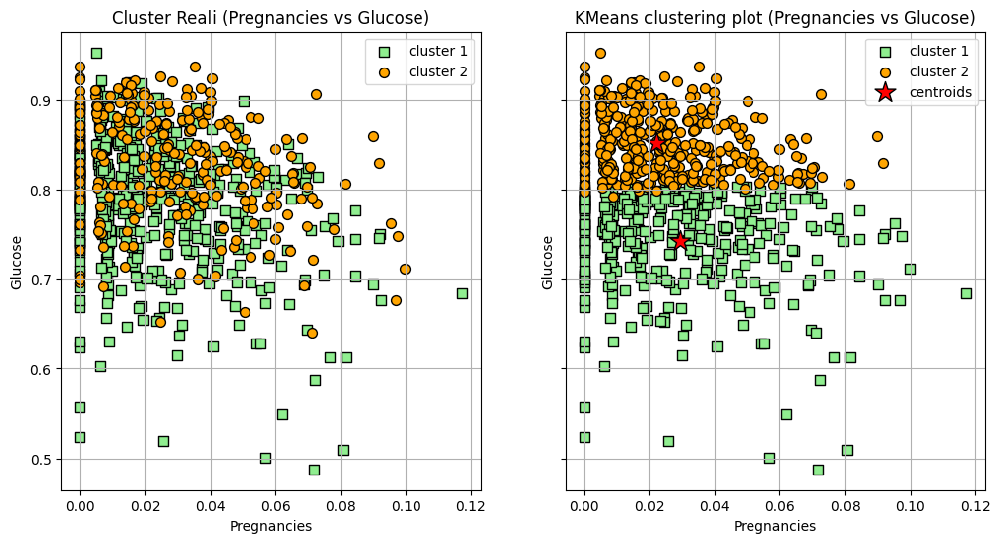

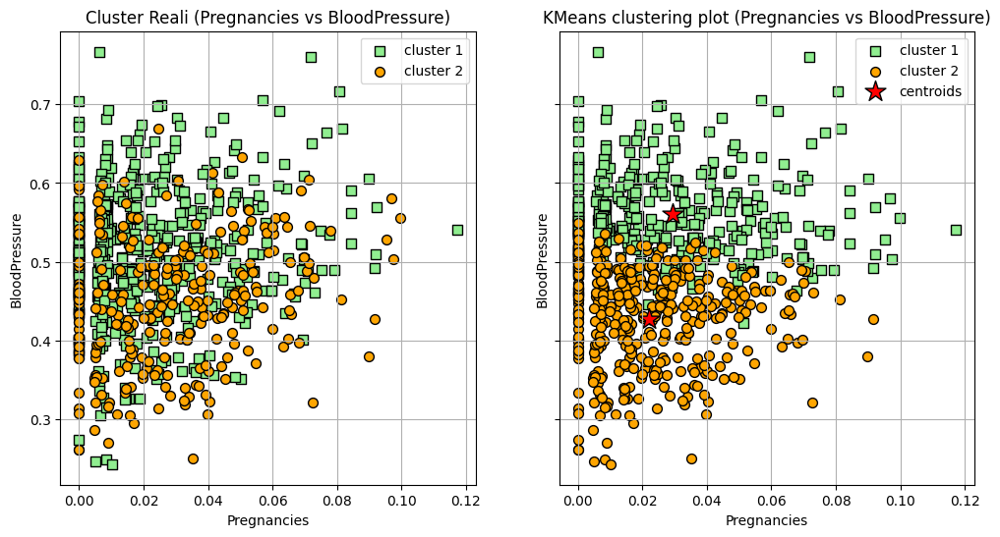

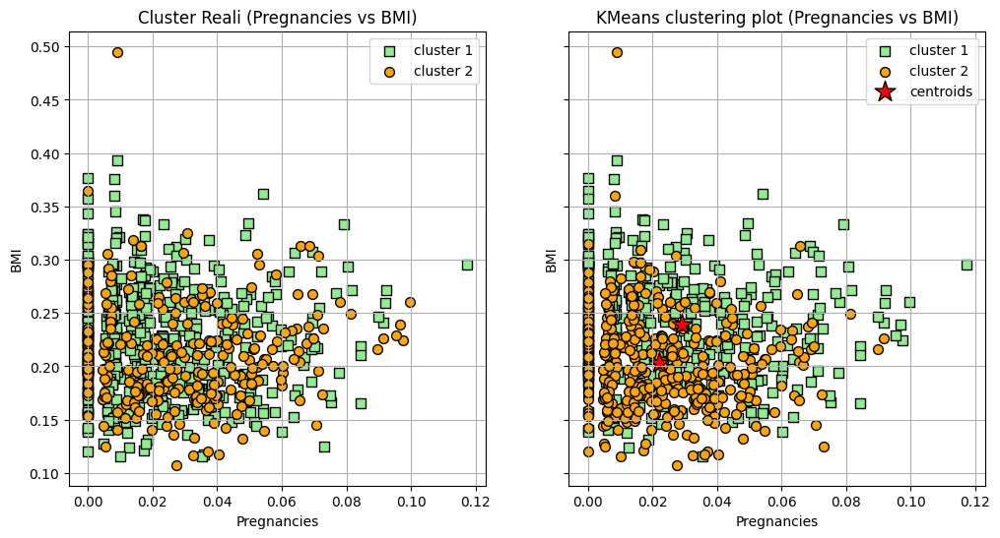

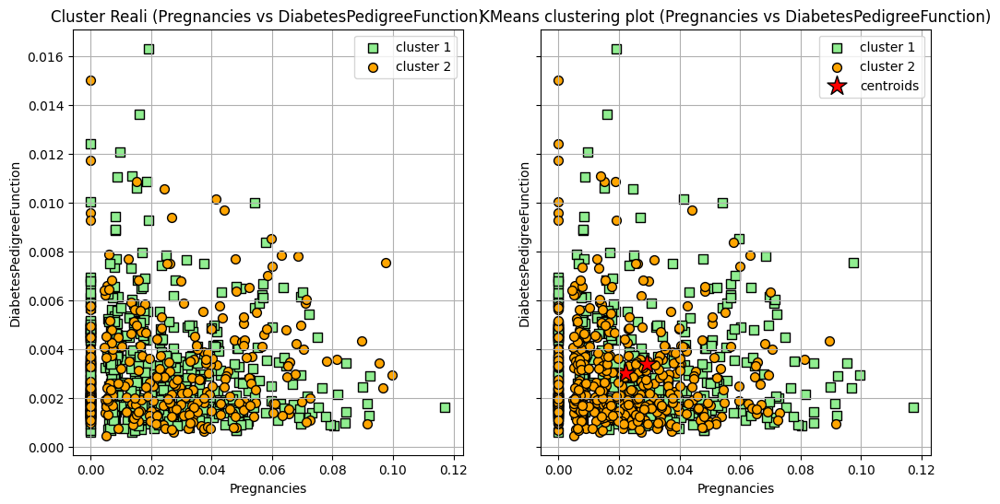

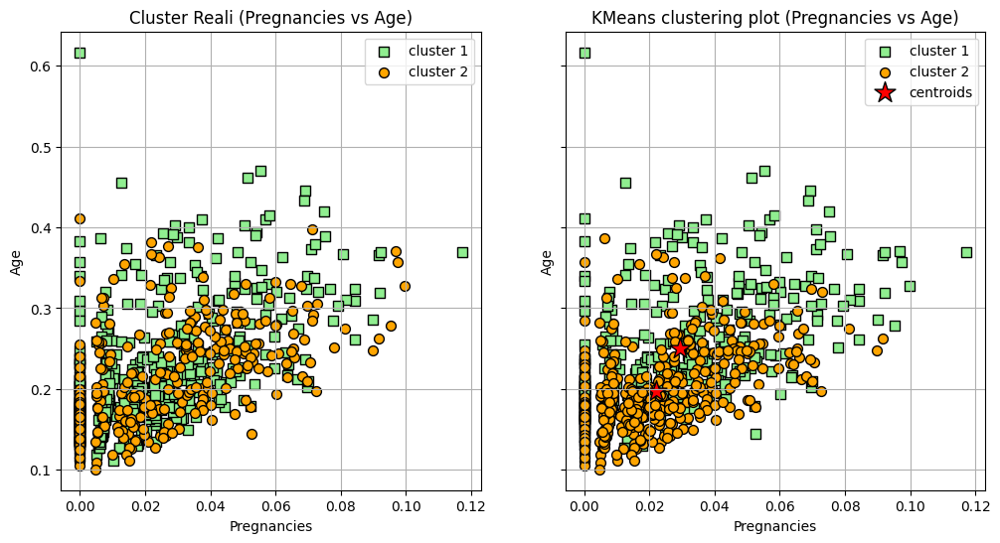

...

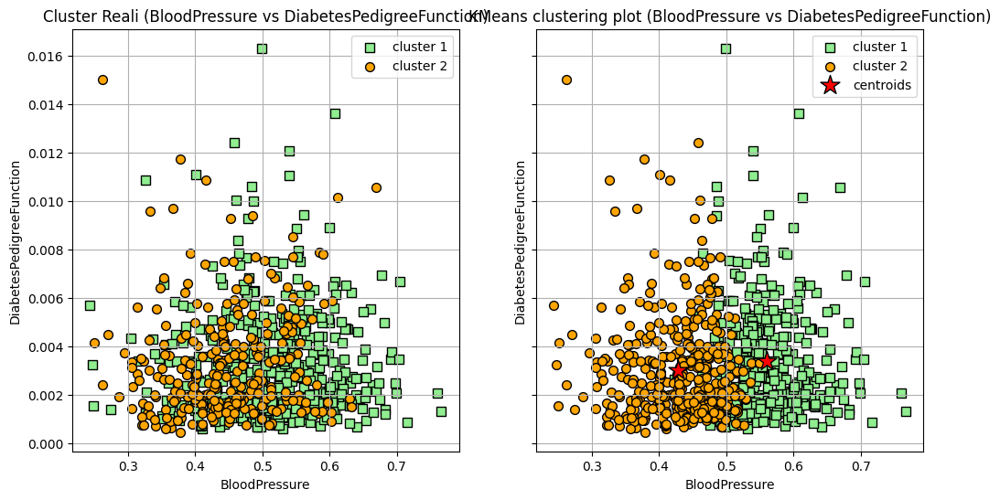

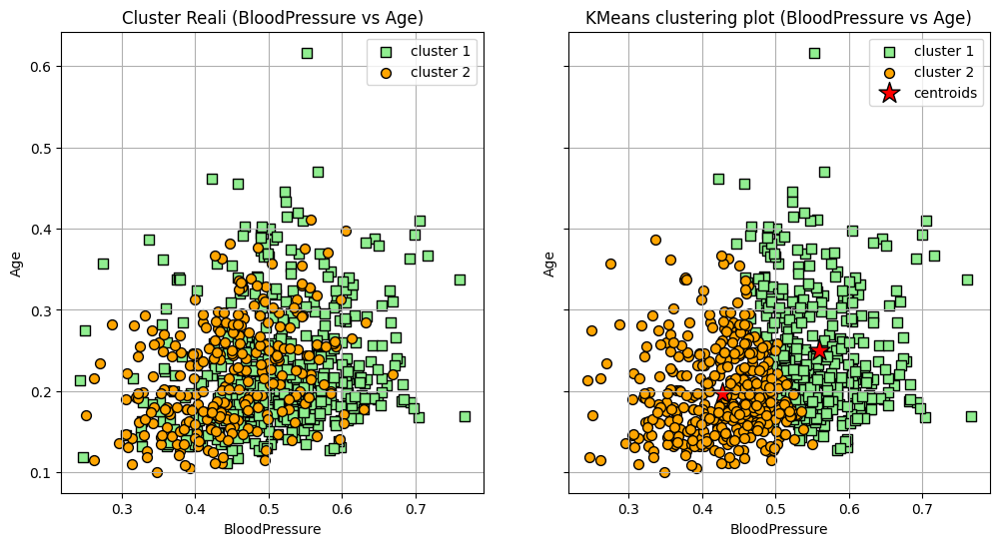

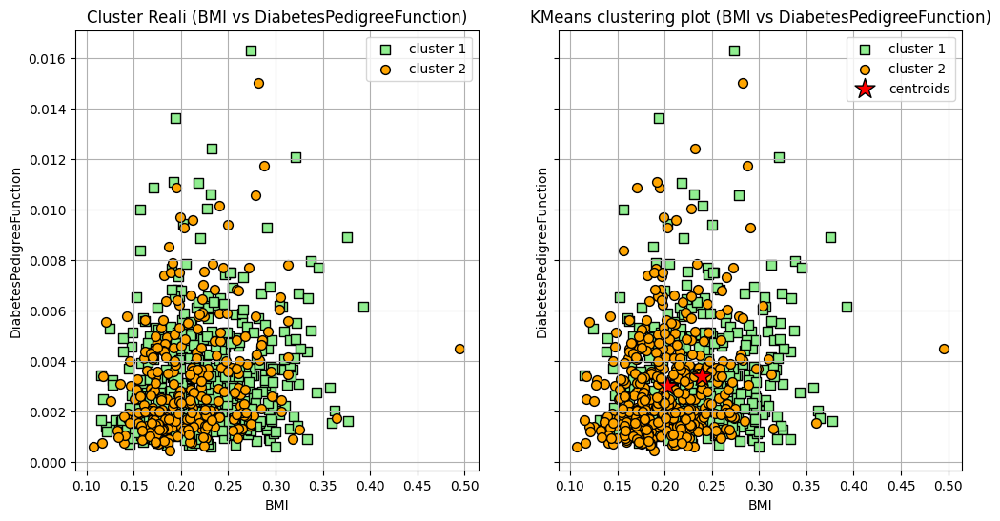

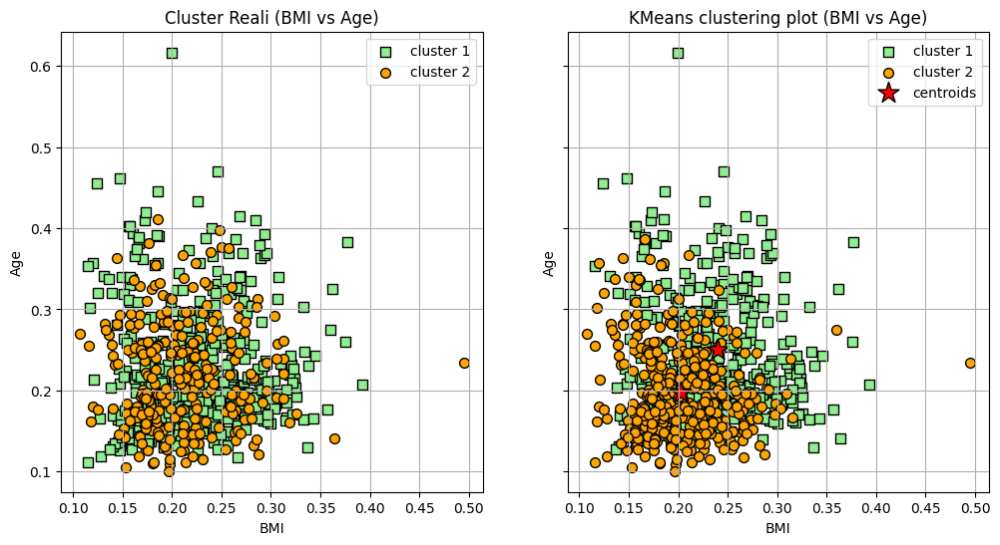

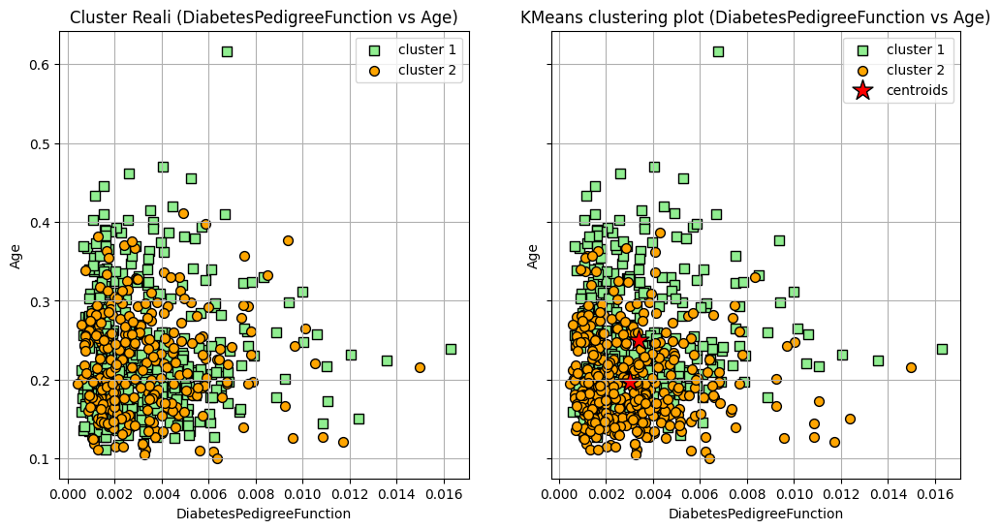

In [41]:
columns = X_n.columns

for i in range(len(columns)):
    for j in range(i + 1, len(columns)):
        col_i = columns[i]
        col_j = columns[j]
        
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6), sharey=True)

        for label, color, marker in zip([0, 1], ['lightgreen', 'orange'], ['s', 'o']):
            ax1.scatter(X[y == label, i], X[y == label, j],
                        s=50, c=color, marker=marker, edgecolor="black", label=f'cluster {label + 1}')
        ax1.set_title(f"Cluster Reali ({col_i} vs {col_j})")
        ax1.set_xlabel(col_i)
        ax1.set_ylabel(col_j)
        ax1.legend(scatterpoints=1)
        ax1.grid()

        ax2.scatter(X[km_pred == 0, i], X[km_pred == 0, j],
                    s=50, c='lightgreen', marker='s', edgecolor="black", label='cluster 1')
        ax2.scatter(X[km_pred == 1, i], X[km_pred == 1, j],
                    s=50, c='orange', marker='o', edgecolor='black', label='cluster 2')

        ax2.scatter(km.cluster_centers_[:, i], km.cluster_centers_[:, j],
                    s=250, marker='*', c='red', edgecolor="black", label='centroids')

        ax2.set_title(f"KMeans clustering plot ({col_i} vs {col_j})")
        ax2.set_xlabel(col_i)
        ax2.set_ylabel(col_j)
        ax2.legend(scatterpoints=1)
        ax2.grid()

        plt.show()

Risultati finali per Kmeans - Normalizer per k=2
Silhouette score: 0.3422882913053487
Rand_score: 0.5210777922642329
Classification Report:
              precision    recall  f1-score   support

           0       0.77      0.56      0.65       500
           1       0.46      0.69      0.55       268

    accuracy                           0.60       768
   macro avg       0.61      0.62      0.60       768
weighted avg       0.66      0.60      0.61       768



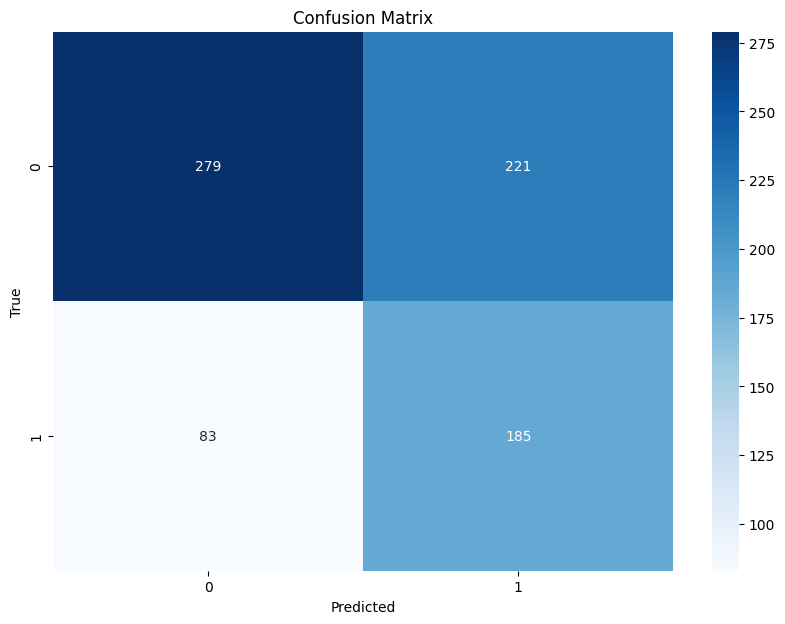

In [42]:
print("Risultati finali per Kmeans - Normalizer per k=2")
from sklearn.metrics import silhouette_score, rand_score
ss=silhouette_score(X, km_pred, metric="euclidean" )
print("Silhouette score:",ss)

ris=rand_score(y,km_pred)
print("Rand_score:",ris)
report = classification_report(y, km_pred, target_names=[str(i) for i in np.unique(y)])
print("Classification Report:")
print(report)

conf_matrix = confusion_matrix(y, km_pred)
plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=np.unique(y), yticklabels=np.unique(y))
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

c:\Users\rocco\AppData\Local\Programs\Python\Python39\lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Users\rocco\AppData\Local\Programs\Python\Python39\lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Users\rocco\AppData\Local\Programs\Python\Python39\lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Users\rocco\AppData\Local\Programs\Python\Python39\lib\site-packages\sklearn\cluster\

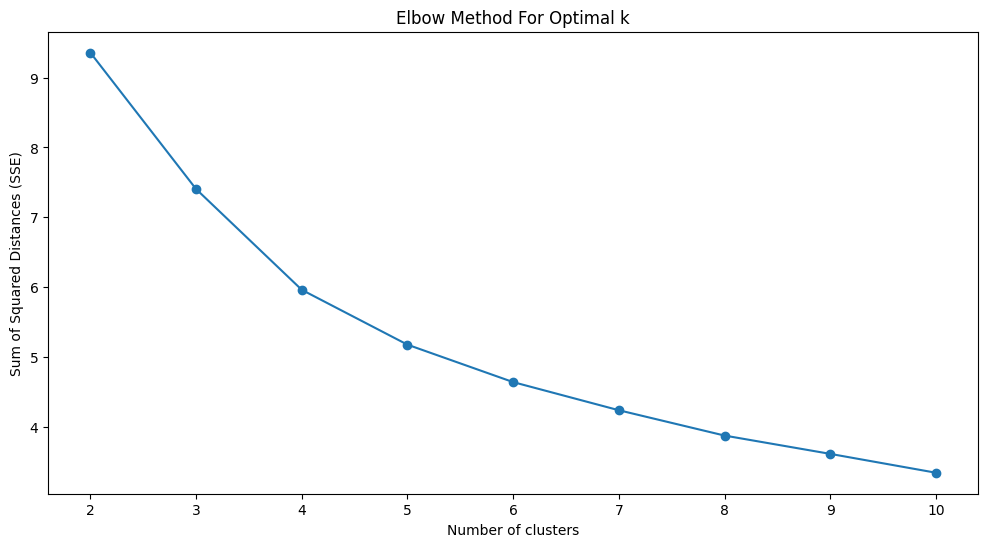

In [43]:
range_n_clusters = range(2, 11)


sse = []
silhouette_scores = []
rand_scores = []

for n_clusters in range_n_clusters:
    km = KMeans(n_clusters=n_clusters, random_state=42)
    km_pred = km.fit_predict(X)
    
    sse.append(km.inertia_)
    silhouette_scores.append(silhouette_score(X, km_pred, metric="euclidean"))
    rand_scores.append(rand_score(y, km_pred))

plt.figure(figsize=(12, 6))
plt.plot(range_n_clusters, sse, marker='o')
plt.title('Elbow Method For Optimal k')
plt.xlabel('Number of clusters')
plt.ylabel('Sum of Squared Distances (SSE)')
plt.show()


c:\Users\rocco\AppData\Local\Programs\Python\Python39\lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


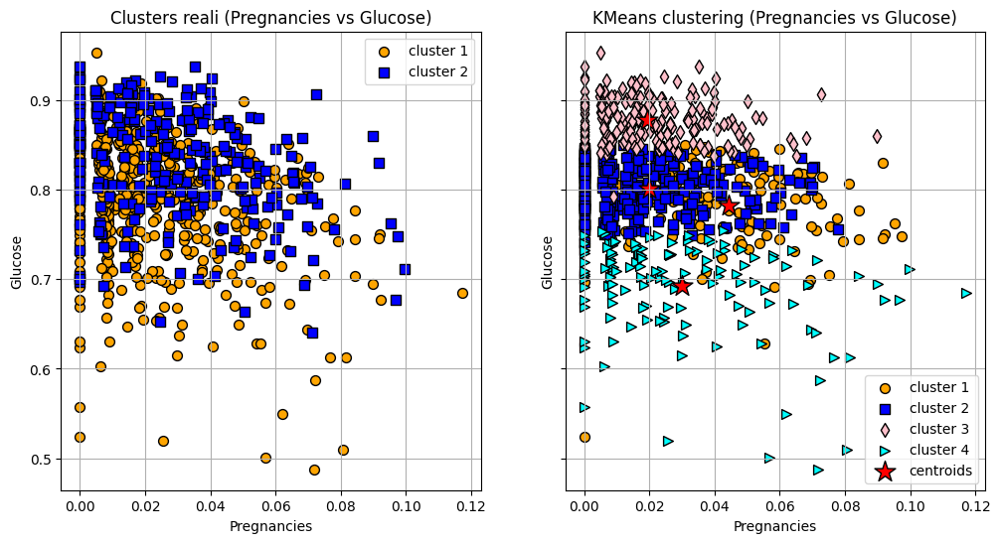

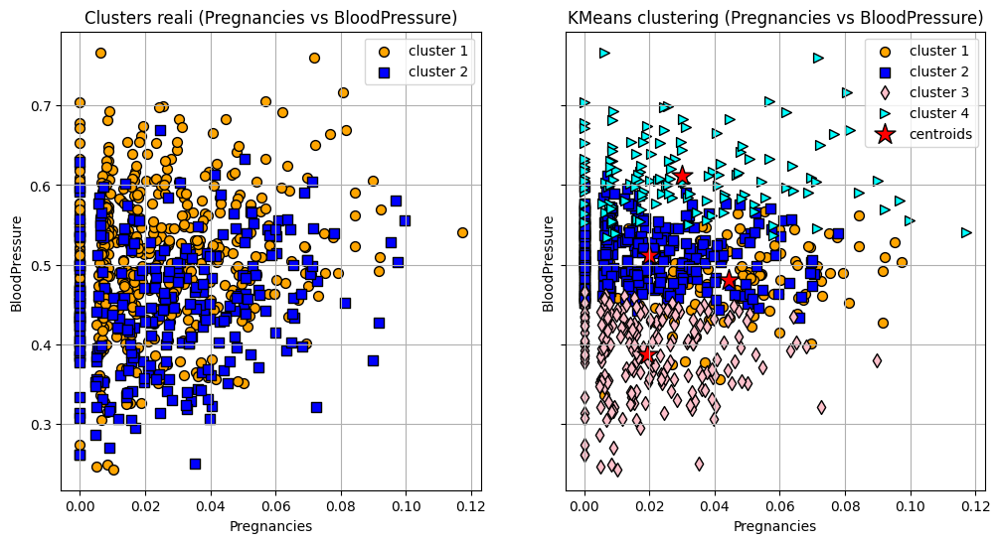

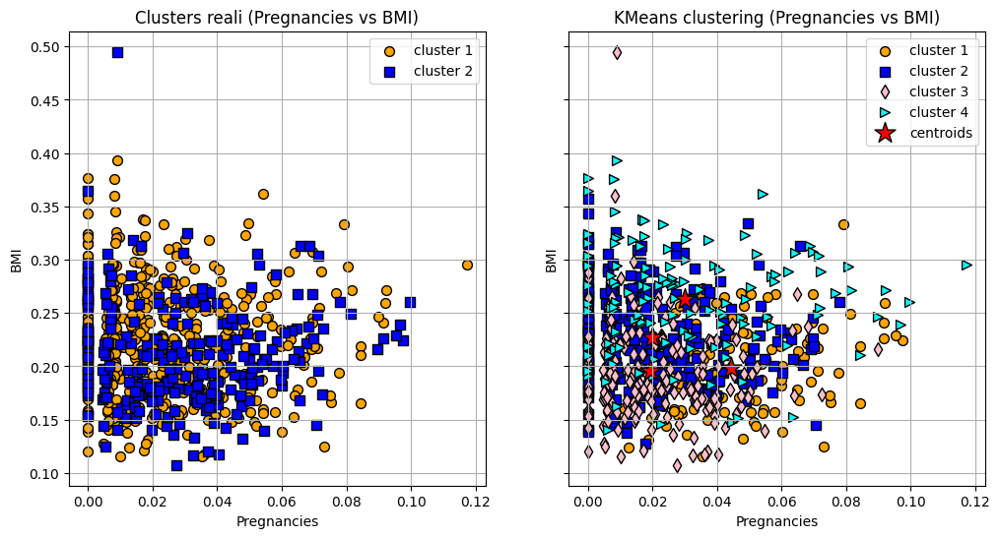

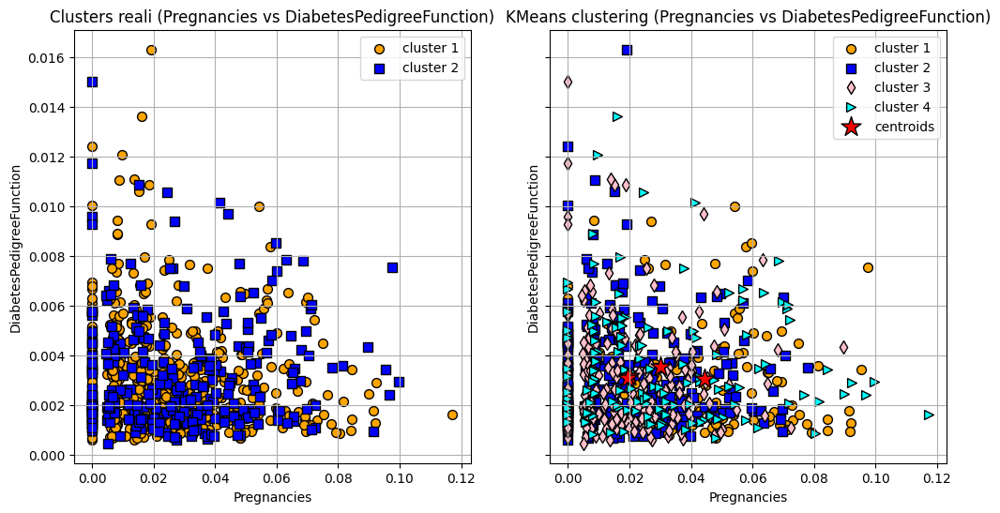

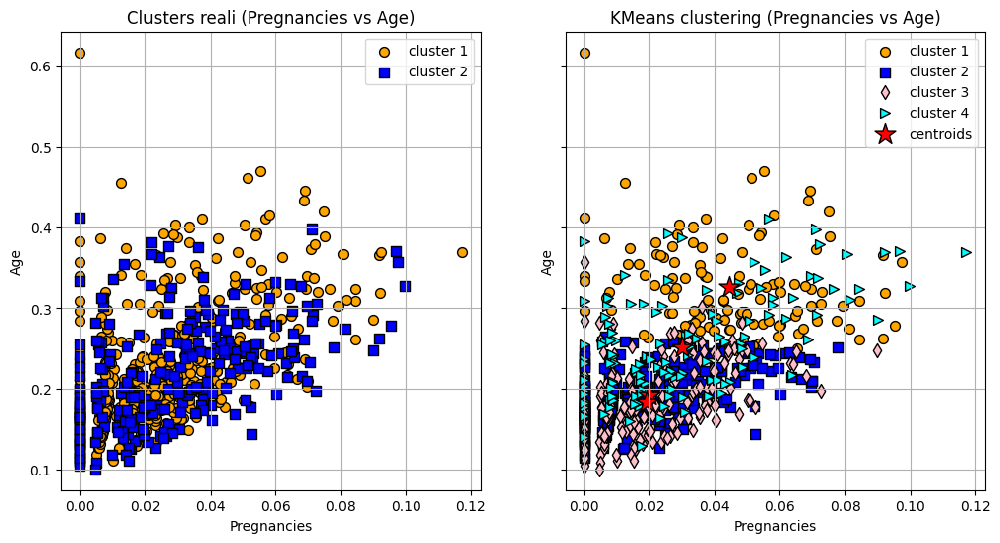

...

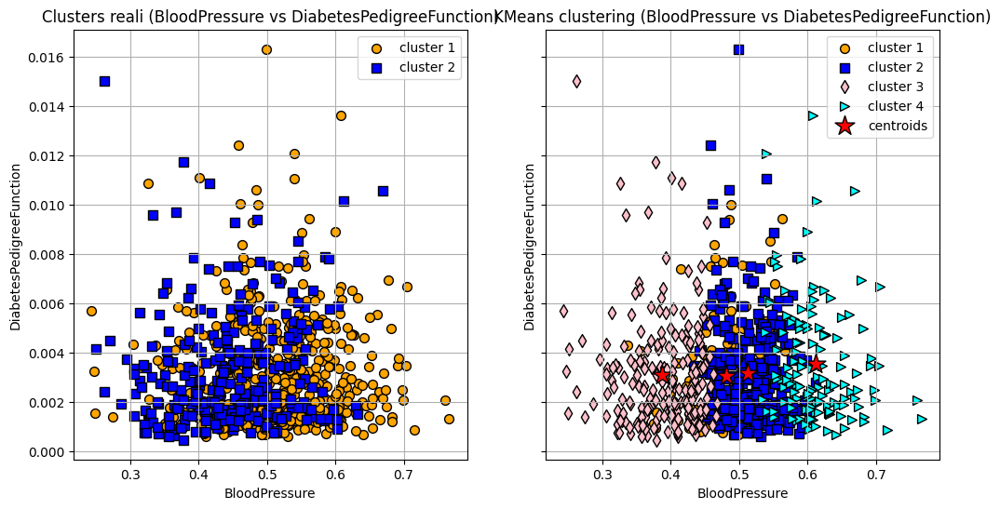

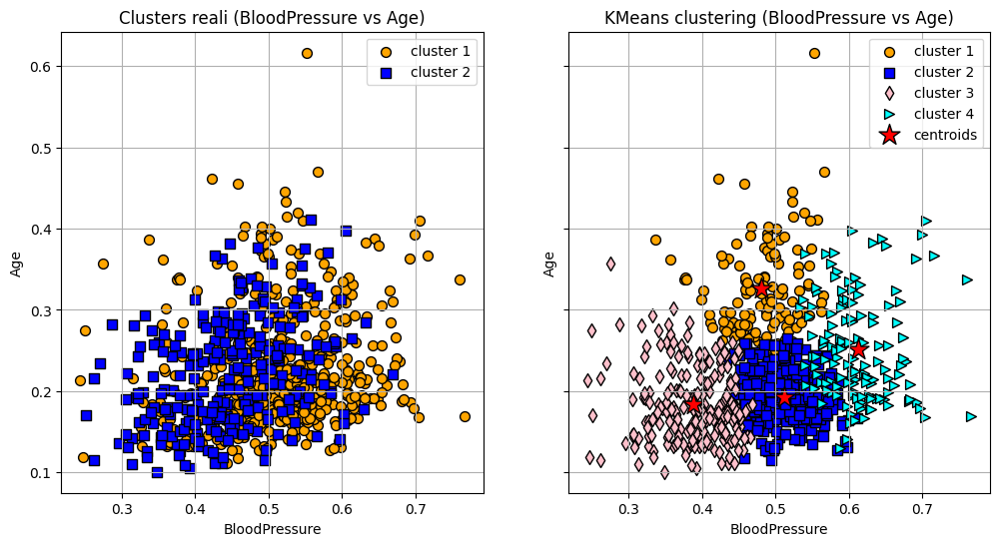

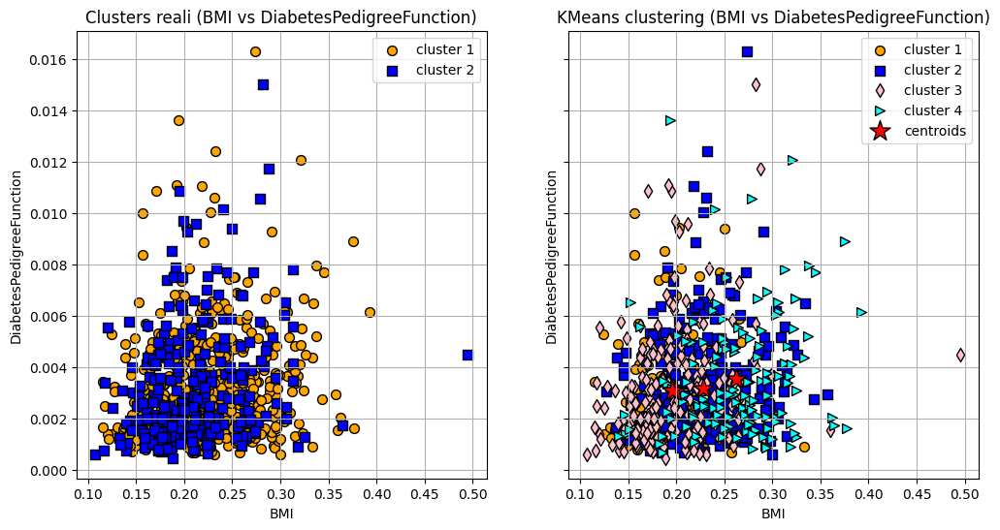

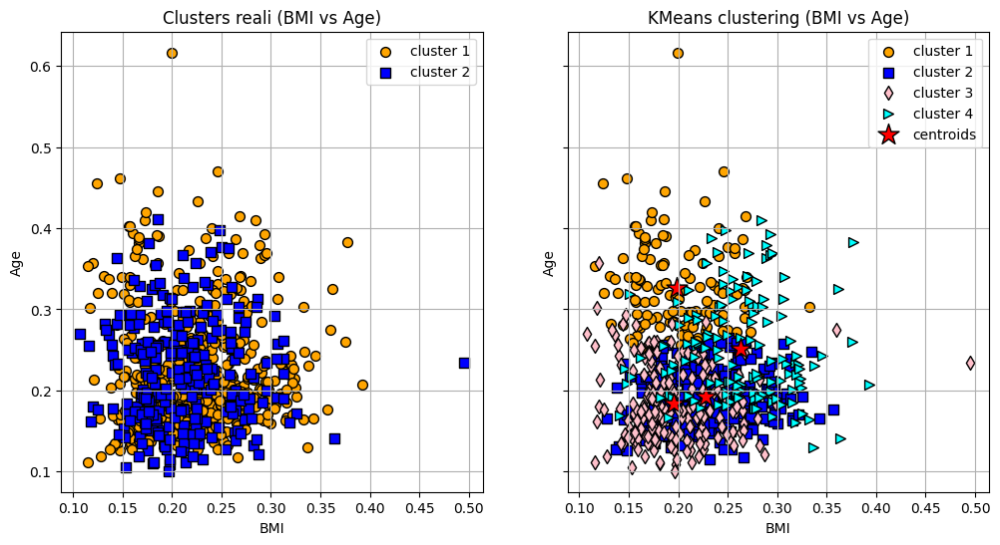

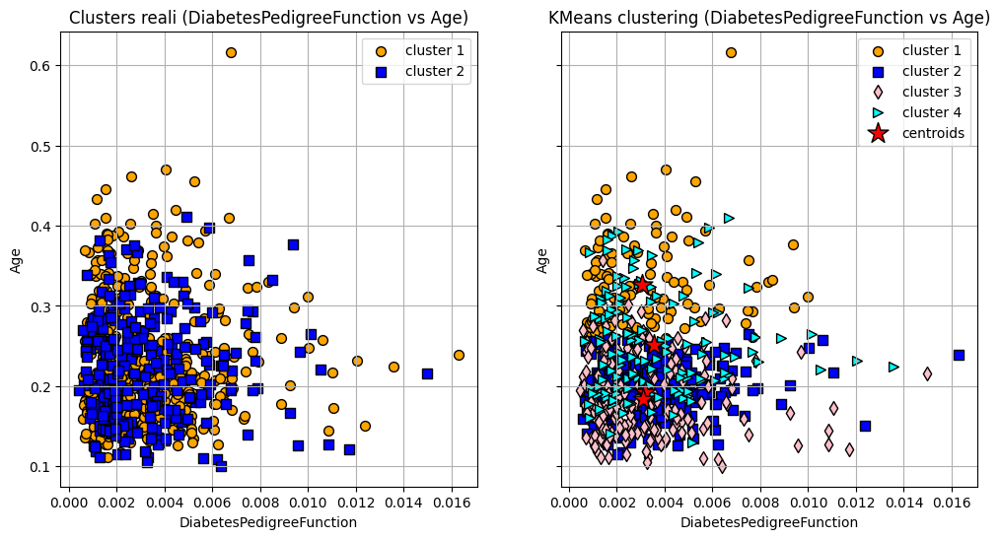

In [44]:
n_clusters = 4

km = KMeans(n_clusters=n_clusters, random_state=42)
km_pred = km.fit_predict(X)
labels = km.labels_
colors = [ 'orange', 'blue', 'pink', 'cyan']
markers = [ 'o', 's','d', '>']
columns = X_n.columns

for i in range(len(columns)):
    for j in range(i + 1, len(columns)):
        col_i = columns[i]
        col_j = columns[j]
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6), sharey=True)

        for label in np.unique(y):
            ax1.scatter(X[y == label, i], X[y == label, j],
                        s=50, c=colors[label % len(colors)], marker=markers[label % len(markers)],
                        edgecolor="black", label=f'cluster {label + 1}')
        ax1.set_title(f"Clusters reali ({col_i} vs {col_j})")
        ax1.set_xlabel(col_i)
        ax1.set_ylabel(col_j)
        ax1.legend(scatterpoints=1)
        ax1.grid()

        for cluster in range(n_clusters):
            ax2.scatter(X[km_pred == cluster, i], X[km_pred == cluster, j],
                        s=50, c=colors[cluster % len(colors)], marker=markers[cluster % len(markers)],
                        edgecolor="black", label=f'cluster {cluster + 1}')

        ax2.scatter(km.cluster_centers_[:, i], km.cluster_centers_[:, j],
                    s=250, marker='*', c='red', edgecolor="black", label='centroids')

        ax2.set_title(f"KMeans clustering ({col_i} vs {col_j})")
        ax2.set_xlabel(col_i)
        ax2.set_ylabel(col_j)
        ax2.legend(scatterpoints=1)
        ax2.grid()

        plt.show()

In [45]:
print("Risultati intermedi Kmeans - Normalizer con k=4")
from sklearn.metrics import silhouette_score, rand_score
ss=silhouette_score(X, km_pred, metric="euclidean" )
print("Silhouette score:",ss)

ris=rand_score(y,km_pred)
print("Rand_score:",ris)

df_clusters = pd.DataFrame({'Cluster': km_pred, 'Classe': y})
cluster_percentages=df_clusters.groupby('Cluster')['Classe'].value_counts(normalize=True).unstack() * 100
cluster_info = cluster_percentages.copy()
cluster_info['Osservazioni'] = df_clusters['Cluster'].value_counts().sort_index()

print("Informazioni sui cluster:")
print(cluster_info)

Risultati intermedi Kmeans - Normalizer con k=4
Silhouette score: 0.29777843742091265
Rand_score: 0.5125047533681009
Informazioni sui cluster:
Classe           0          1  Osservazioni
Cluster                                    
0        57.258065  42.741935           124
1        76.791809  23.208191           293
2        41.860465  58.139535           215
3        83.823529  16.176471           136


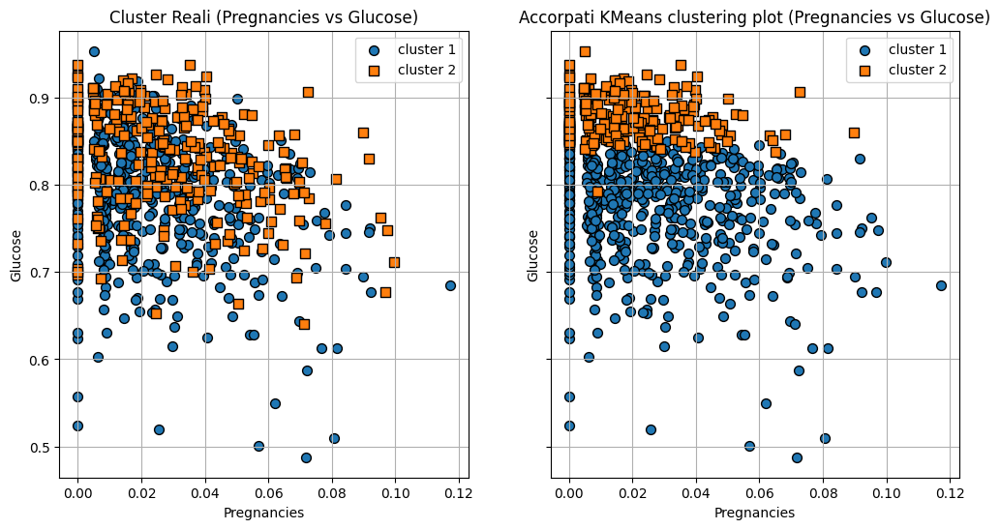

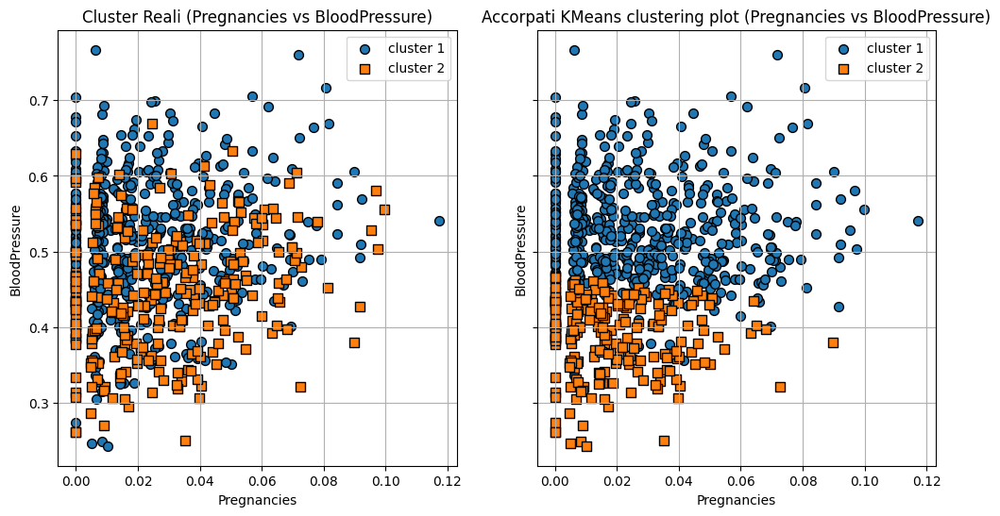

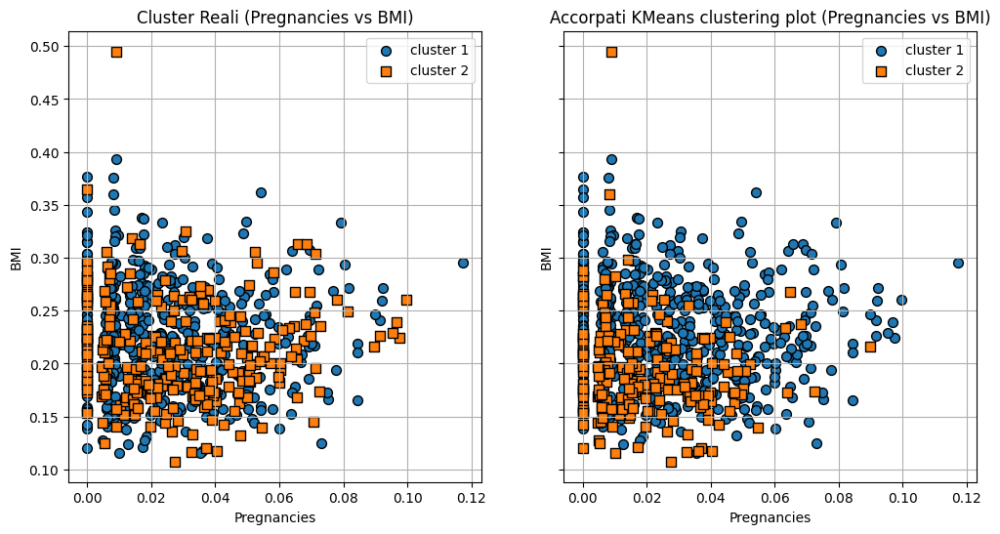

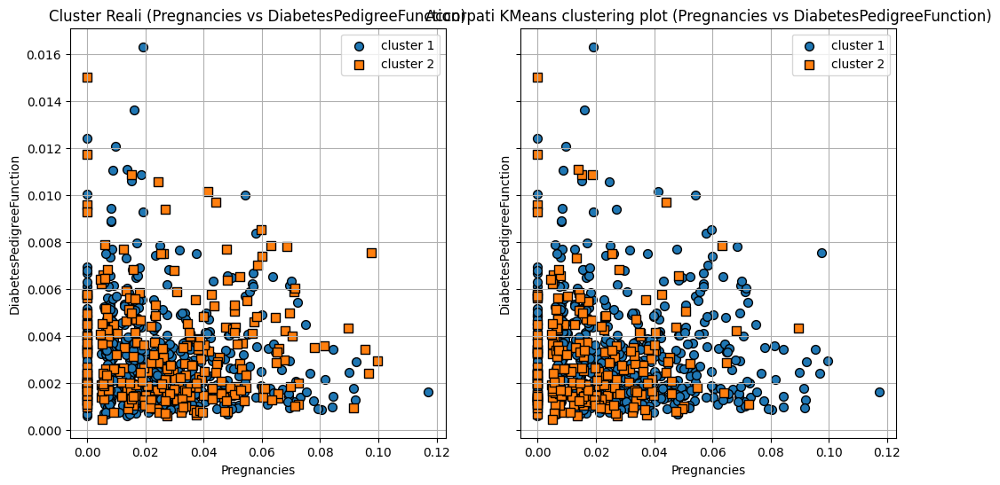

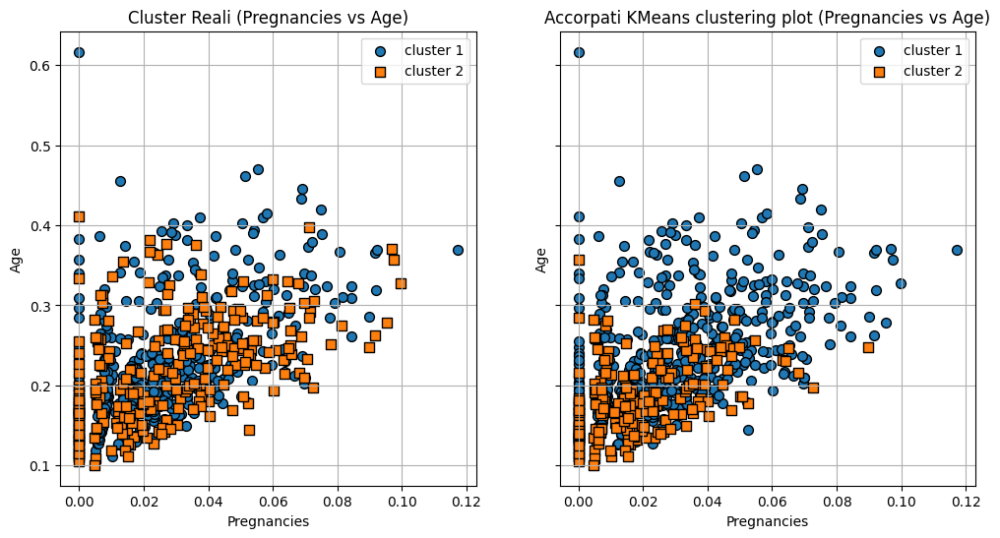

...

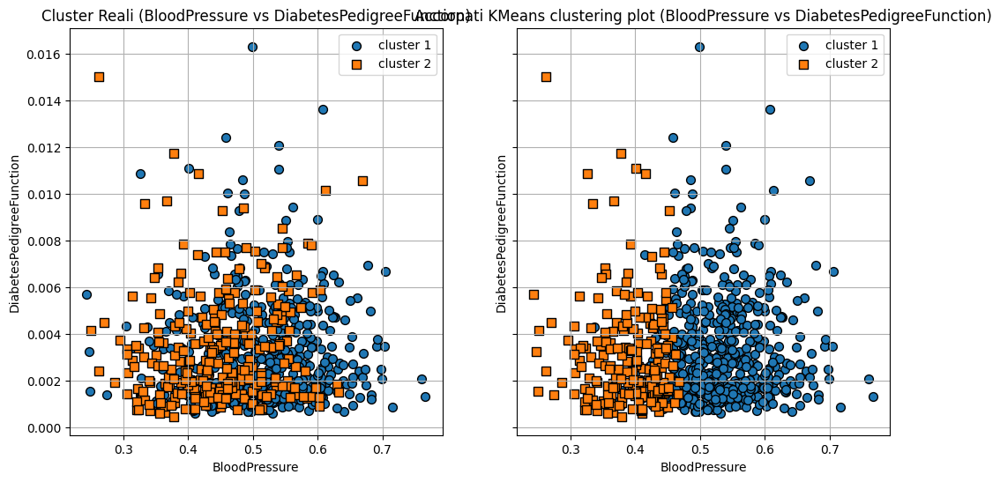

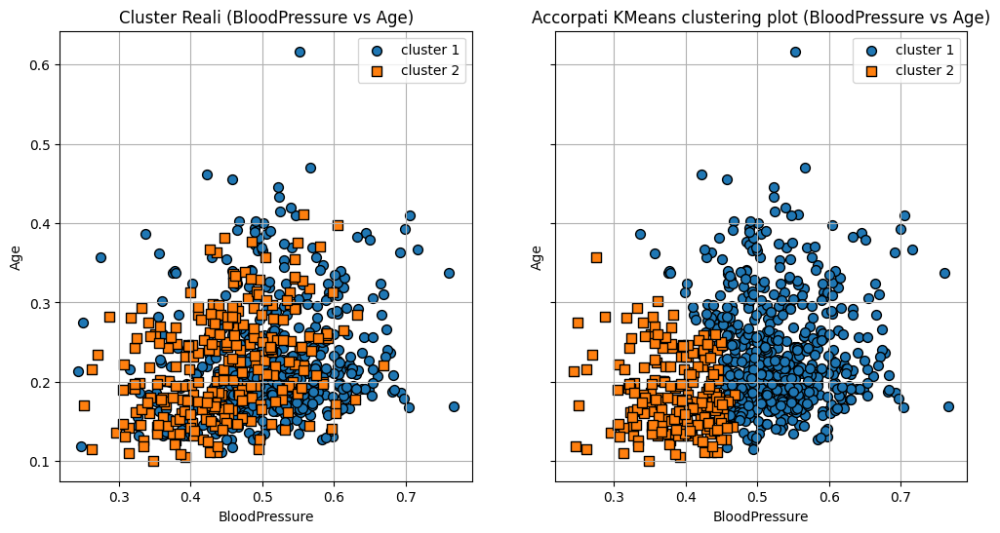

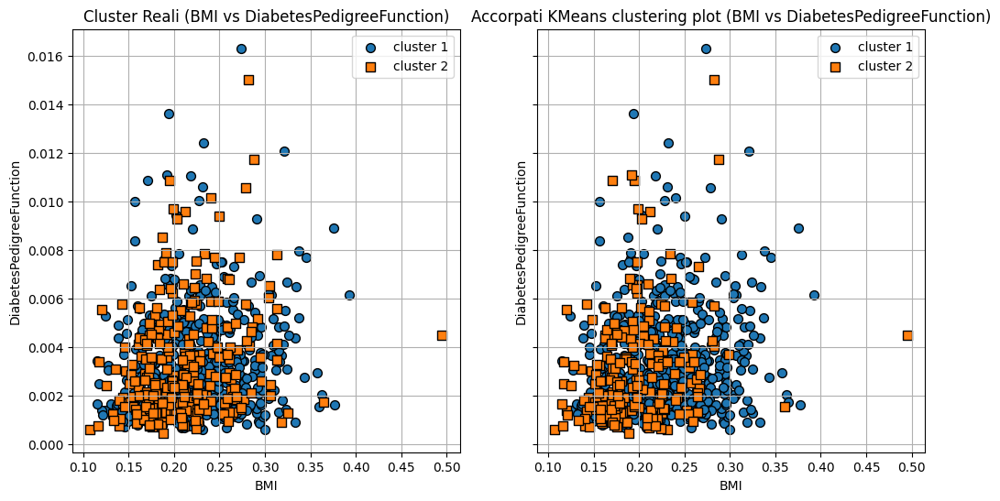

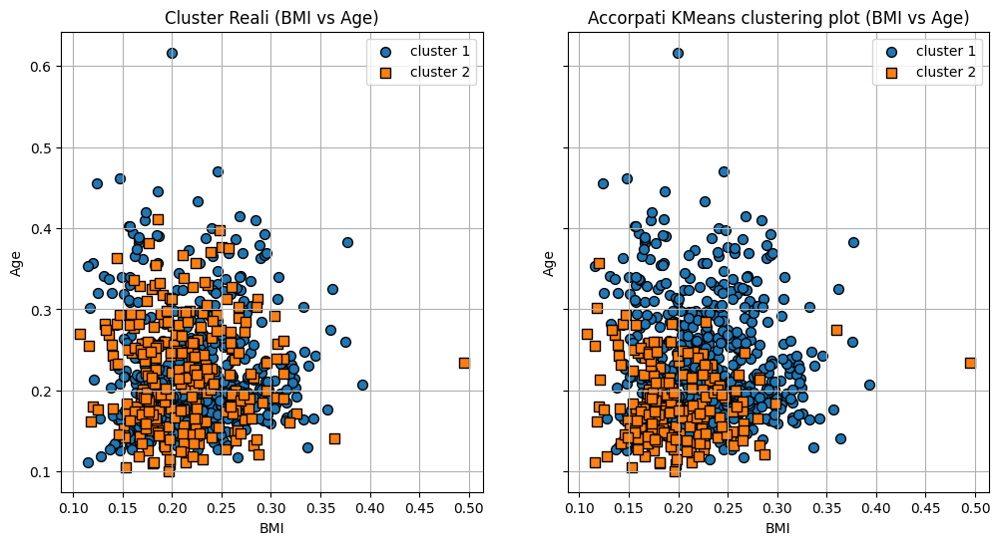

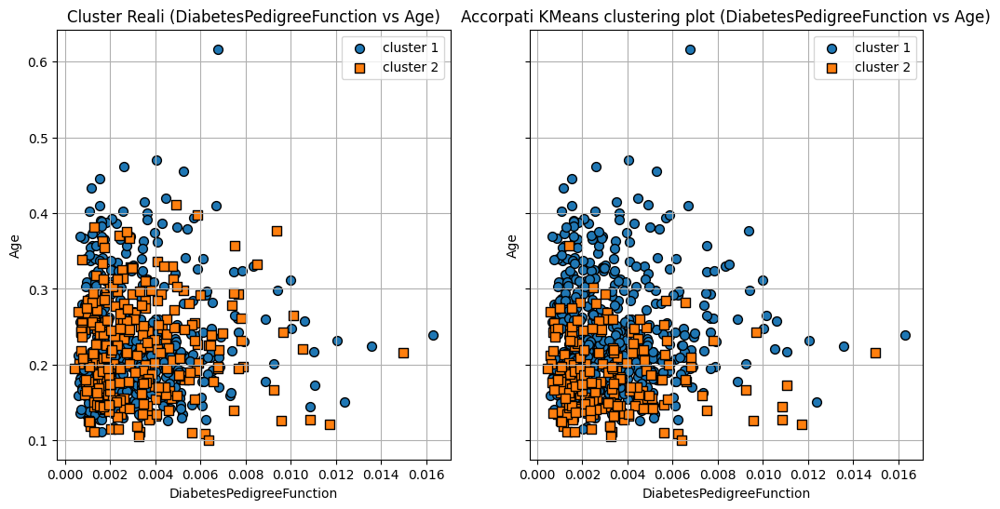

In [46]:
cluster_0 = cluster_percentages[cluster_percentages[0] >= 50].index.tolist()
cluster_1 = cluster_percentages[cluster_percentages[1] > 50].index.tolist()

km_pred_2_clusters = km_pred.copy()
for cluster in cluster_0:
    km_pred_2_clusters[km_pred == cluster] = 0
for cluster in cluster_1:
    km_pred_2_clusters[km_pred == cluster] = 1
columns = X_n.columns

for i in range(len(columns)):
    for j in range(i + 1, len(columns)):
        col_i = columns[i]
        col_j = columns[j]
        
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6), sharey=True)

        for label in np.unique(y):
            ax1.scatter(X[y == label, i], X[y == label, j],
                        s=50, edgecolor="black", label=f'cluster {label + 1}',marker=markers[label % len(markers)])
        ax1.set_title(f"Cluster Reali ({col_i} vs {col_j})")
        ax1.set_xlabel(col_i)
        ax1.set_ylabel(col_j)
        ax1.legend(scatterpoints=1)
        ax1.grid()

        for cluster in range(2): 
            ax2.scatter(X[km_pred_2_clusters == cluster, i], X[km_pred_2_clusters == cluster, j],
                        s=50, edgecolor="black", label=f'cluster {cluster + 1}', marker=markers[cluster % len(markers)])
        
        ax2.set_title(f"Accorpati KMeans clustering plot ({col_i} vs {col_j})")
        ax2.set_xlabel(col_i)
        ax2.set_ylabel(col_j)
        ax2.legend(scatterpoints=1)
        ax2.grid()

        plt.show()

Risultati finali per Kmeans - Normalizer con k=4
Final Silhouette score: 0.30876642118956404
Final Rand score: 0.5767634995654063
Classification Report:
              precision    recall  f1-score   support

           0       0.74      0.82      0.78       500
           1       0.58      0.47      0.52       268

    accuracy                           0.70       768
   macro avg       0.66      0.64      0.65       768
weighted avg       0.69      0.70      0.69       768



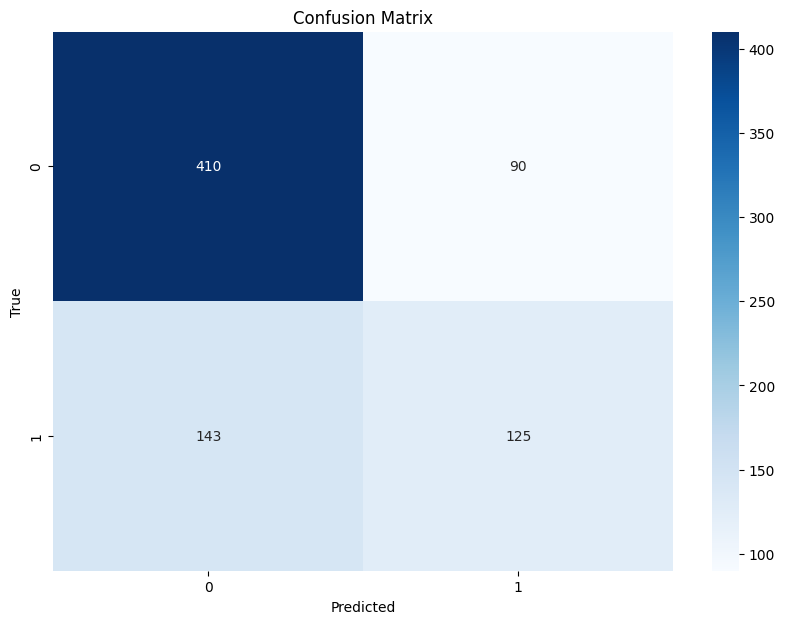

In [47]:
print("Risultati finali per Kmeans - Normalizer con k=4")
ss_final = silhouette_score(X, km_pred_2_clusters, metric="euclidean")
rs_final = rand_score(y, km_pred_2_clusters)
print("Final Silhouette score:", ss_final)
print("Final Rand score:", rs_final)
report = classification_report(y, km_pred_2_clusters, target_names=[str(i) for i in np.unique(y)])
print("Classification Report:")
print(report)


conf_matrix = confusion_matrix(y, km_pred_2_clusters)
plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=np.unique(y), yticklabels=np.unique(y))
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

### Agglomerative Clustering

#### Agglomerative Clustering - StandardScaler

In [48]:
from sklearn.preprocessing import StandardScaler, Normalizer

X_n = df_adj.drop(columns=["Outcome"])
y = df_adj["Outcome"]
 
X = StandardScaler().fit_transform(X_n)

In [49]:
from sklearn.cluster import AgglomerativeClustering
ac = AgglomerativeClustering(n_clusters=2)

ac_pred = ac.fit_predict(X)

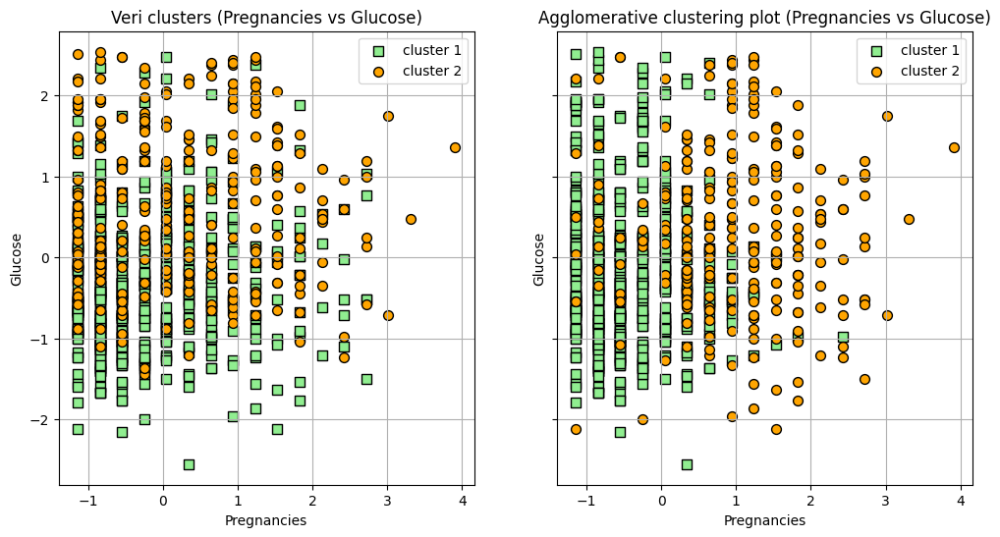

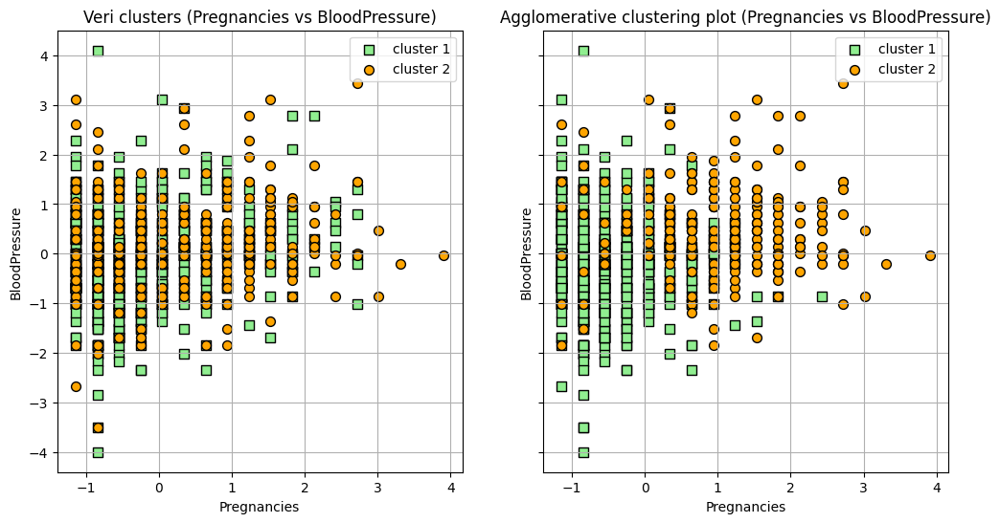

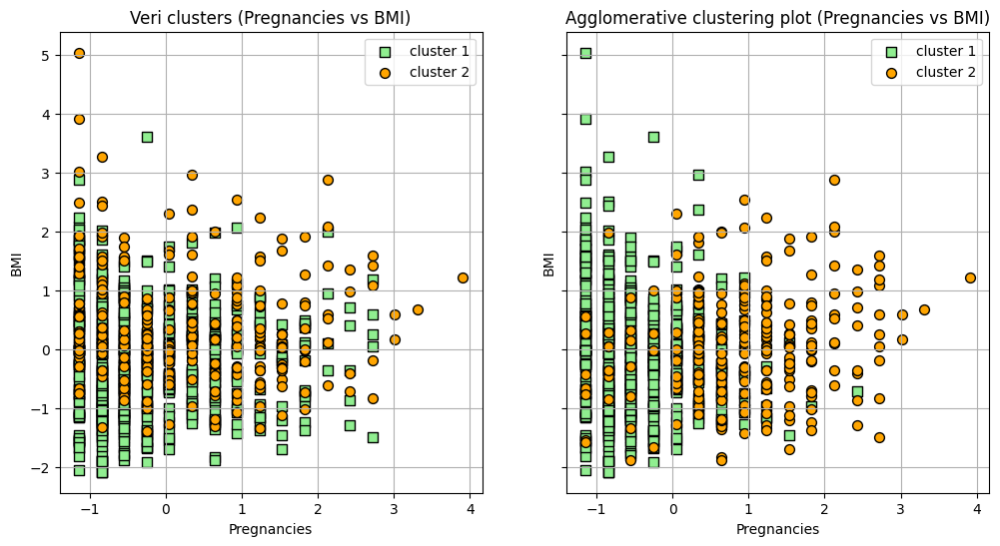

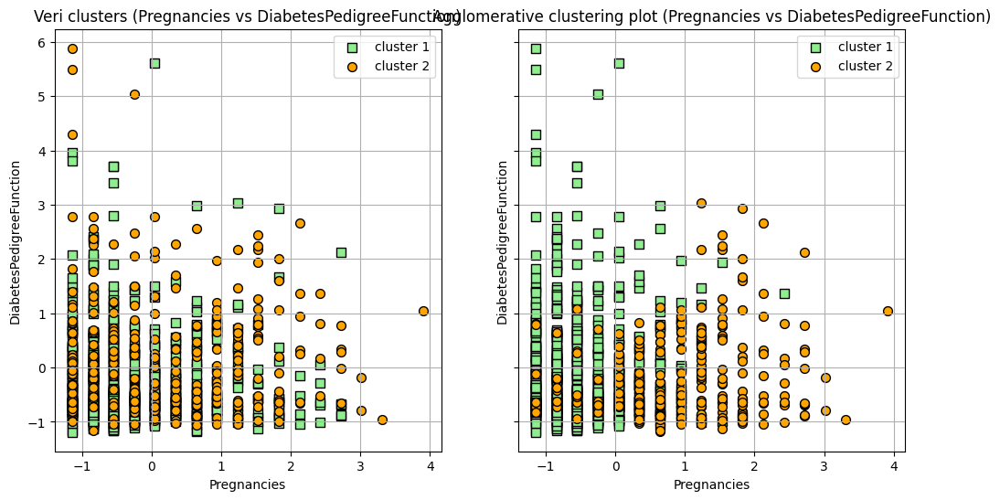

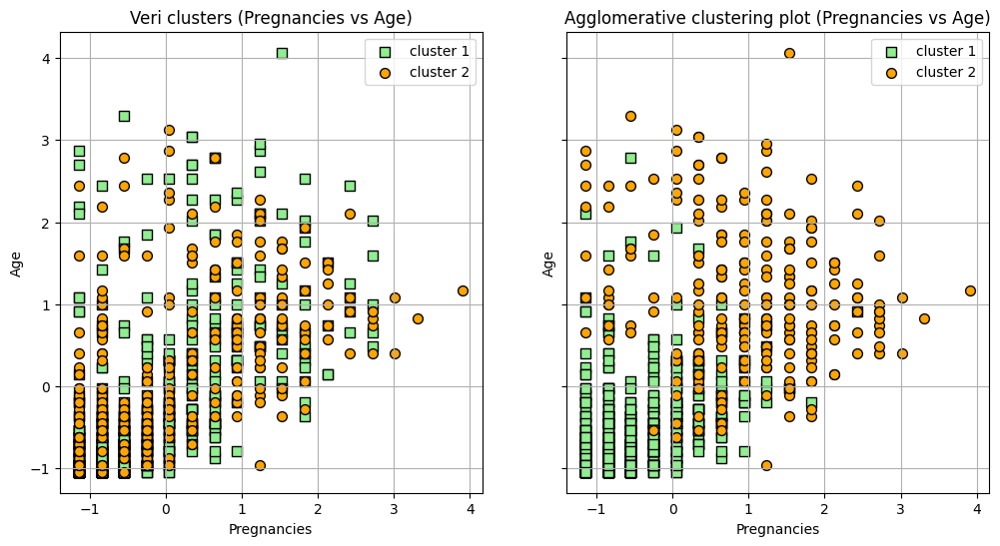

...

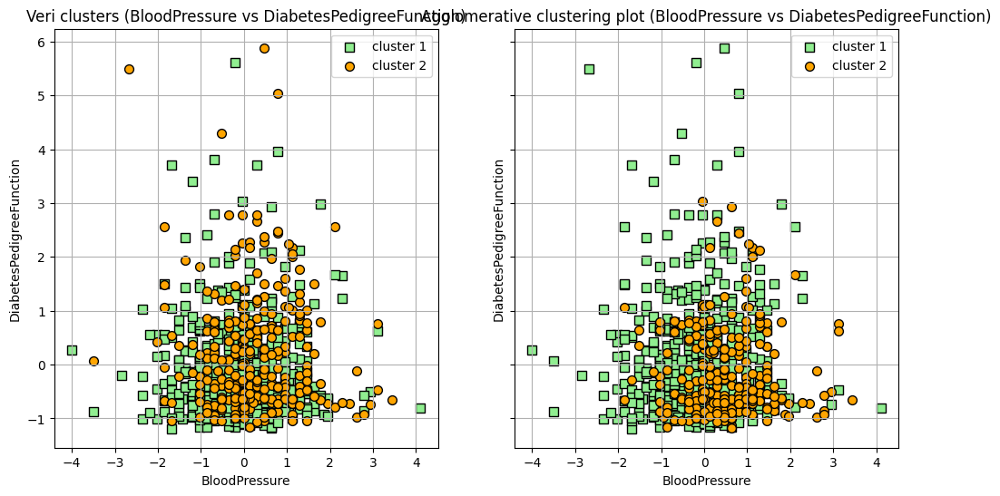

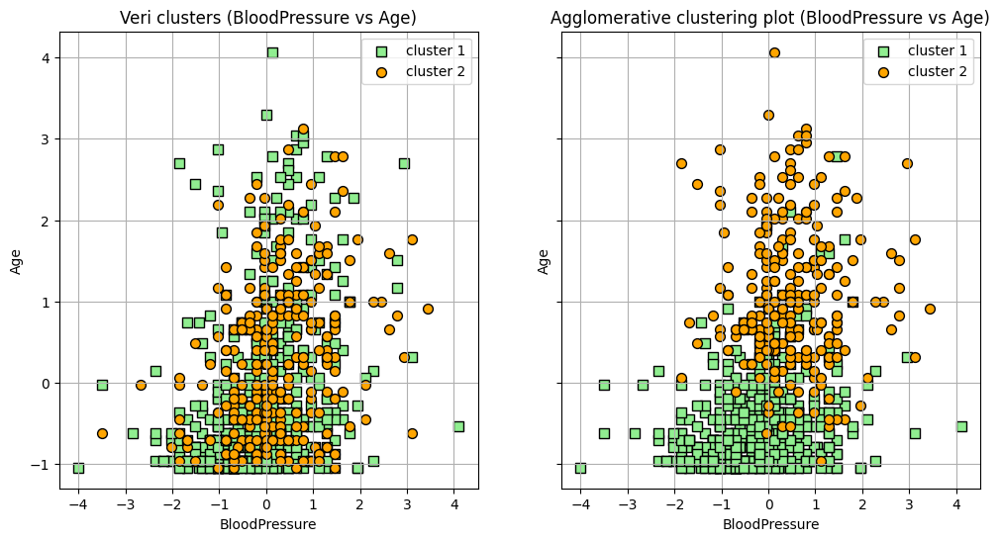

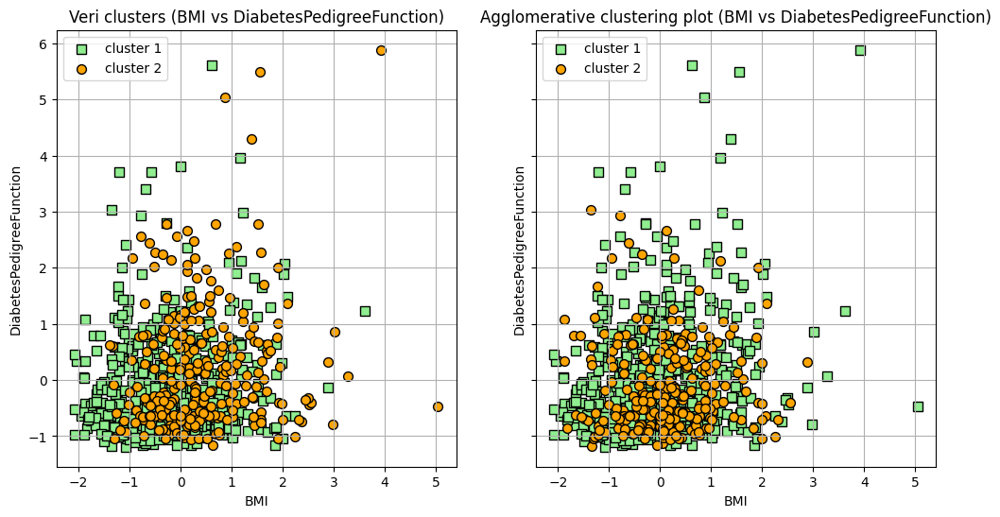

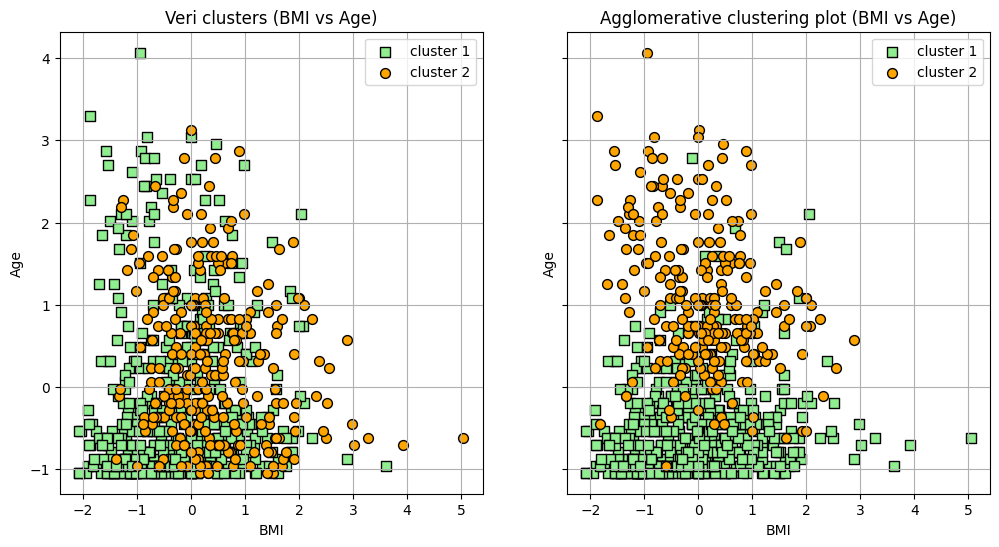

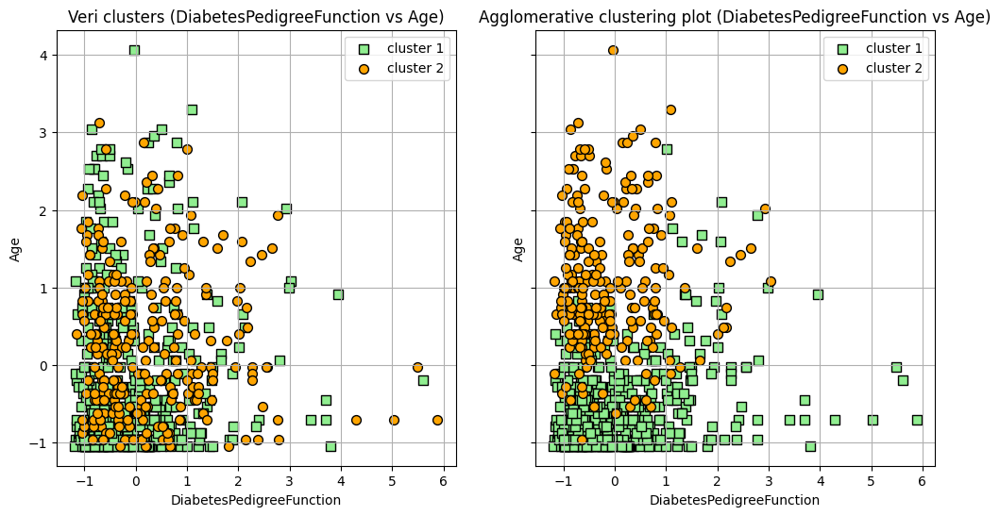

In [50]:
columns = X_n.columns


for i in range(len(columns)):
    for j in range(i + 1, len(columns)):
        col_i = columns[i]
        col_j = columns[j]
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6), sharey=True)
        for label, color, marker in zip([0, 1], ['lightgreen', 'orange'], ['s', 'o']):
            ax1.scatter(X[y == label, i], X[y == label, j],
                        s=50, c=color, marker=marker, edgecolor="black", label=f'cluster {label + 1}')
        ax1.set_title(f"Veri clusters ({col_i} vs {col_j})")
        ax1.set_xlabel(col_i)
        ax1.set_ylabel(col_j)
        ax1.legend(scatterpoints=1)
        ax1.grid()
        ax2.scatter(X[ac_pred == 0, i], X[ac_pred == 0, j],
                    s=50, c='lightgreen', marker='s', edgecolor="black", label='cluster 1')
        ax2.scatter(X[ac_pred == 1, i], X[ac_pred == 1, j],
                    s=50, c='orange', marker='o', edgecolor='black', label='cluster 2')

        ax2.set_title(f"Agglomerative clustering plot ({col_i} vs {col_j})")
        ax2.set_xlabel(col_i)
        ax2.set_ylabel(col_j)
        ax2.legend(scatterpoints=1)
        ax2.grid()

        plt.show()

Risultati finali AgglomerativeClustering - StandardScaler con k=2
Silhouette score: 0.22391970776477735
Rand_score: 0.5532513037809648
Classification Report:
              precision    recall  f1-score   support

           0       0.73      0.76      0.75       500
           1       0.52      0.48      0.50       268

    accuracy                           0.66       768
   macro avg       0.63      0.62      0.62       768
weighted avg       0.66      0.66      0.66       768



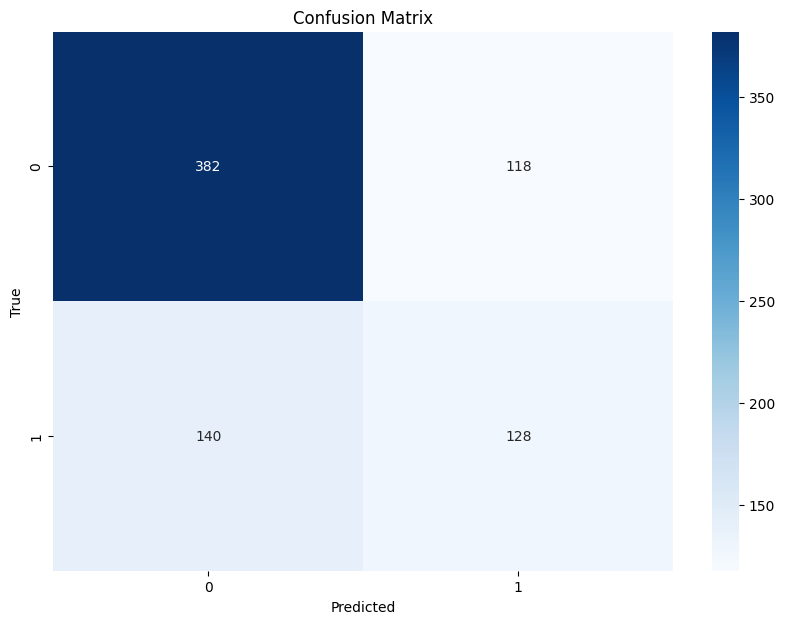

In [51]:
from sklearn.metrics import silhouette_score, rand_score
print("Risultati finali AgglomerativeClustering - StandardScaler con k=2")
ss=silhouette_score(X, ac_pred, metric="euclidean" )
print("Silhouette score:",ss)

ris=rand_score(y,ac_pred)
print("Rand_score:",ris)
report = classification_report(y, ac_pred, target_names=[str(i) for i in np.unique(y)])
print("Classification Report:")
print(report)

conf_matrix = confusion_matrix(y, ac_pred)
plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=np.unique(y), yticklabels=np.unique(y))
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

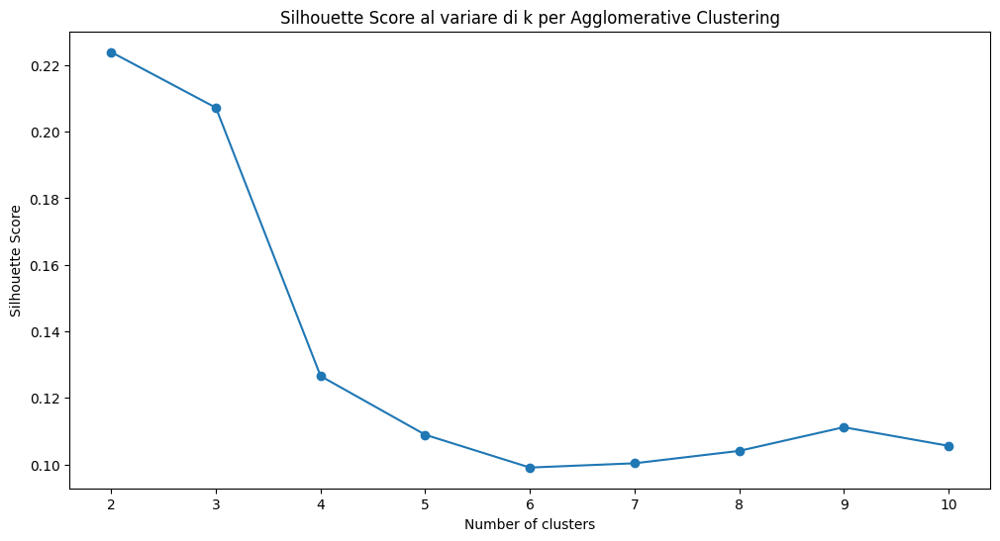

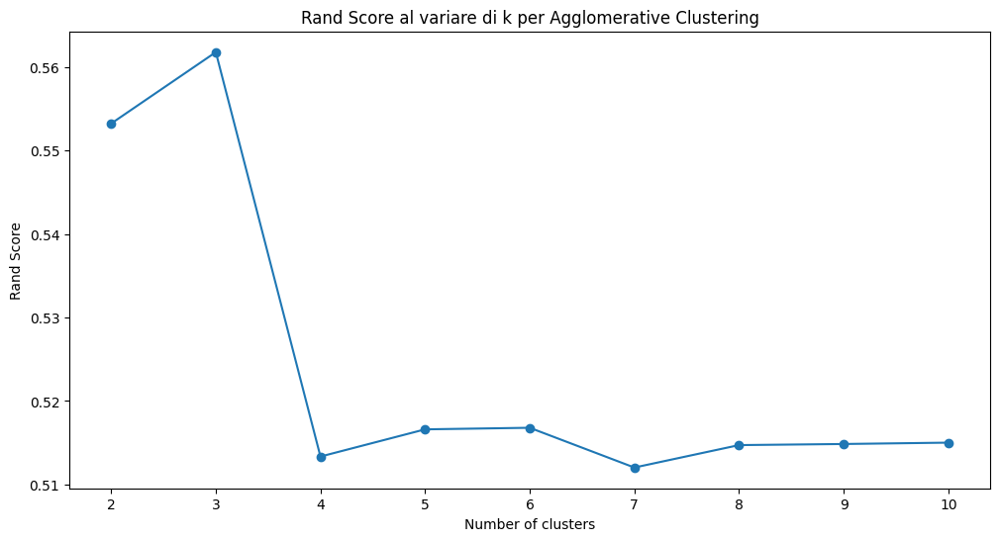

In [52]:
range_n_clusters = range(2, 11)

silhouette_scores = []
rand_scores = []
for n_clusters in range_n_clusters:
    ac = AgglomerativeClustering(n_clusters=n_clusters)
    ac_pred = ac.fit_predict(X)
    
    silhouette = silhouette_score(X,ac_pred, metric="euclidean" )
    silhouette_scores.append(silhouette)
    rand = rand_score(y,ac_pred)
    rand_scores.append(rand)



plt.figure(figsize=(12, 6))
plt.plot(range_n_clusters, silhouette_scores, marker='o')
plt.title('Silhouette Score al variare di k per Agglomerative Clustering')
plt.xlabel('Number of clusters')
plt.ylabel('Silhouette Score')
plt.show()

plt.figure(figsize=(12, 6))
plt.plot(range_n_clusters, rand_scores, marker='o')
plt.title('Rand Score al variare di k per Agglomerative Clustering')
plt.xlabel('Number of clusters')
plt.ylabel('Rand Score')
plt.show()

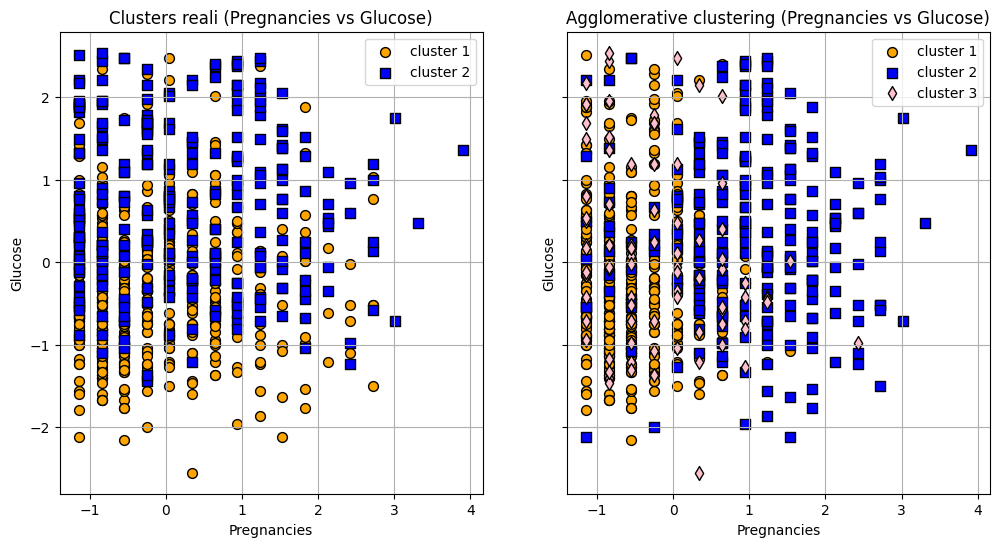

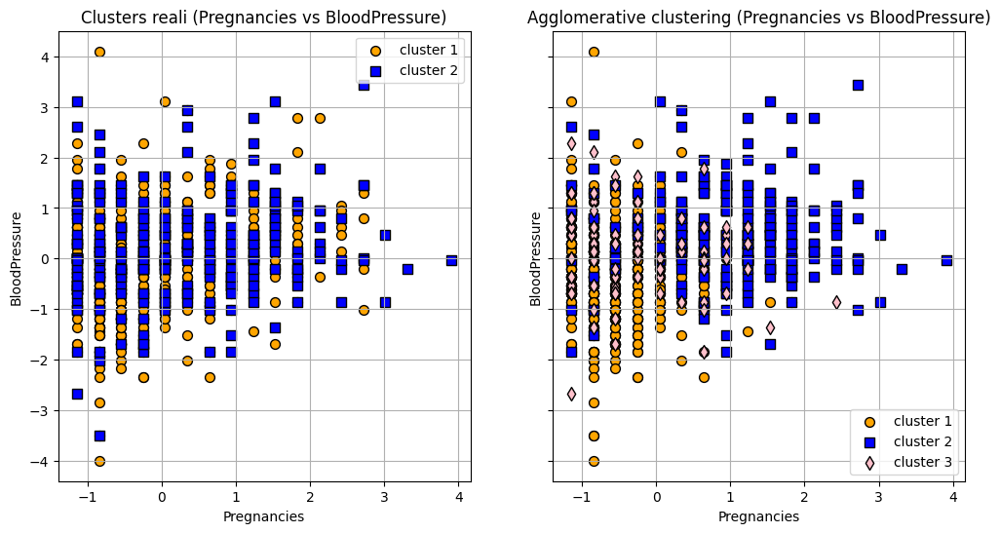

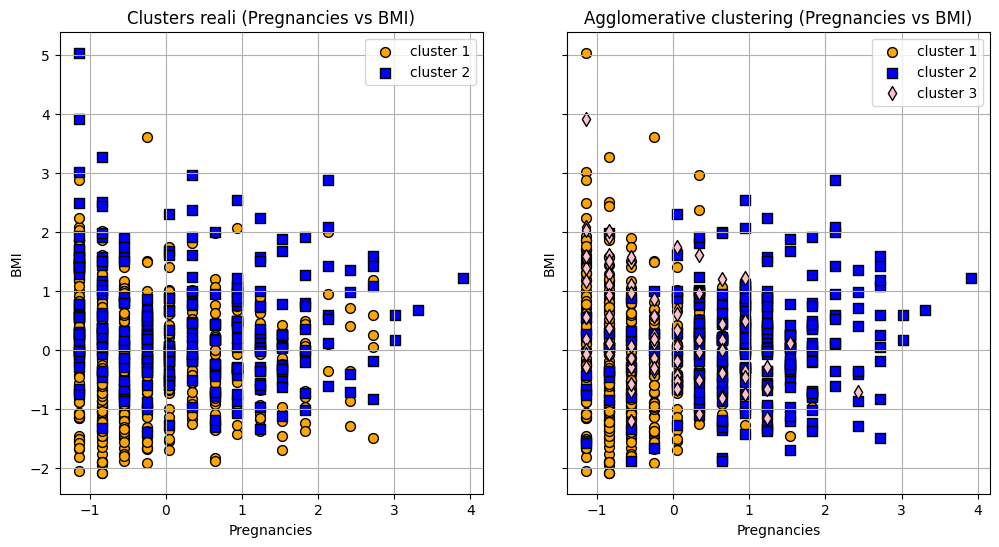

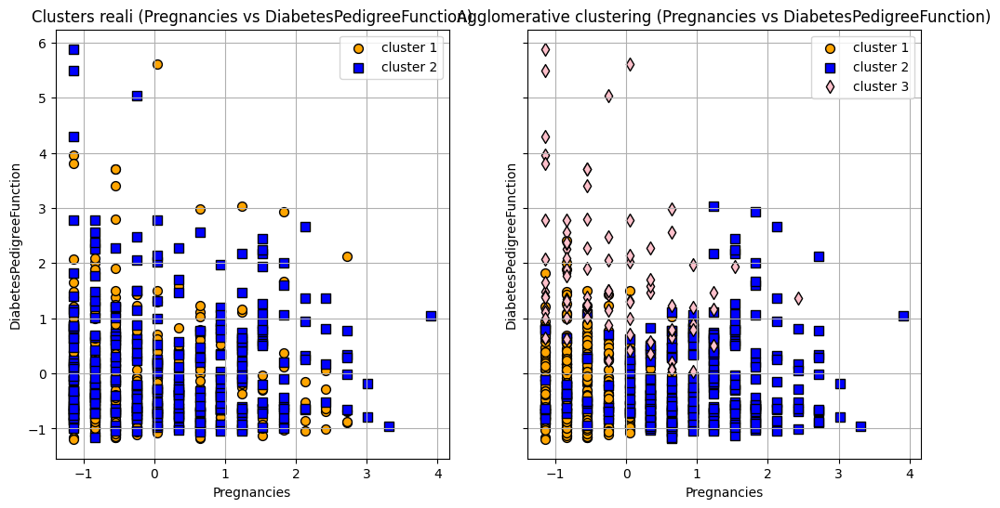

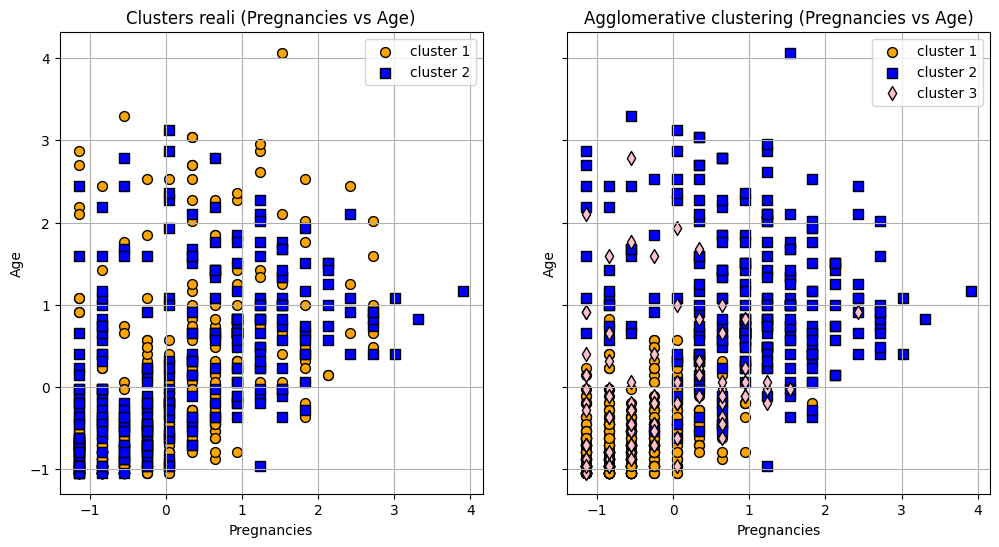

...

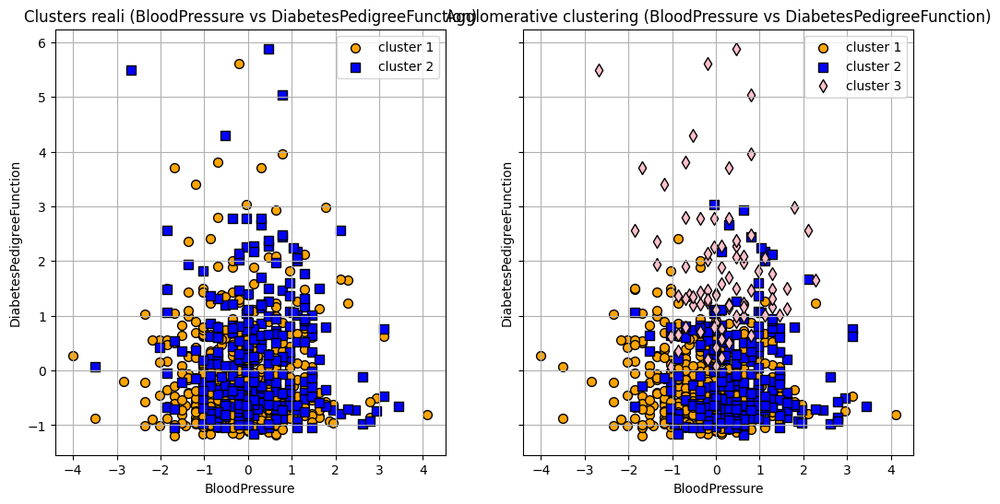

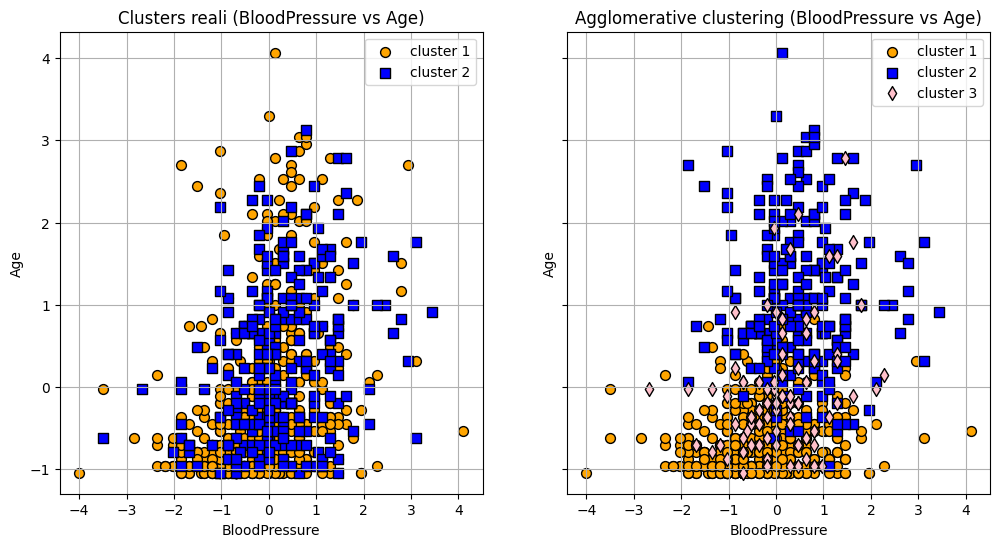

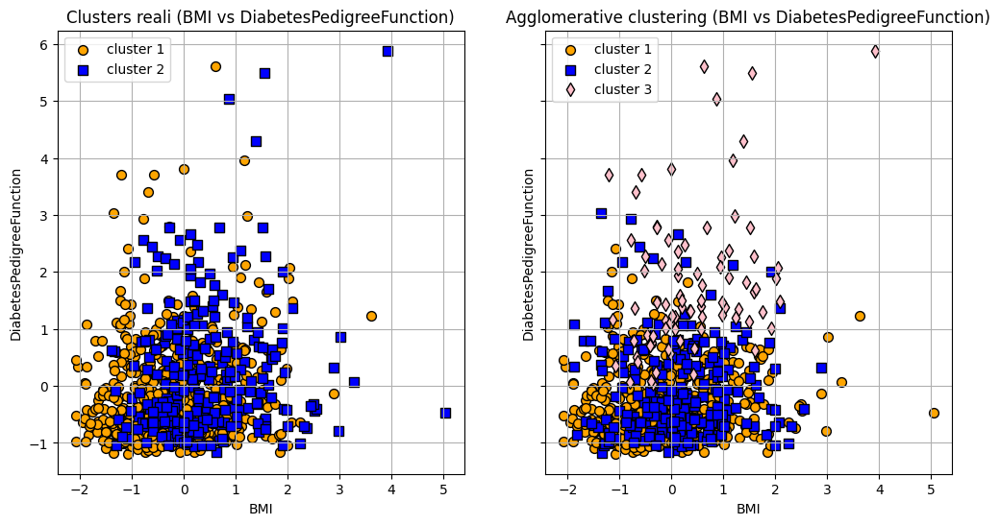

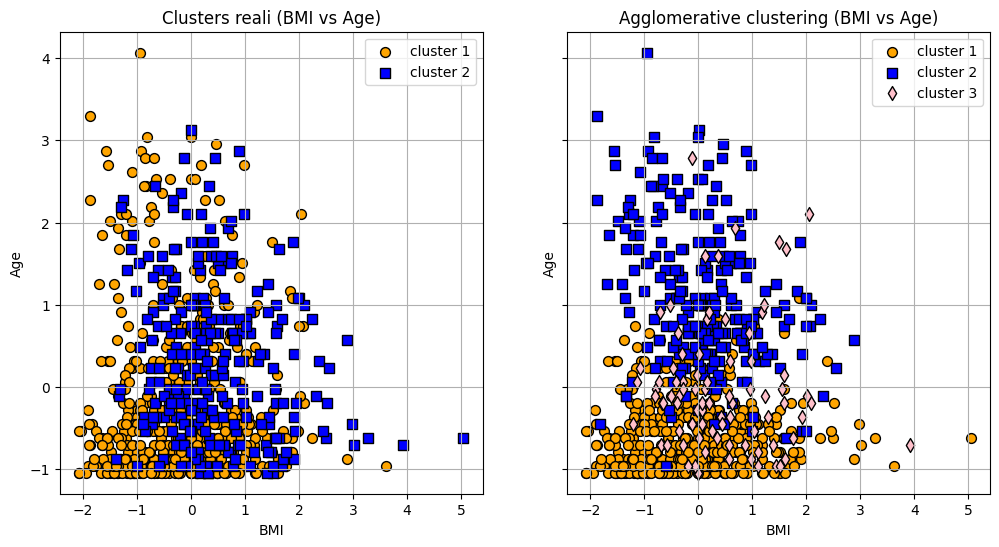

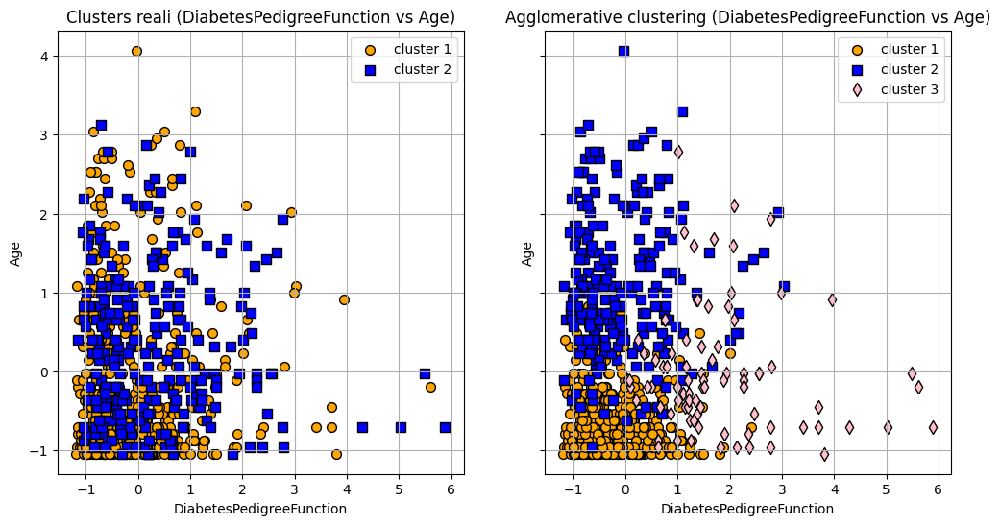

In [53]:
n_clusters = 3

ac = AgglomerativeClustering(n_clusters=n_clusters)
ac_pred = ac.fit_predict(X)
labels = ac.labels_
colors = [ 'orange', 'blue', 'pink', 'cyan']
markers = [ 'o', 's','d', '>']
columns = X_n.columns

for i in range(len(columns)):
    for j in range(i + 1, len(columns)):
        col_i = columns[i]
        col_j = columns[j]
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6), sharey=True)

        for label in np.unique(y):
            ax1.scatter(X[y == label, i], X[y == label, j],
                        s=50, c=colors[label % len(colors)], marker=markers[label % len(markers)],
                        edgecolor="black", label=f'cluster {label + 1}')
        ax1.set_title(f"Clusters reali ({col_i} vs {col_j})")
        ax1.set_xlabel(col_i)
        ax1.set_ylabel(col_j)
        ax1.legend(scatterpoints=1)
        ax1.grid()

        for cluster in range(n_clusters):
            ax2.scatter(X[ac_pred == cluster, i], X[ac_pred == cluster, j],
                        s=50, c=colors[cluster % len(colors)], marker=markers[cluster % len(markers)],
                        edgecolor="black", label=f'cluster {cluster + 1}')


        ax2.set_title(f"Agglomerative clustering ({col_i} vs {col_j})")
        ax2.set_xlabel(col_i)
        ax2.set_ylabel(col_j)
        ax2.legend(scatterpoints=1)
        ax2.grid()

        plt.show()

In [54]:
print("Risultati intermedi AgglomerativeCluster - StandardScaler con k=3")
from sklearn.metrics import silhouette_score, rand_score
ss=silhouette_score(X, ac_pred, metric="euclidean" )
print("Silhouette score:",ss)

ris=rand_score(y,ac_pred)
print("Rand_score:",ris)

df_clusters = pd.DataFrame({'Cluster': ac_pred, 'Classe': y})
cluster_percentages=df_clusters.groupby('Cluster')['Classe'].value_counts(normalize=True).unstack() * 100
cluster_info = cluster_percentages.copy()
cluster_info['Osservazioni'] = df_clusters['Cluster'].value_counts().sort_index()

print("Informazioni sui cluster:")
print(cluster_info)

Risultati intermedi AgglomerativeCluster - StandardScaler con k=3
Silhouette score: 0.20721406894732108
Rand_score: 0.5618073663624511
Informazioni sui cluster:
Classe           0          1  Osservazioni
Cluster                                    
0        78.767123  21.232877           438
1        47.967480  52.032520           246
2        44.047619  55.952381            84


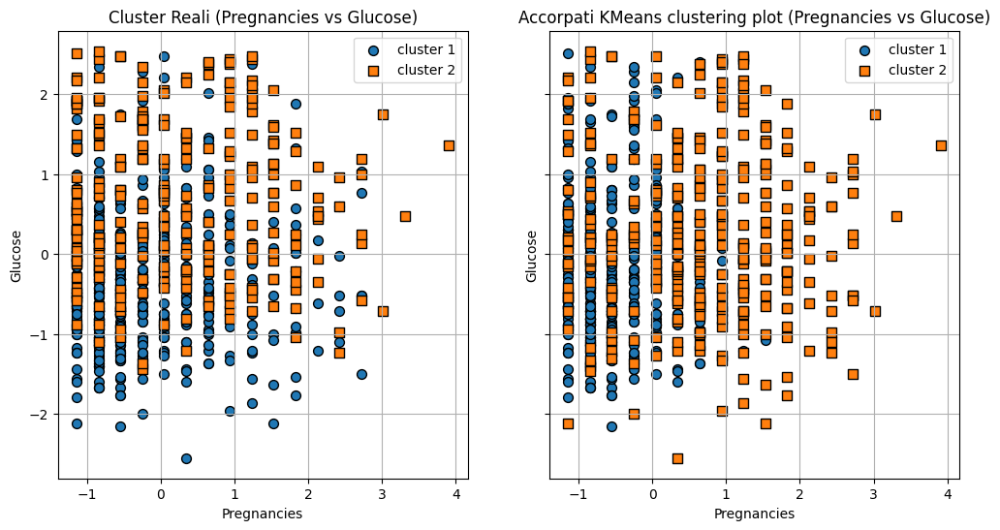

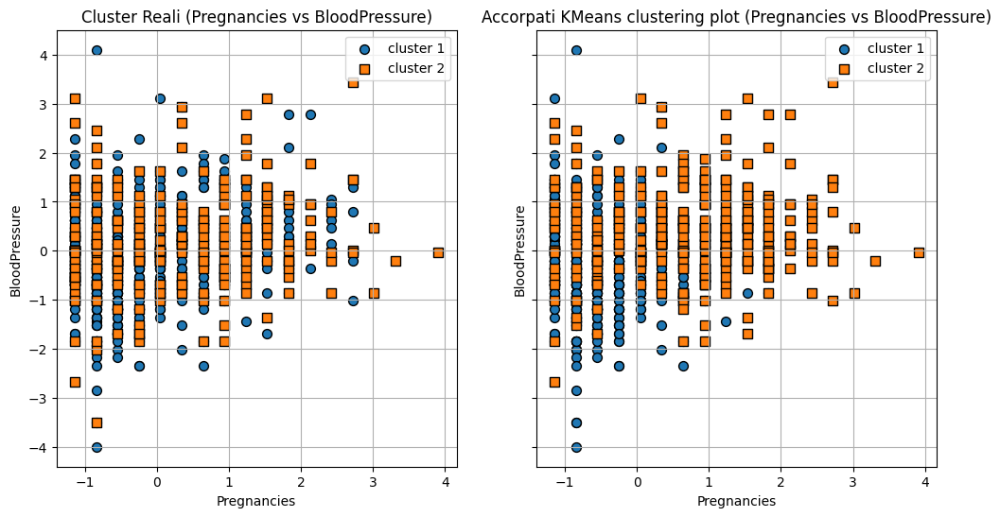

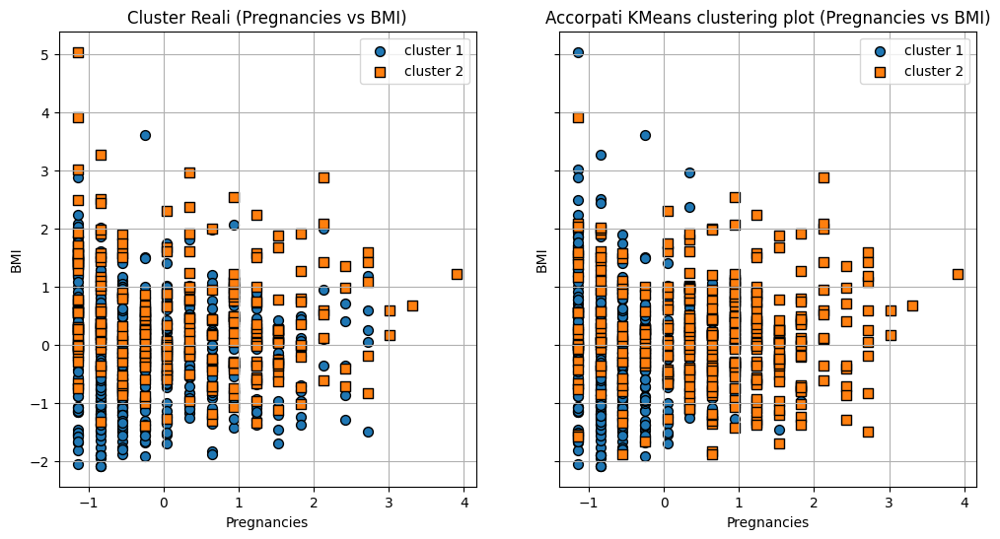

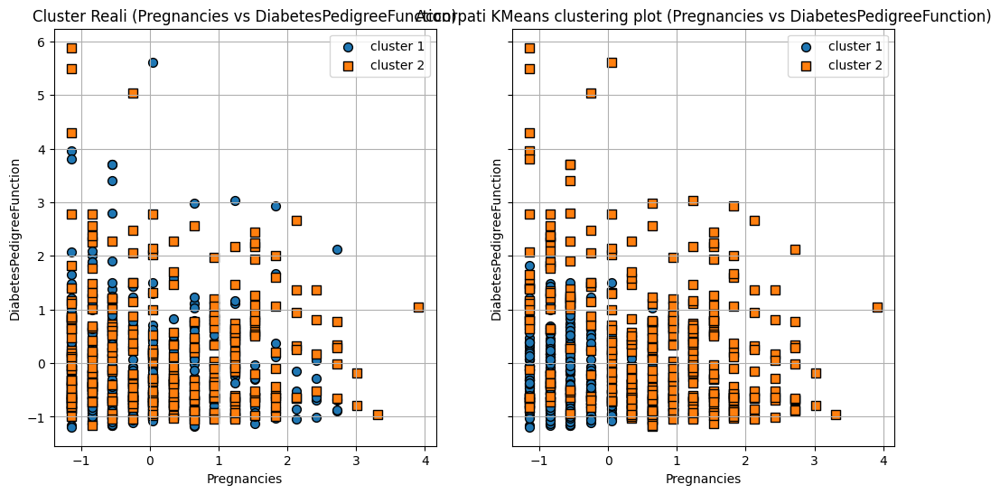

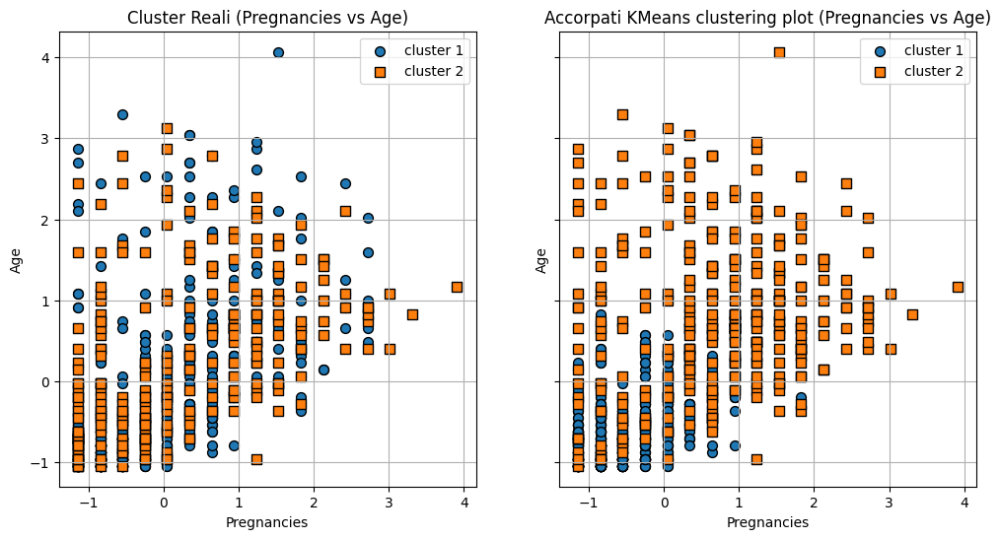

...

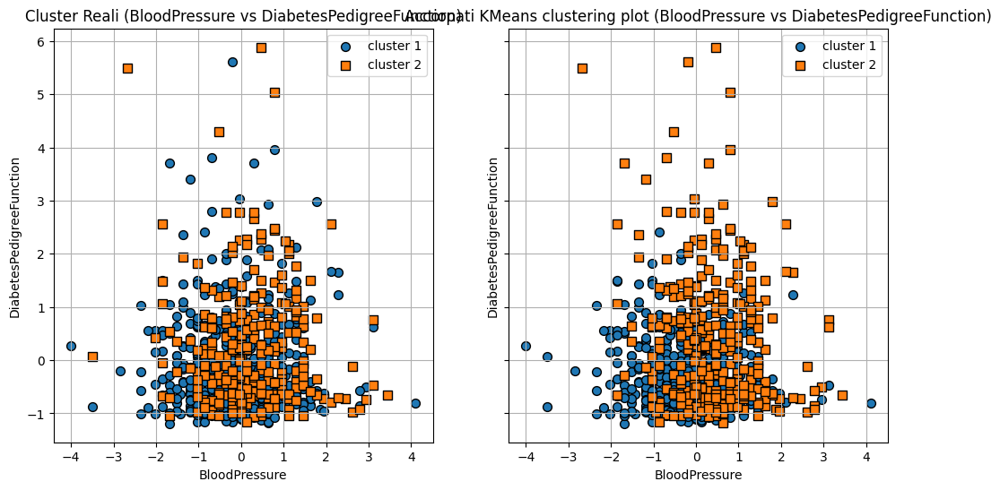

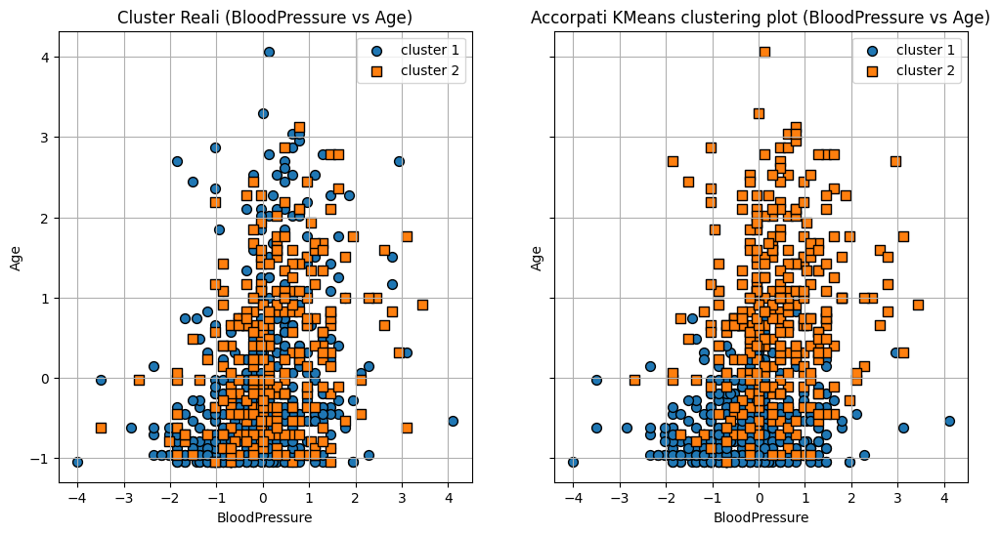

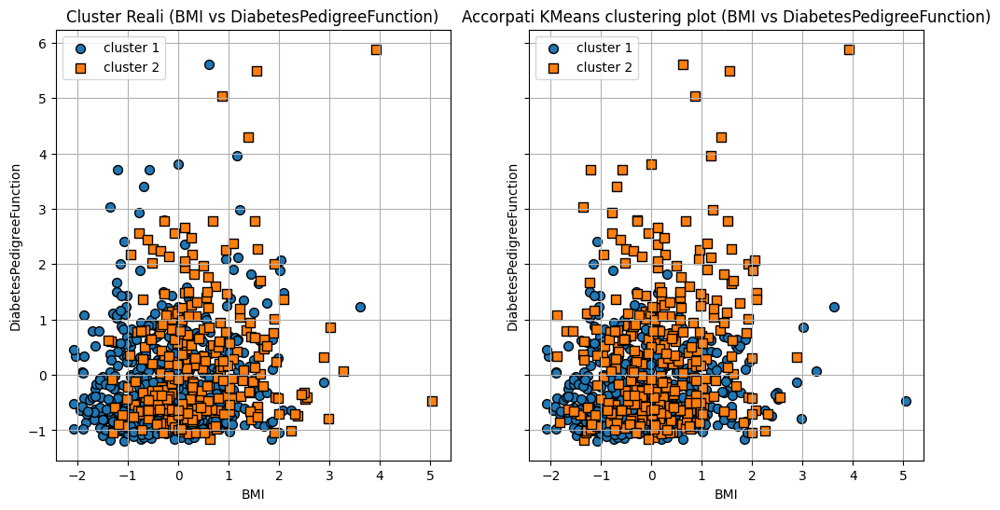

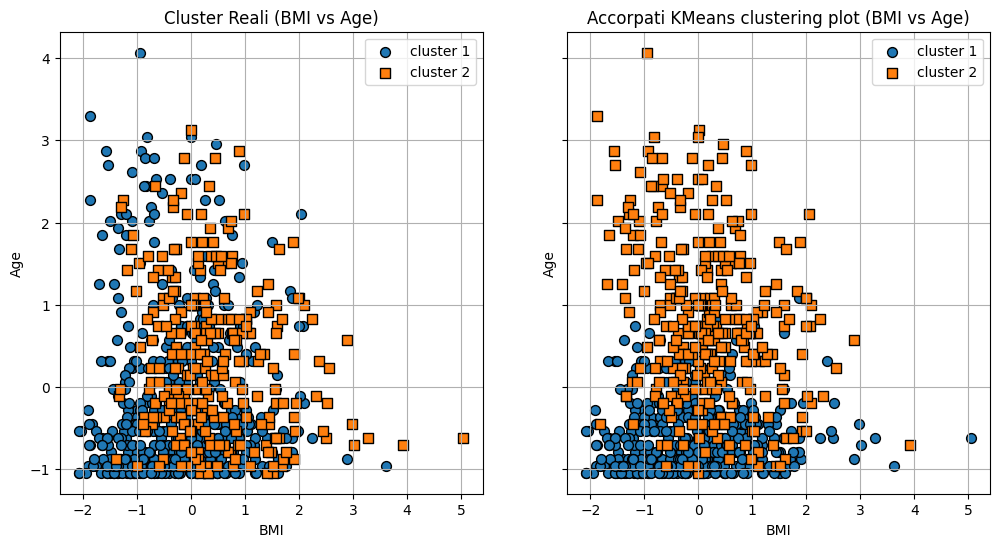

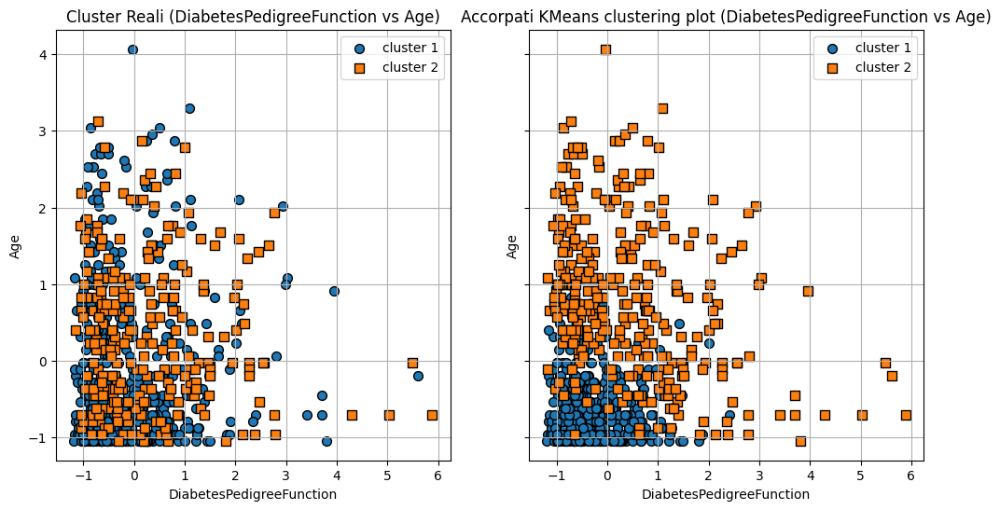

In [55]:
cluster_0 = cluster_percentages[cluster_percentages[0] >= 50].index.tolist()
cluster_1 = cluster_percentages[cluster_percentages[1] > 50].index.tolist()

ac_pred_2_clusters = ac_pred.copy()
for cluster in cluster_0:
    ac_pred_2_clusters[ac_pred == cluster] = 0
for cluster in cluster_1:
    ac_pred_2_clusters[ac_pred == cluster] = 1

columns = X_n.columns

for i in range(len(columns)):
    for j in range(i + 1, len(columns)):
        col_i = columns[i]
        col_j = columns[j]
        
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6), sharey=True)

        for label in np.unique(y):
            ax1.scatter(X[y == label, i], X[y == label, j],
                        s=50, edgecolor="black", label=f'cluster {label + 1}',marker=markers[label % len(markers)])
        ax1.set_title(f"Cluster Reali ({col_i} vs {col_j})")
        ax1.set_xlabel(col_i)
        ax1.set_ylabel(col_j)
        ax1.legend(scatterpoints=1)
        ax1.grid()

        for cluster in range(2): 
            ax2.scatter(X[ac_pred_2_clusters == cluster, i], X[ac_pred_2_clusters == cluster, j],
                        s=50, edgecolor="black", label=f'cluster {cluster + 1}', marker=markers[cluster % len(markers)])
        
        ax2.set_title(f"Accorpati KMeans clustering plot ({col_i} vs {col_j})")
        ax2.set_xlabel(col_i)
        ax2.set_ylabel(col_j)
        ax2.legend(scatterpoints=1)
        ax2.grid()

        plt.show()

Risultati finali per AgglomerativeCluster - StandardScaler con k=3
Final Silhouette score: 0.20823799002924437
Final Rand score: 0.5621468926553672
Classification Report:
              precision    recall  f1-score   support

           0       0.79      0.69      0.74       500
           1       0.53      0.65      0.59       268

    accuracy                           0.68       768
   macro avg       0.66      0.67      0.66       768
weighted avg       0.70      0.68      0.68       768



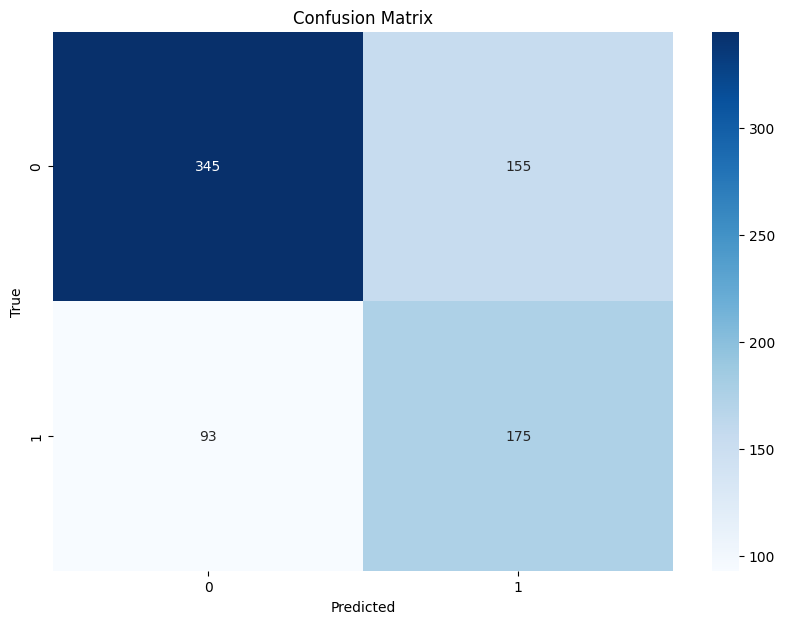

In [56]:
print("Risultati finali per AgglomerativeCluster - StandardScaler con k=3")
ss_final = silhouette_score(X, ac_pred_2_clusters, metric="euclidean")
rs_final = rand_score(y, ac_pred_2_clusters)
print("Final Silhouette score:", ss_final)
print("Final Rand score:", rs_final)
report = classification_report(y, ac_pred_2_clusters, target_names=[str(i) for i in np.unique(y)])
print("Classification Report:")
print(report)

conf_matrix = confusion_matrix(y, ac_pred_2_clusters)
plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=np.unique(y), yticklabels=np.unique(y))
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

#### Agglomerative Clustering - Normalizer

In [57]:
from sklearn.preprocessing import StandardScaler, Normalizer

X_n = df_adj.drop(columns=["Outcome"])
y = df_adj["Outcome"]
 
X = Normalizer().fit_transform(X_n)

In [58]:
from sklearn.cluster import AgglomerativeClustering
ac = AgglomerativeClustering(n_clusters=2)

ac_pred = ac.fit_predict(X)

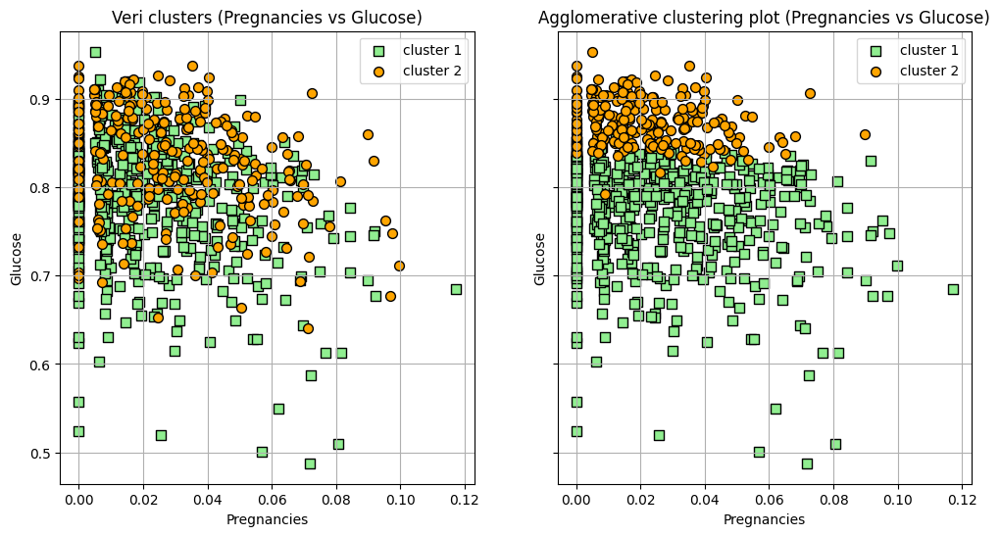

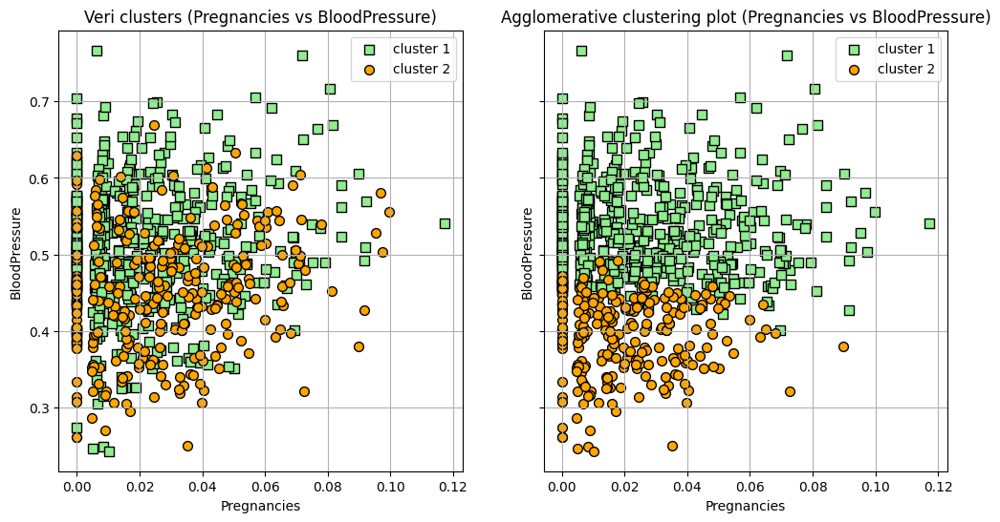

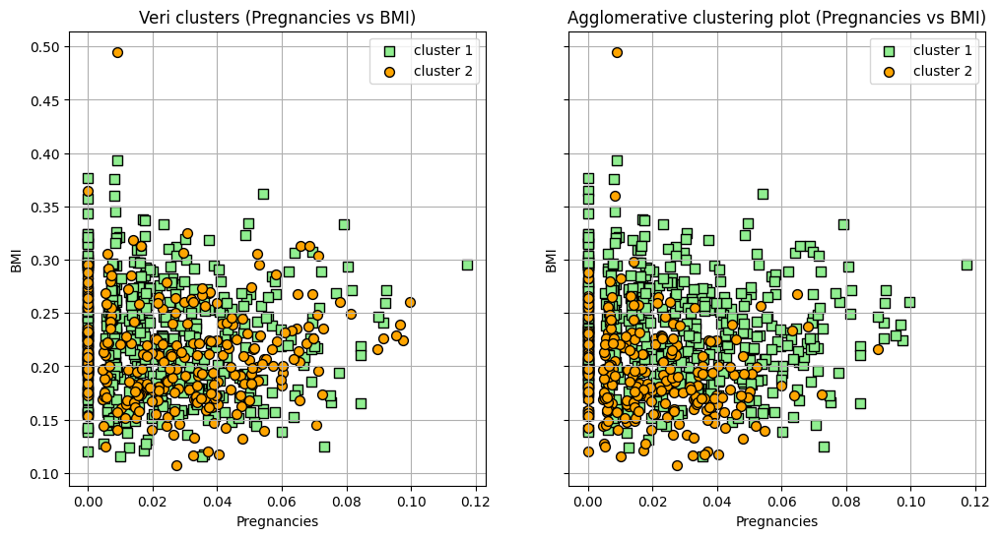

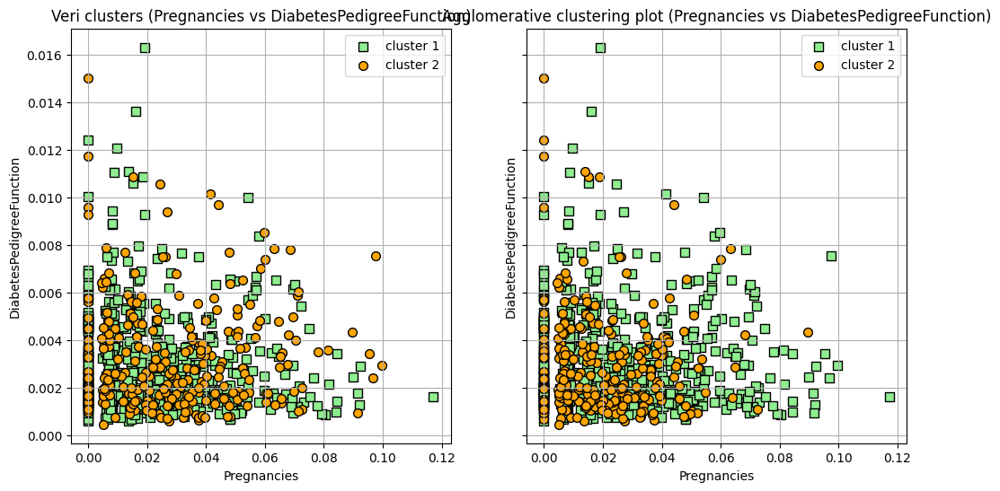

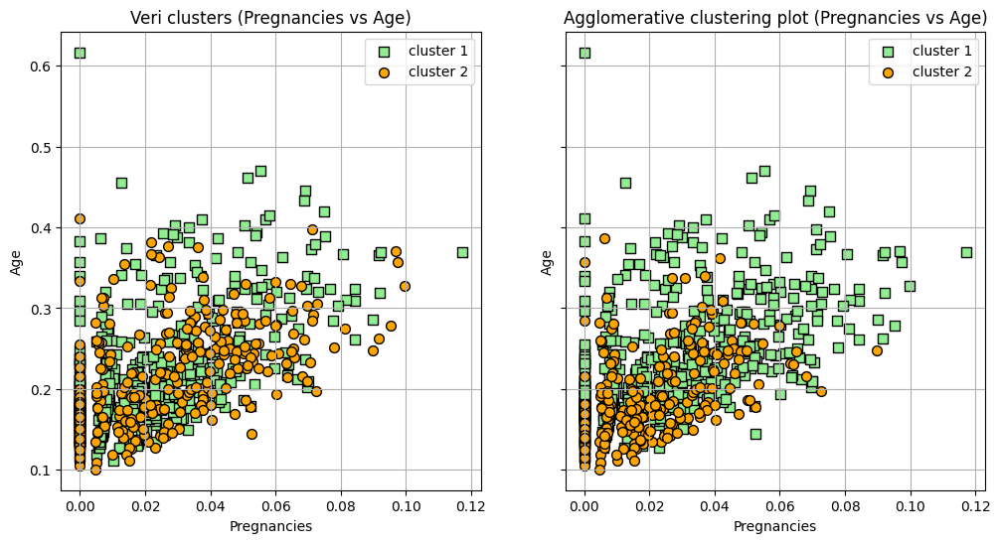

...

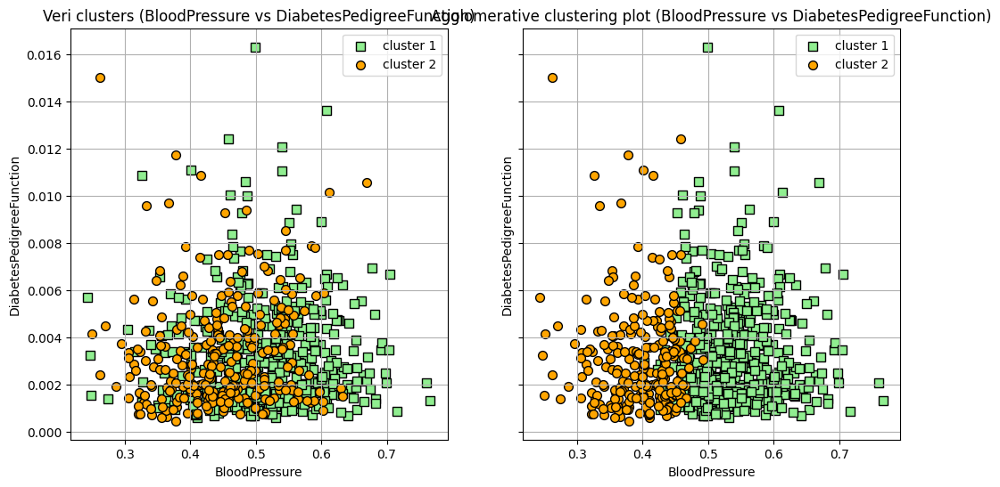

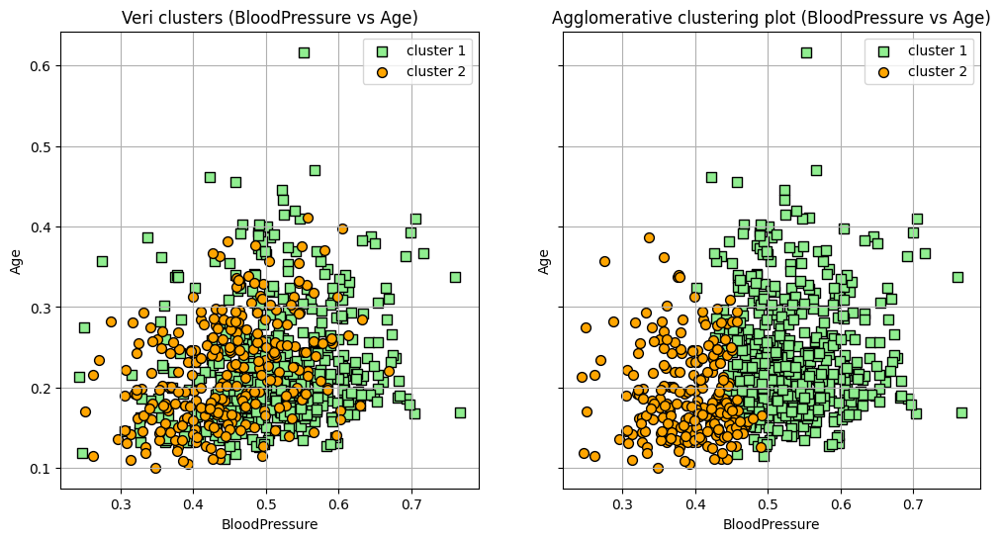

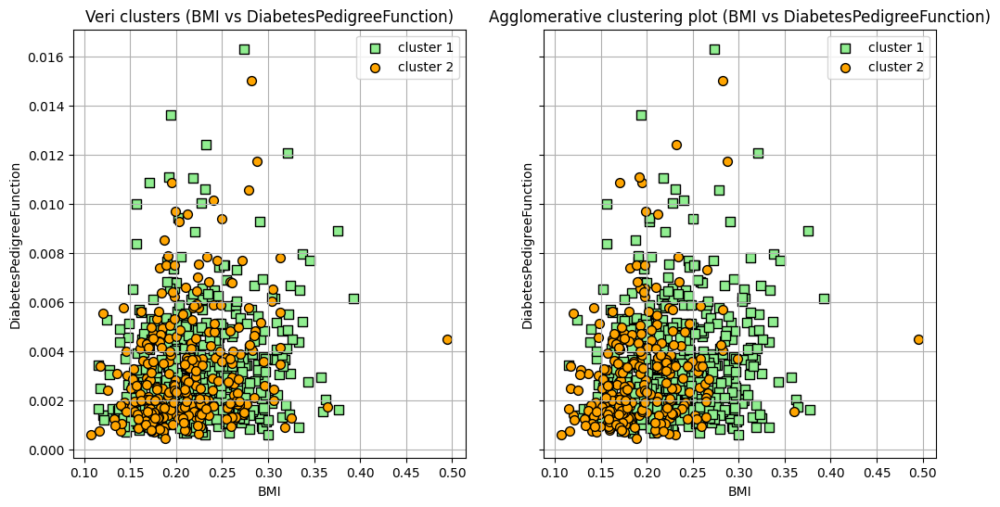

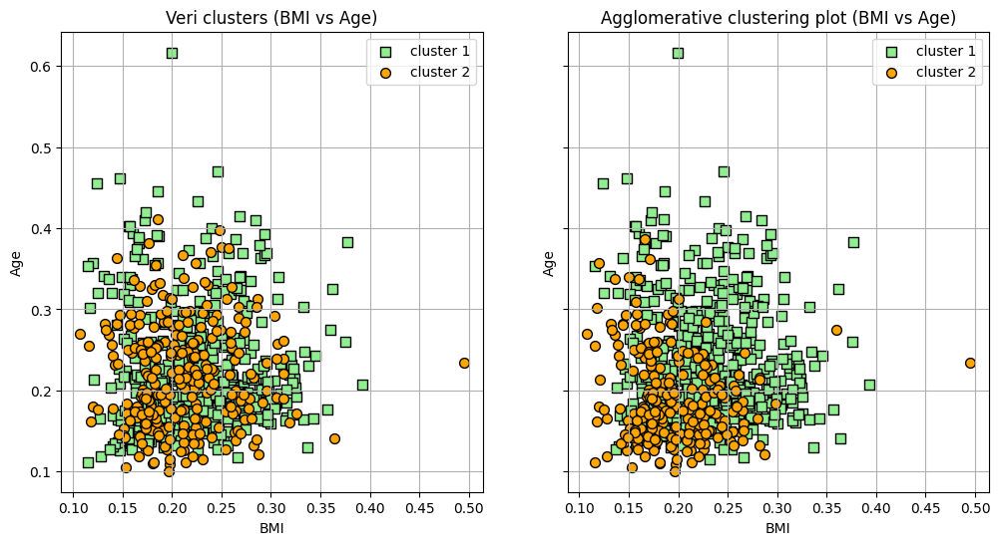

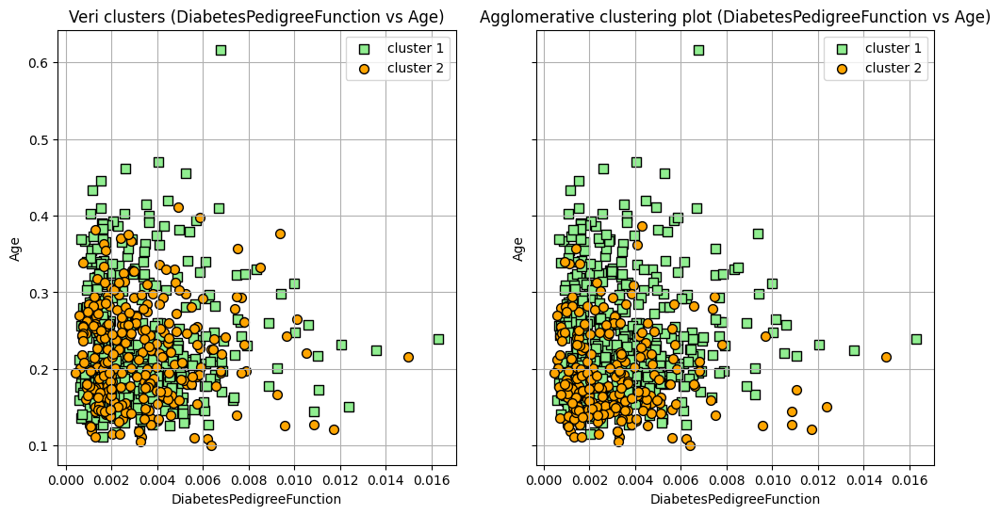

In [59]:
columns = X_n.columns


for i in range(len(columns)):
    for j in range(i + 1, len(columns)):
        col_i = columns[i]
        col_j = columns[j]
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6), sharey=True)
        for label, color, marker in zip([0, 1], ['lightgreen', 'orange'], ['s', 'o']):
            ax1.scatter(X[y == label, i], X[y == label, j],
                        s=50, c=color, marker=marker, edgecolor="black", label=f'cluster {label + 1}')
        ax1.set_title(f"Veri clusters ({col_i} vs {col_j})")
        ax1.set_xlabel(col_i)
        ax1.set_ylabel(col_j)
        ax1.legend(scatterpoints=1)
        ax1.grid()
        ax2.scatter(X[ac_pred == 0, i], X[ac_pred == 0, j],
                    s=50, c='lightgreen', marker='s', edgecolor="black", label='cluster 1')
        ax2.scatter(X[ac_pred == 1, i], X[ac_pred == 1, j],
                    s=50, c='orange', marker='o', edgecolor='black', label='cluster 2')

        ax2.set_title(f"Agglomerative clustering plot ({col_i} vs {col_j})")
        ax2.set_xlabel(col_i)
        ax2.set_ylabel(col_j)
        ax2.legend(scatterpoints=1)
        ax2.grid()

        plt.show()

Risultati finali AgglomerativeClustering - Normalizer con k=2
Silhouette score: 0.31454836219183807
Rand_score: 0.5640074967405476
Classification Report:
              precision    recall  f1-score   support

           0       0.74      0.78      0.76       500
           1       0.55      0.49      0.52       268

    accuracy                           0.68       768
   macro avg       0.64      0.64      0.64       768
weighted avg       0.67      0.68      0.68       768



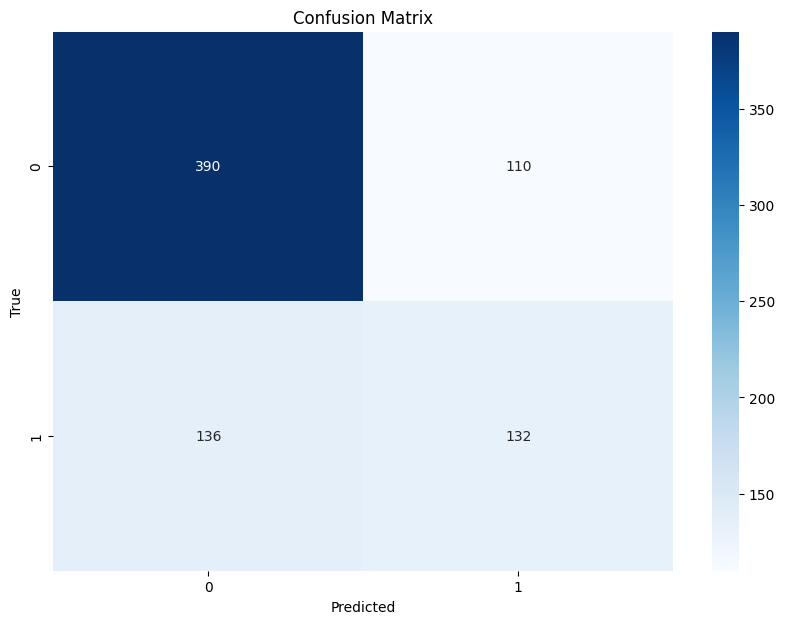

In [60]:
from sklearn.metrics import silhouette_score, rand_score
print("Risultati finali AgglomerativeClustering - Normalizer con k=2")
ss=silhouette_score(X, ac_pred, metric="euclidean" )
print("Silhouette score:",ss)

ris=rand_score(y,ac_pred)
print("Rand_score:",ris)
report = classification_report(y, ac_pred, target_names=[str(i) for i in np.unique(y)])
print("Classification Report:")
print(report)

conf_matrix = confusion_matrix(y, ac_pred)
plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=np.unique(y), yticklabels=np.unique(y))
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

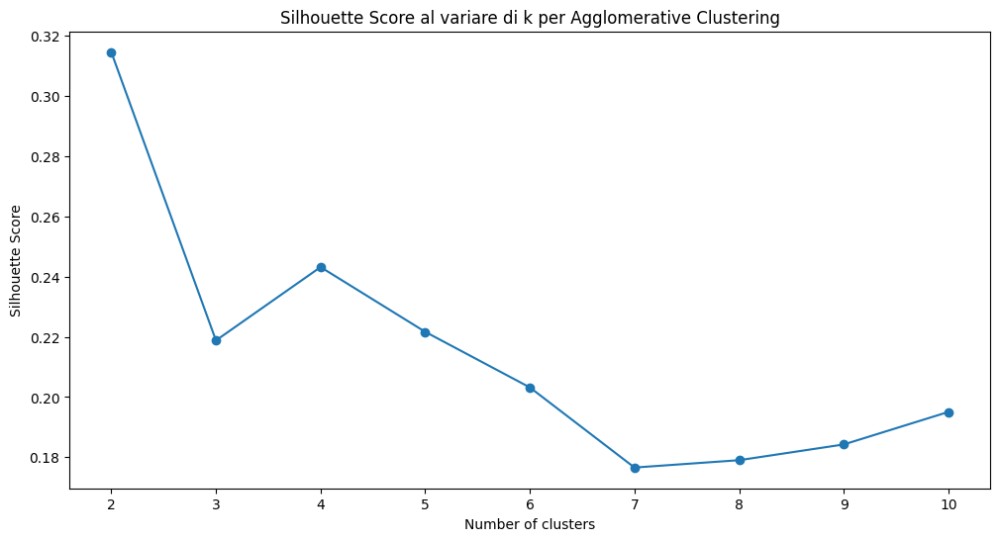

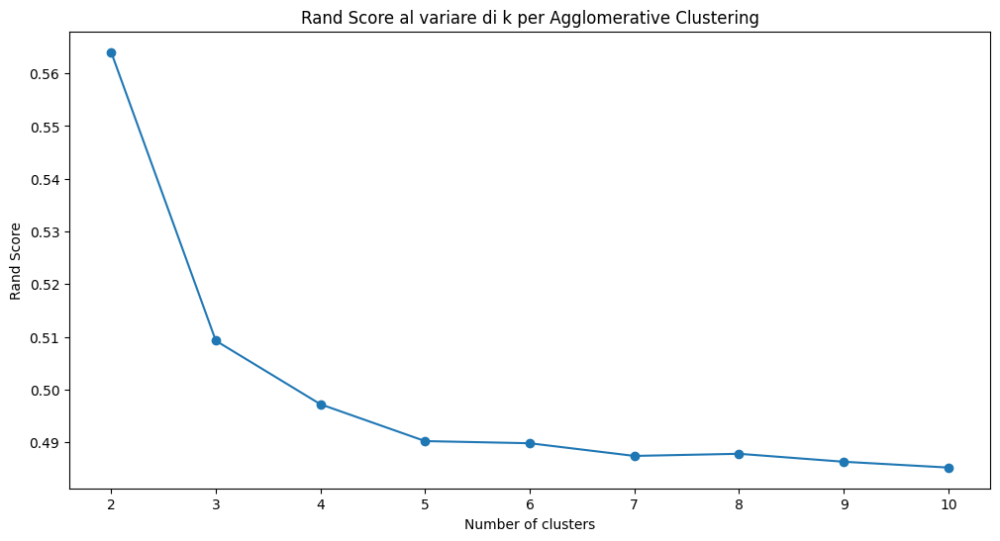

In [61]:
range_n_clusters = range(2, 11)

silhouette_scores = []
rand_scores = []
for n_clusters in range_n_clusters:
    ac = AgglomerativeClustering(n_clusters=n_clusters)
    ac_pred = ac.fit_predict(X)
    
    silhouette = silhouette_score(X,ac_pred, metric="euclidean" )
    silhouette_scores.append(silhouette)
    rand = rand_score(y,ac_pred)
    rand_scores.append(rand)



plt.figure(figsize=(12, 6))
plt.plot(range_n_clusters, silhouette_scores, marker='o')
plt.title('Silhouette Score al variare di k per Agglomerative Clustering')
plt.xlabel('Number of clusters')
plt.ylabel('Silhouette Score')
plt.show()

plt.figure(figsize=(12, 6))
plt.plot(range_n_clusters, rand_scores, marker='o')
plt.title('Rand Score al variare di k per Agglomerative Clustering')
plt.xlabel('Number of clusters')
plt.ylabel('Rand Score')
plt.show()

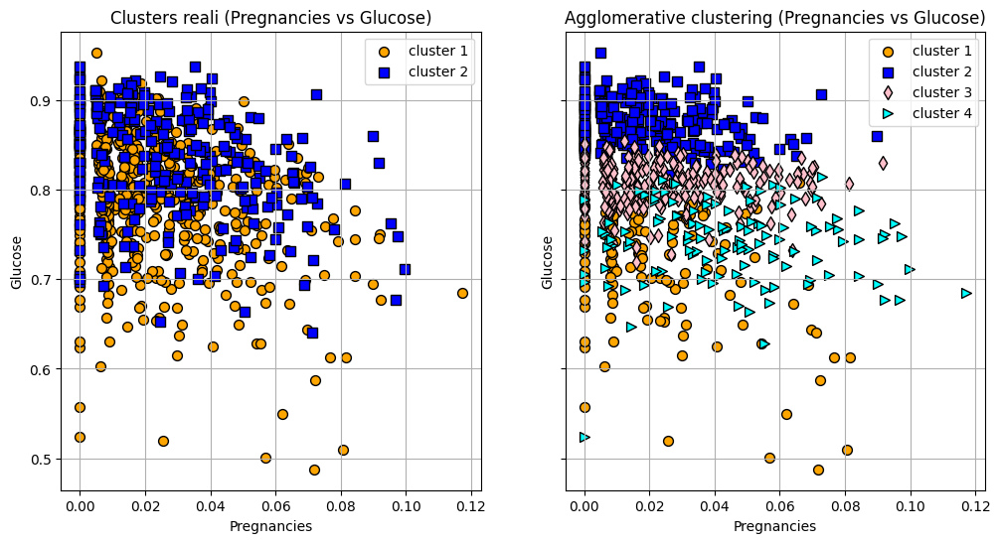

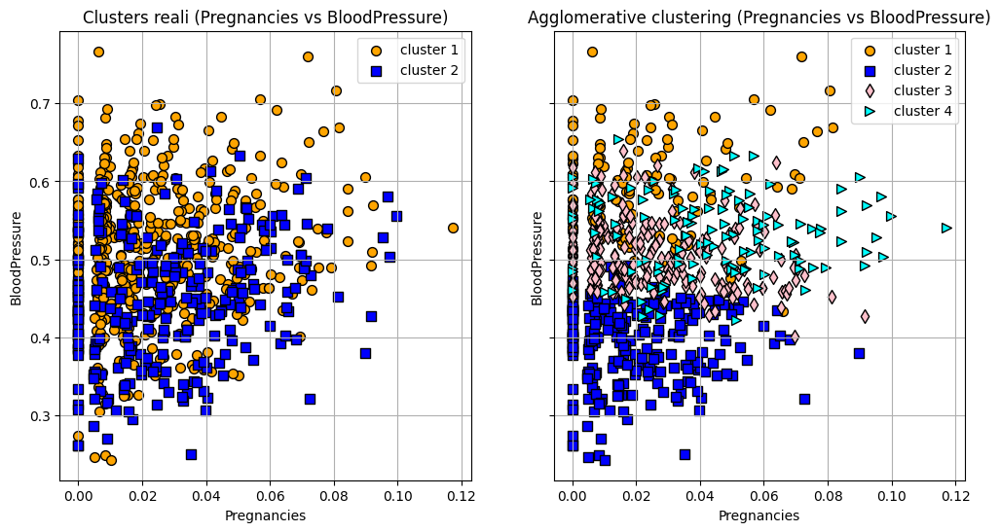

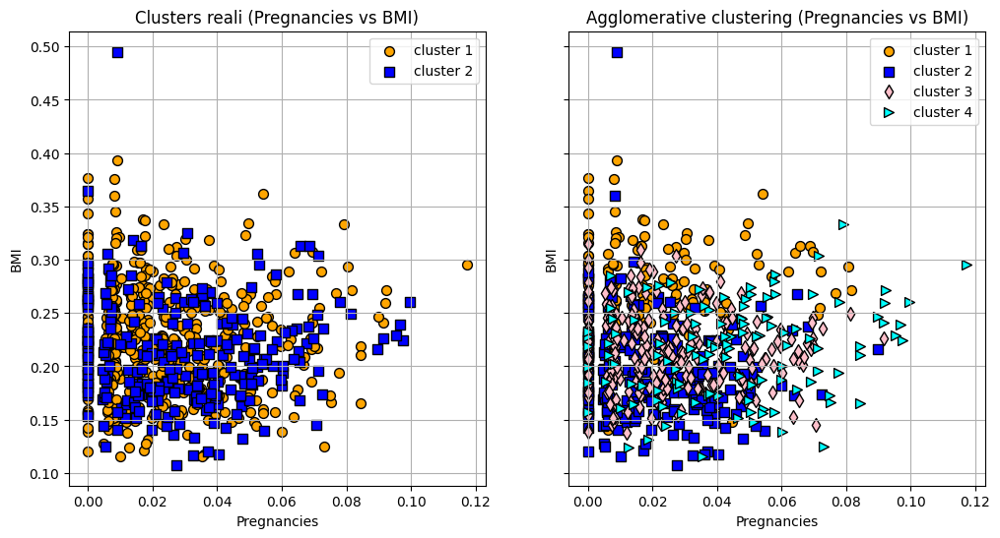

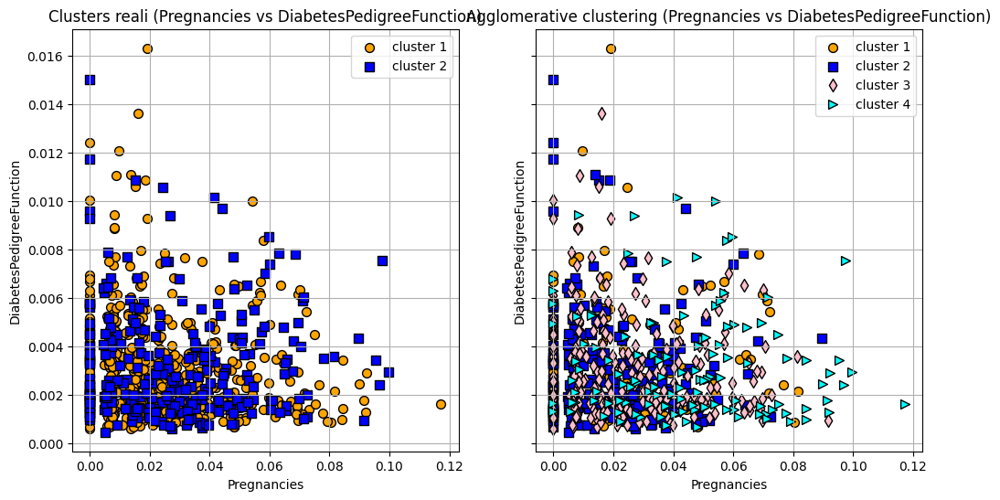

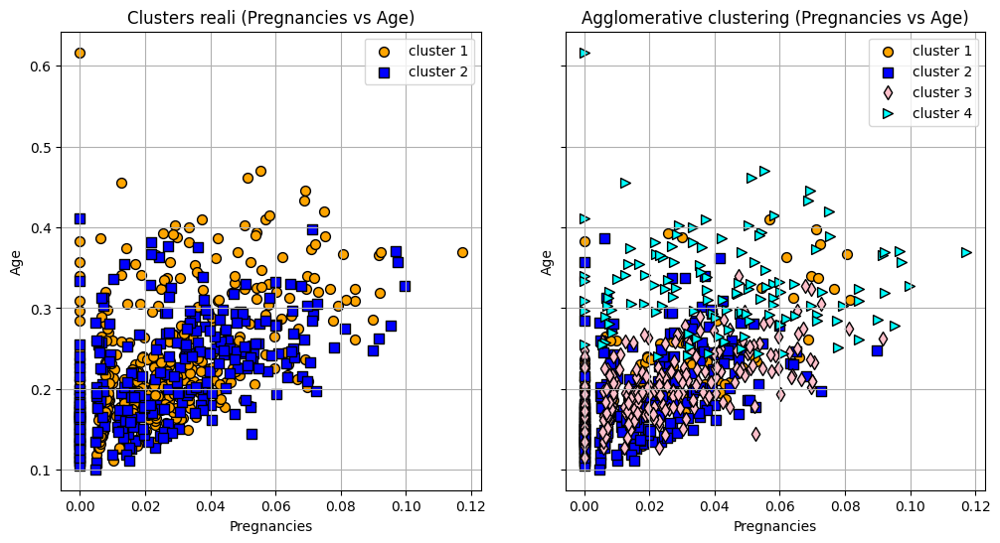

...

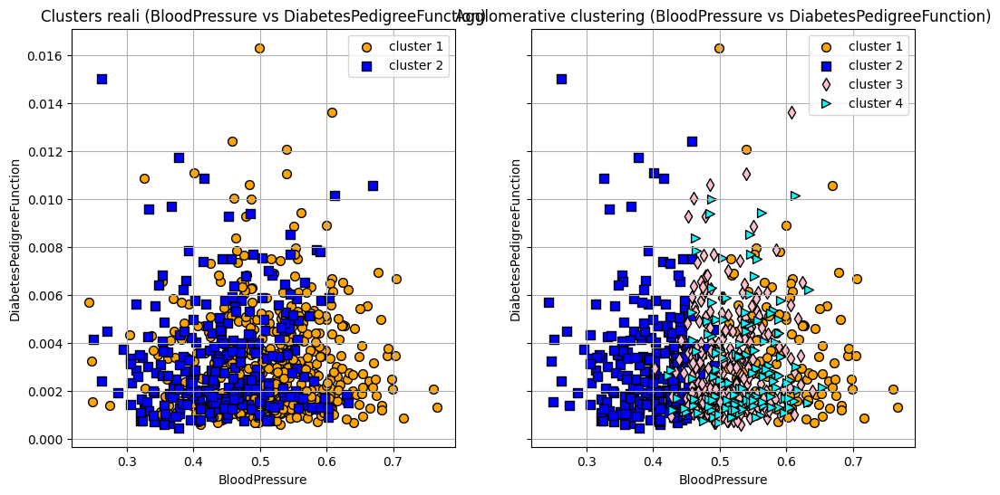

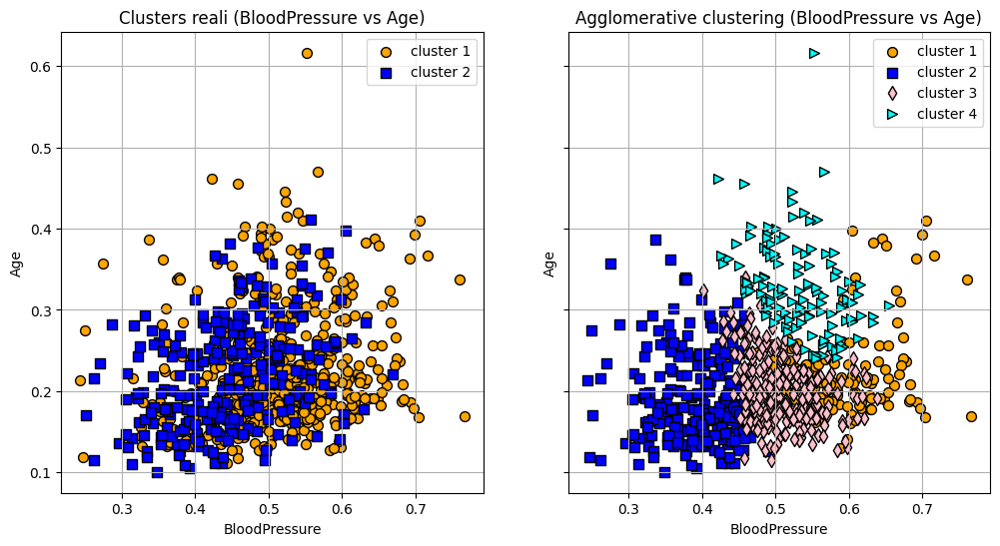

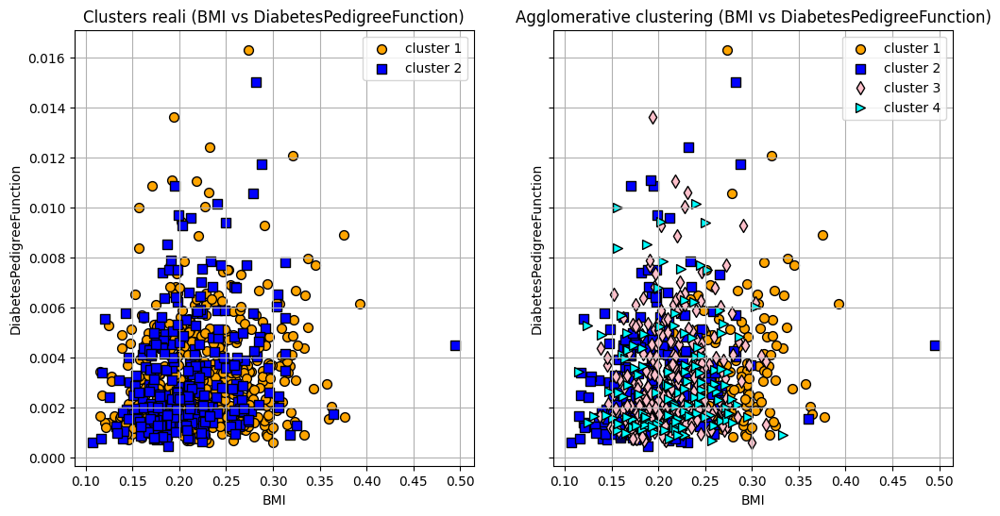

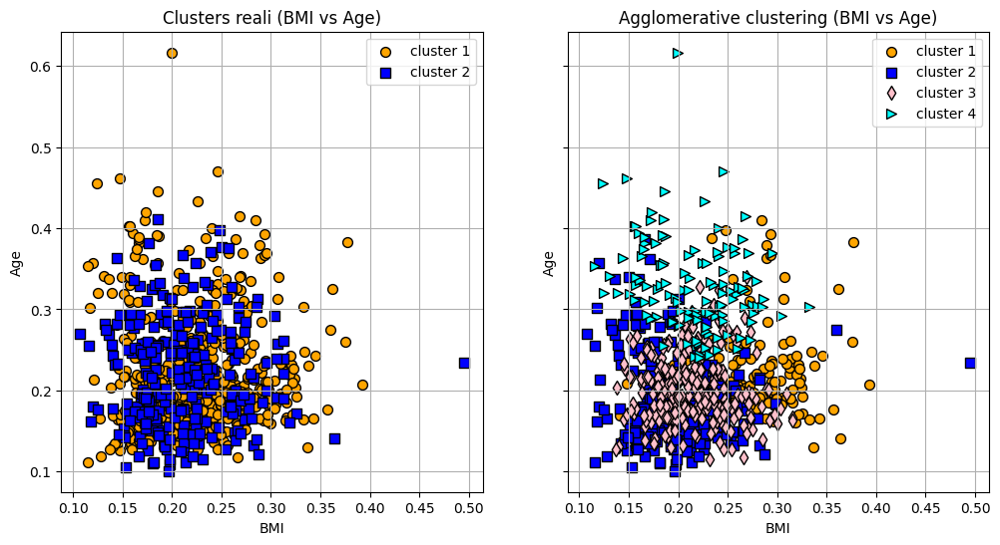

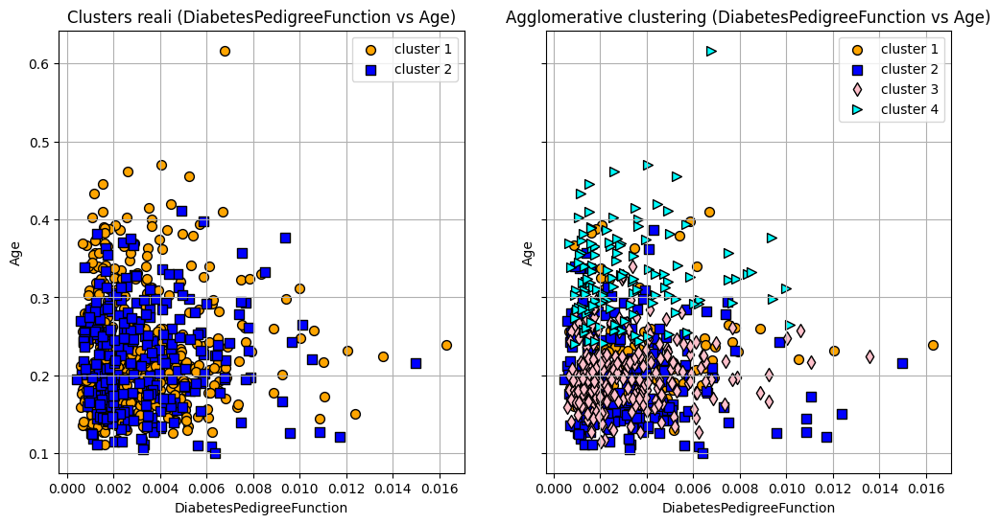

In [62]:
n_clusters = 4

ac = AgglomerativeClustering(n_clusters=n_clusters)
ac_pred = ac.fit_predict(X)
labels = ac.labels_
colors = [ 'orange', 'blue', 'pink', 'cyan']
markers = [ 'o', 's','d', '>']
columns = X_n.columns

for i in range(len(columns)):
    for j in range(i + 1, len(columns)):
        col_i = columns[i]
        col_j = columns[j]
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6), sharey=True)

        for label in np.unique(y):
            ax1.scatter(X[y == label, i], X[y == label, j],
                        s=50, c=colors[label % len(colors)], marker=markers[label % len(markers)],
                        edgecolor="black", label=f'cluster {label + 1}')
        ax1.set_title(f"Clusters reali ({col_i} vs {col_j})")
        ax1.set_xlabel(col_i)
        ax1.set_ylabel(col_j)
        ax1.legend(scatterpoints=1)
        ax1.grid()

        for cluster in range(n_clusters):
            ax2.scatter(X[ac_pred == cluster, i], X[ac_pred == cluster, j],
                        s=50, c=colors[cluster % len(colors)], marker=markers[cluster % len(markers)],
                        edgecolor="black", label=f'cluster {cluster + 1}')


        ax2.set_title(f"Agglomerative clustering ({col_i} vs {col_j})")
        ax2.set_xlabel(col_i)
        ax2.set_ylabel(col_j)
        ax2.legend(scatterpoints=1)
        ax2.grid()

        plt.show()

In [63]:
print("Risultati intermedi AgglomerativeCluster - Normalizer con k=4")
from sklearn.metrics import silhouette_score, rand_score
ss=silhouette_score(X, ac_pred, metric="euclidean")
print("Silhouette score:",ss)

ris=rand_score(y,ac_pred)
print("Rand_score:",ris)

df_clusters = pd.DataFrame({'Cluster': ac_pred, 'Classe': y})
cluster_percentages=df_clusters.groupby('Cluster')['Classe'].value_counts(normalize=True).unstack() * 100
cluster_info = cluster_percentages.copy()
cluster_info['Osservazioni'] = df_clusters['Cluster'].value_counts().sort_index()

print("Informazioni sui cluster:")
print(cluster_info)

Risultati intermedi AgglomerativeCluster - Normalizer con k=4
Silhouette score: 0.24317472501832915
Rand_score: 0.49722607018687526
Informazioni sui cluster:
Classe           0          1  Osservazioni
Cluster                                    
0        84.210526  15.789474           133
1        45.454545  54.545455           242
2        72.962963  27.037037           270
3        65.853659  34.146341           123


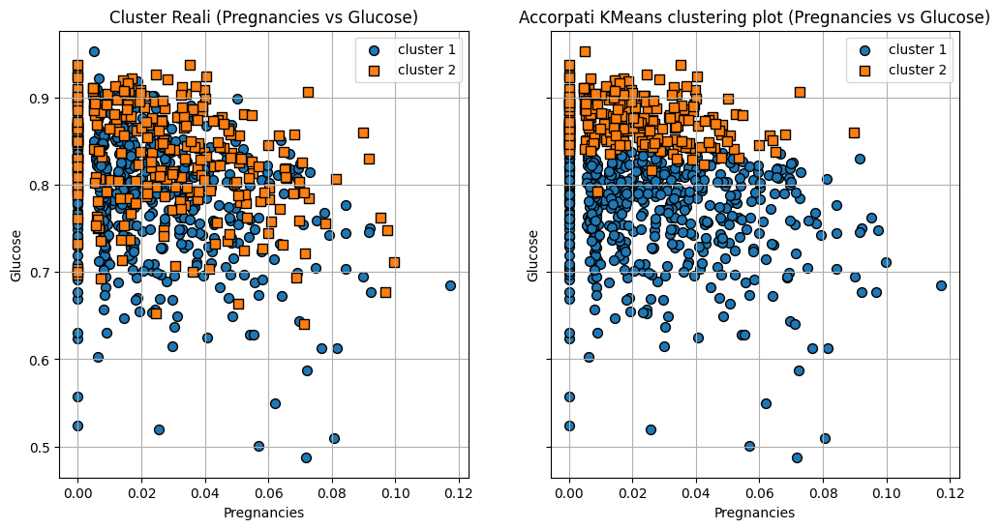

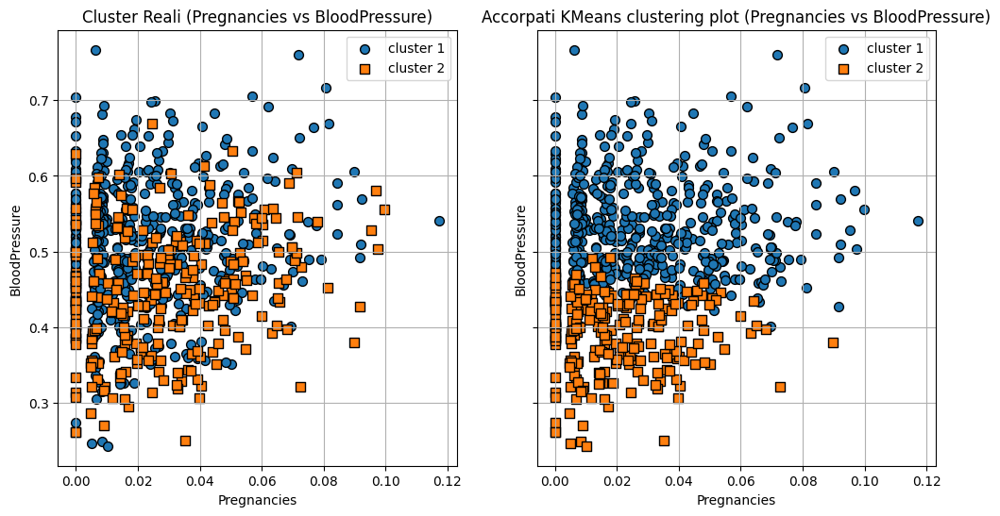

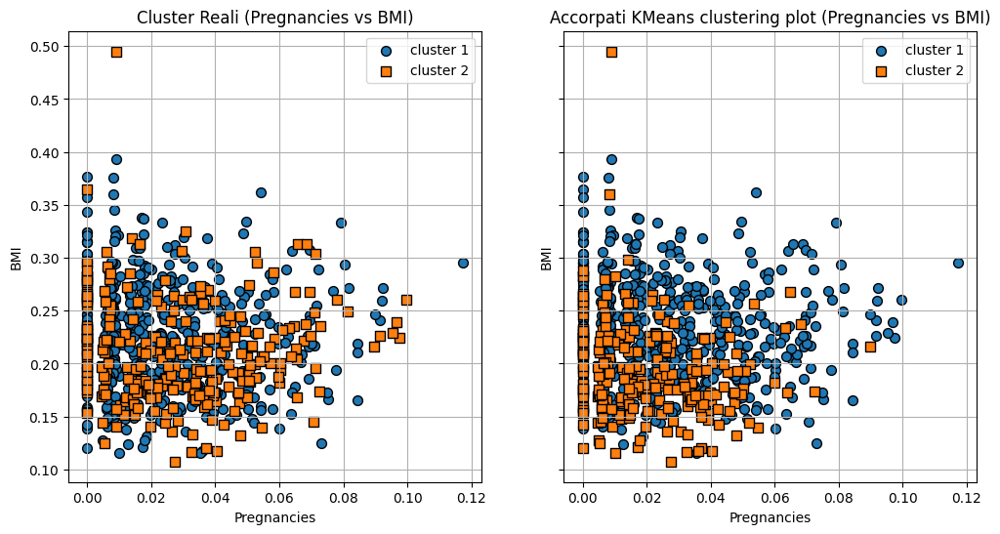

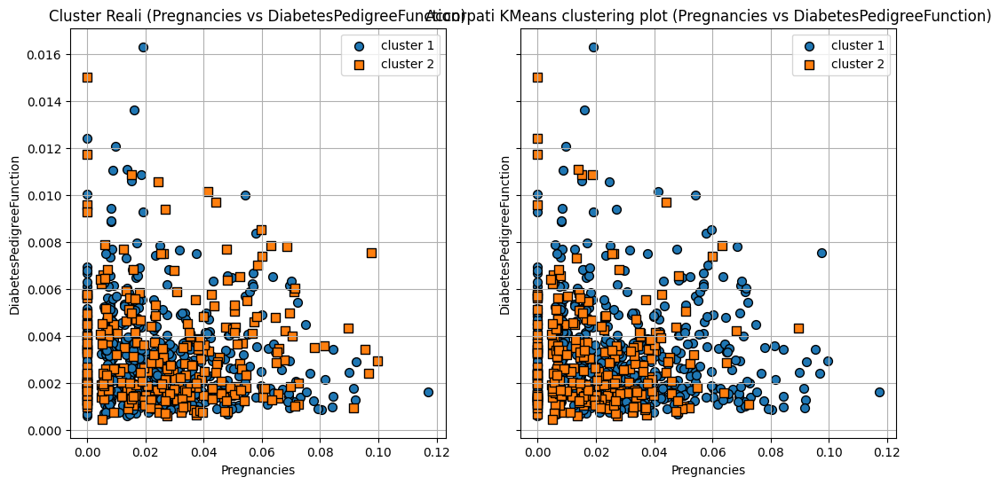

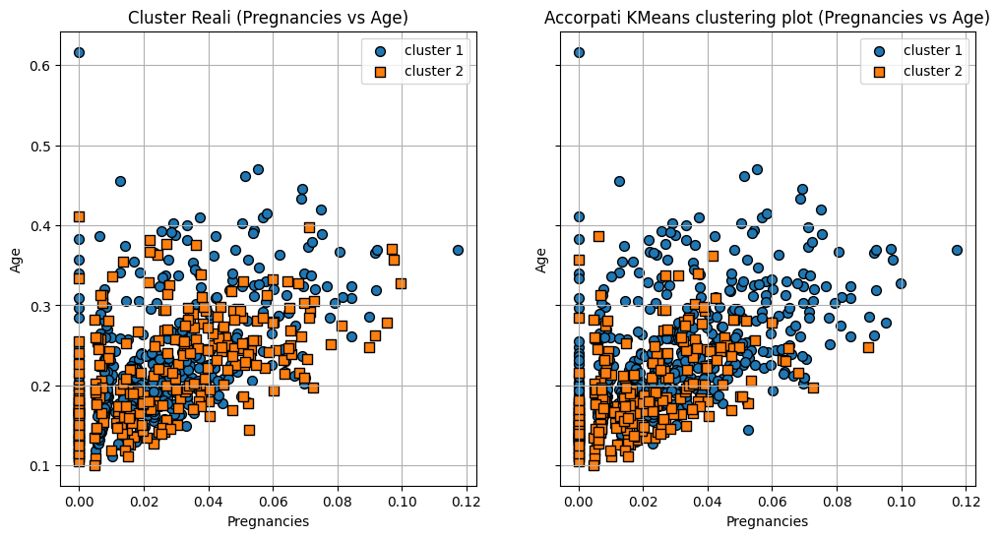

...

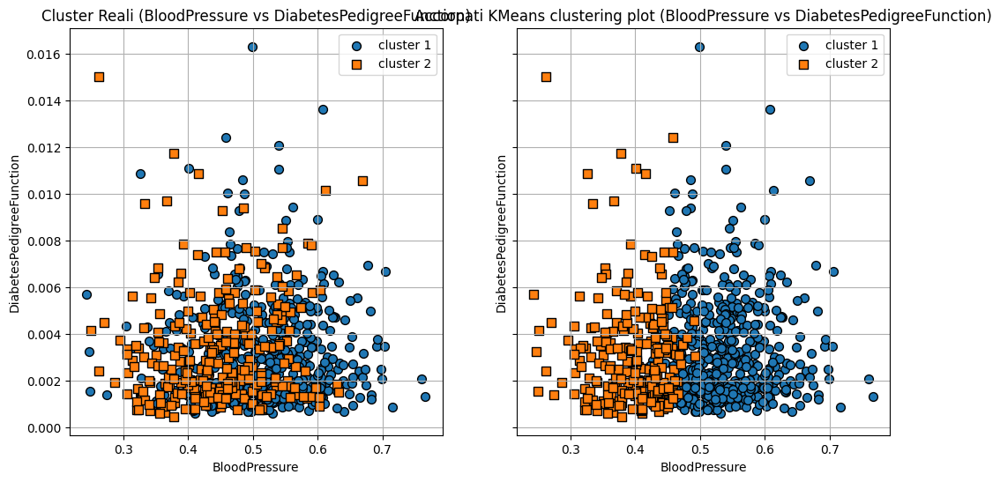

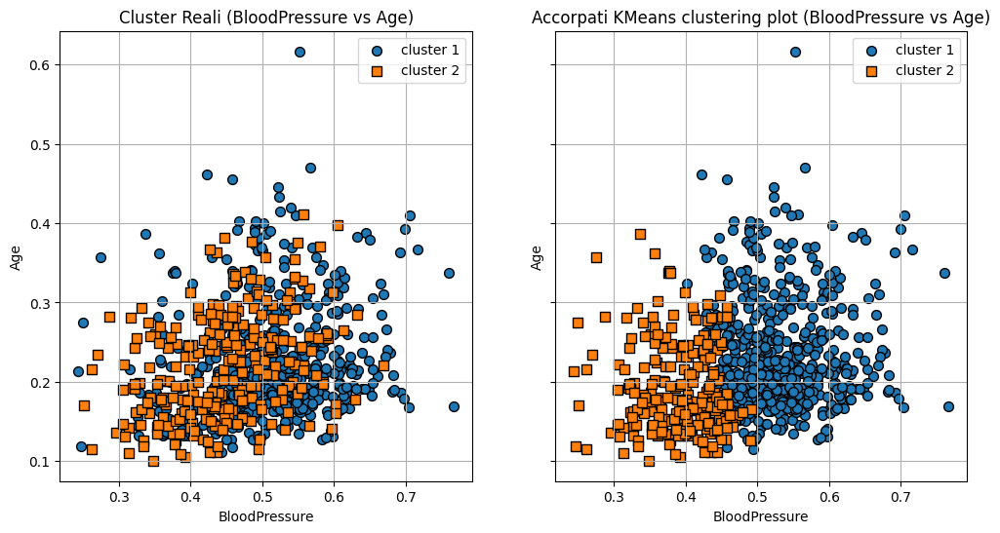

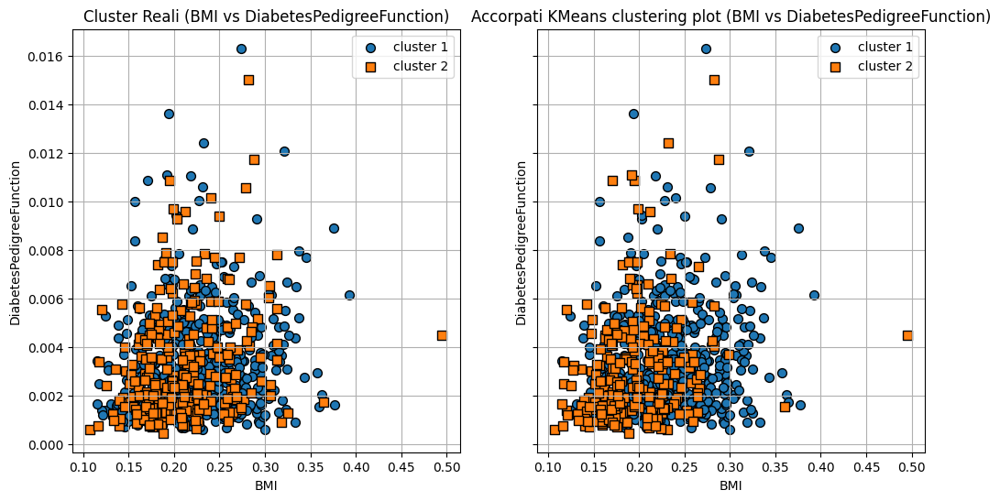

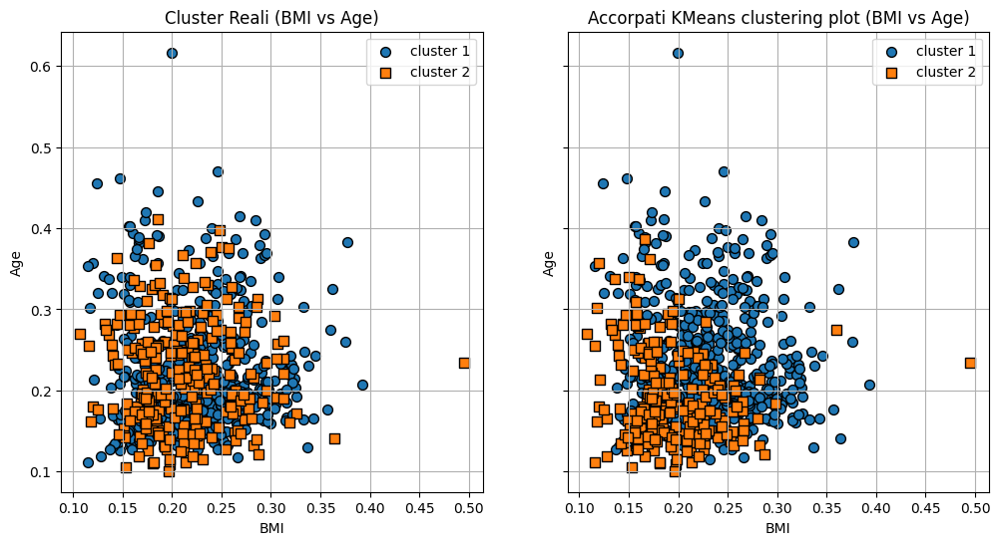

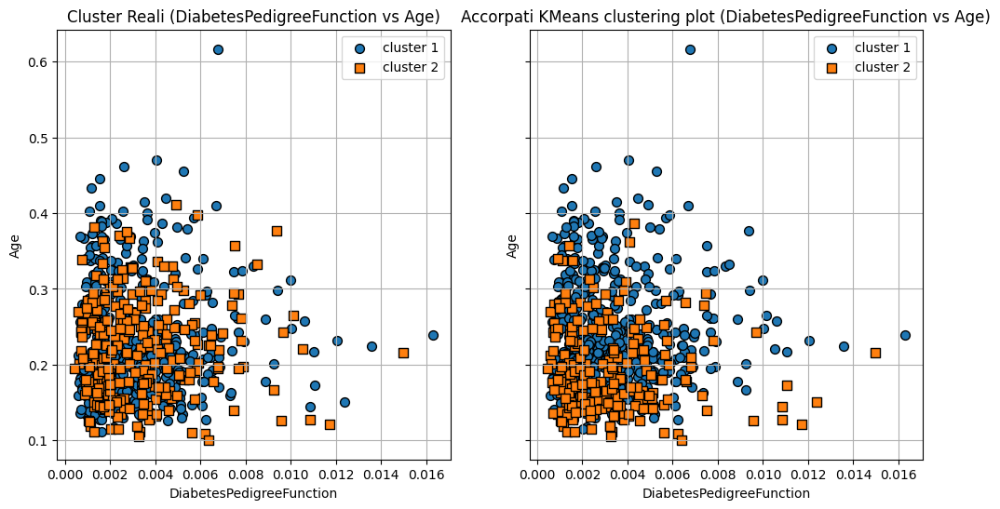

In [64]:
cluster_0 = cluster_percentages[cluster_percentages[0] >= 50].index.tolist()
cluster_1 = cluster_percentages[cluster_percentages[1] > 50].index.tolist()

ac_pred_2_clusters = ac_pred.copy()
for cluster in cluster_0:
    ac_pred_2_clusters[ac_pred == cluster] = 0
for cluster in cluster_1:
    ac_pred_2_clusters[ac_pred == cluster] = 1

columns = X_n.columns

for i in range(len(columns)):
    for j in range(i + 1, len(columns)):
        col_i = columns[i]
        col_j = columns[j]
        
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6), sharey=True)

        for label in np.unique(y):
            ax1.scatter(X[y == label, i], X[y == label, j],
                        s=50, edgecolor="black", label=f'cluster {label + 1}',marker=markers[label % len(markers)])
        ax1.set_title(f"Cluster Reali ({col_i} vs {col_j})")
        ax1.set_xlabel(col_i)
        ax1.set_ylabel(col_j)
        ax1.legend(scatterpoints=1)
        ax1.grid()

        for cluster in range(2): 
            ax2.scatter(X[ac_pred_2_clusters == cluster, i], X[ac_pred_2_clusters == cluster, j],
                        s=50, edgecolor="black", label=f'cluster {cluster + 1}', marker=markers[cluster % len(markers)])
        
        ax2.set_title(f"Accorpati KMeans clustering plot ({col_i} vs {col_j})")
        ax2.set_xlabel(col_i)
        ax2.set_ylabel(col_j)
        ax2.legend(scatterpoints=1)
        ax2.grid()

        plt.show()

Risultati finali per AgglomerativeCluster - Normalizer con k=4
Final Silhouette score: 0.31454836219183807
Final Rand score: 0.5640074967405476
Classification Report:
              precision    recall  f1-score   support

           0       0.74      0.78      0.76       500
           1       0.55      0.49      0.52       268

    accuracy                           0.68       768
   macro avg       0.64      0.64      0.64       768
weighted avg       0.67      0.68      0.68       768



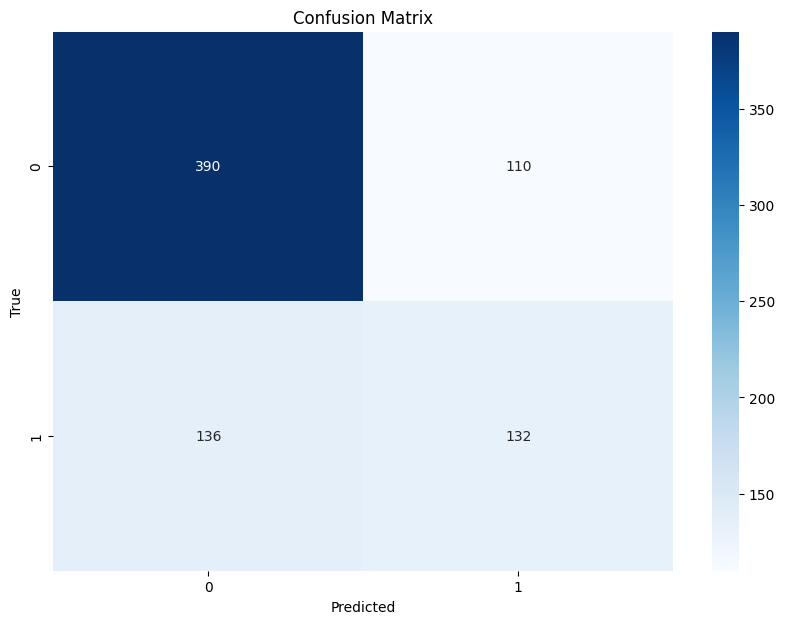

In [65]:
print("Risultati finali per AgglomerativeCluster - Normalizer con k=4")
ss_final = silhouette_score(X, ac_pred_2_clusters, metric="euclidean")
rs_final = rand_score(y, ac_pred_2_clusters)
print("Final Silhouette score:", ss_final)
print("Final Rand score:", rs_final)
report = classification_report(y, ac_pred_2_clusters, target_names=[str(i) for i in np.unique(y)])
print("Classification Report:")
print(report)


conf_matrix = confusion_matrix(y, ac_pred_2_clusters)
plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=np.unique(y), yticklabels=np.unique(y))
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

### Clustering - Valutazioni finali

Alla luce delle nostre analisi, volendo fare un piccolo sommario abbiamo: 

| Metodo | k | Silhouette Score | Rand Score | Precision (0) | Precision (1) | Recall (0) | Recall (1) | F1-Score (0) | F1-Score (1) | Accuracy | Macro Avg (Precision, Recall, F1-Score) | Weighted Avg (Precision, Recall, F1-Score) |
|--------|---|------------------|------------|---------------|---------------|------------|------------|--------------|--------------|----------|----------------------------------------|------------------------------------------------|
| Kmeans - StandardScaler | 2 | 0.2356 | 0.5885 | 0.81 | 0.57 | 0.73 | 0.68 | 0.77 | 0.62 | 0.71 | 0.69, 0.70, 0.69 | 0.73, 0.71, 0.72 |
| Kmeans - StandardScaler | 4 | 0.2187 | 0.5603 | 0.76 | 0.53 | 0.73 | 0.57 | 0.75 | 0.55 | 0.67 | 0.65, 0.65, 0.65 | 0.68, 0.67, 0.68 |
| Kmeans - Normalizer | 2 | 0.3423 | 0.5211 | 0.77 | 0.46 | 0.56 | 0.69 | 0.65 | 0.55 | 0.60 | 0.61, 0.62, 0.60 | 0.66, 0.60, 0.61 |
| Kmeans - Normalizer | 4 | 0.3088 | 0.5768 | 0.74 | 0.58 | 0.82 | 0.47 | 0.78 | 0.52 | 0.70 | 0.66, 0.64, 0.65 | 0.69, 0.70, 0.69 |
| AgglomerativeClustering - StandardScaler | 2 | 0.2239 | 0.5533 | 0.73 | 0.52 | 0.76 | 0.48 | 0.75 | 0.50 | 0.66 | 0.63, 0.62, 0.62 | 0.66, 0.66, 0.66 |
| AgglomerativeClustering - StandardScaler | 3 | 0.2082 | 0.5621 | 0.79 | 0.53 | 0.69 | 0.65 | 0.74 | 0.59 | 0.68 | 0.66, 0.67, 0.66 | 0.70, 0.68, 0.68 |
| AgglomerativeClustering - Normalizer | 2 | 0.3145 | 0.5640 | 0.74 | 0.55 | 0.78 | 0.49 | 0.76 | 0.52 | 0.68 | 0.64, 0.64, 0.64 | 0.67, 0.68, 0.68 |


Quindi possiamo affermare che se dovessimo usare questo modello per una classificazione la scelta migliore sarebbe un KMeans con normalizzazione StandardScaler  e con k=2 che ha un ottimo rand score infatti le metriche ottenute per la classificazione sono simili a quelle di modelli supervisionati visti nello step precedente, se però vogliamo usare il cluster per estrapolare nuova conoscenza probabilmente la scelta migliore è un Kmeans con normalizzazione Normalizer e con K=4 a causa della sua Silhouette che però resta comunque bassa.

Osservando che le precisioni sulla classe 1 non si spingono oltre il 58% nei modelli finali e che nei risultati intermedi nei modelli con k>2 gli n cluster identificati non hanno una prevalenza di classe 1 tale per cui possiamo investigare i dati per estrapolare nuova conoscenza relativa al problema, purtroppo non possiamo estrapolare nuove informazioni dai nostri dati

## Step 4: Ensemble model

Dato che, tra gli algoritmi supervisionati che abbiamo visto prima i decision tree si comportavano bene in termini di performance, come modelli ensemble cerchiamo di sfruttare questa cosa utilizzando un random forest, come secondo modello invece sfruttiamo i risultati ottenuti sulle SVM e costruiamo un AdaBoost di SVM 

### Random Forest


In [186]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report, roc_curve, roc_auc_score
from sklearn import metrics
import matplotlib.pyplot as plt
import seaborn as sns

X = df_adj.drop(columns=['Outcome'])
y = df_adj['Outcome']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, stratify=y, random_state=42)




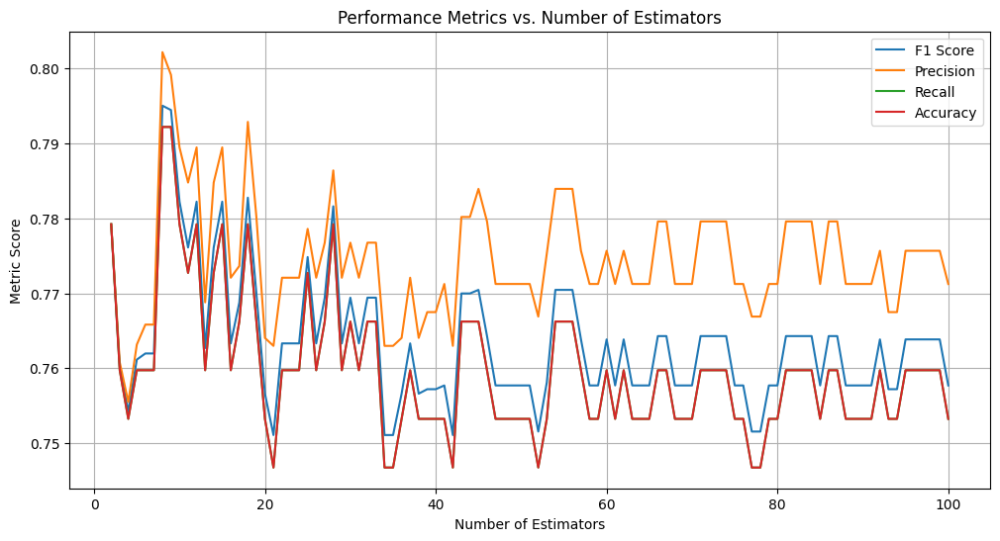

In [130]:
f1_scores = []
precisions = []
recalls = []
accuracy = []

for i in range(2, 101, 1):  
    rf = RandomForestClassifier(n_estimators=i, criterion='entropy', random_state=42,max_depth=3,class_weight='balanced')
    rf.fit(X_train, y_train)
    prediz = rf.predict(X_test)
    report = classification_report(y_test, prediz, output_dict=True)
    f1_scores.append(report['weighted avg']['f1-score'])
    precisions.append(report['weighted avg']['precision'])
    recalls.append(report['weighted avg']['recall'])
    accuracy.append(report['accuracy'])


plt.figure(figsize=(12, 6))
plt.plot(range(2, 101, 1), f1_scores, label='F1 Score')
plt.plot(range(2, 101, 1), precisions, label='Precision')
plt.plot(range(2, 101, 1), recalls, label='Recall')
plt.plot(range(2, 101, 1), accuracy, label='Accuracy')
plt.xlabel('Number of Estimators')
plt.ylabel('Metric Score')
plt.title('Performance Metrics vs. Number of Estimators')
plt.legend()
plt.grid(True)
plt.show()

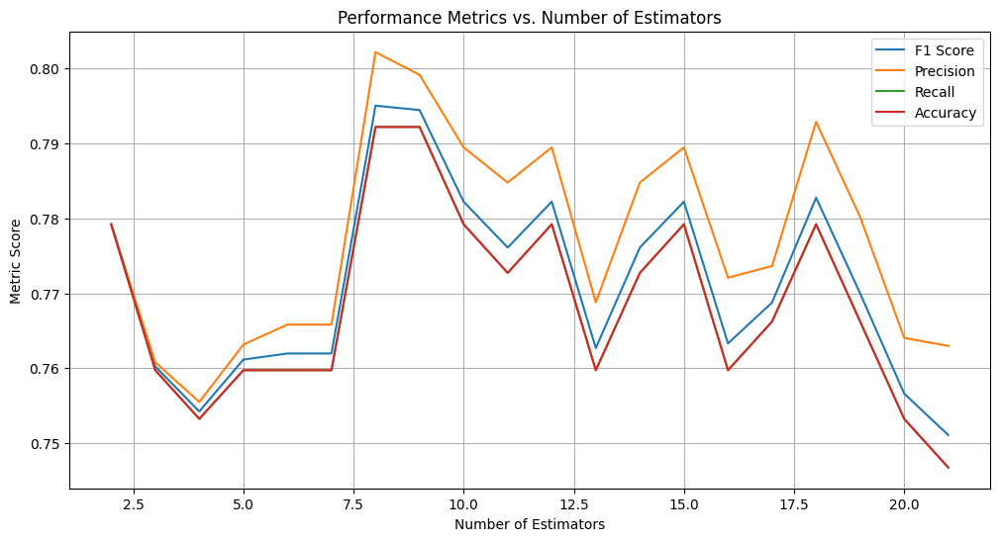

In [137]:
plt.figure(figsize=(12, 6))
plt.plot(range(2, 22, 1), f1_scores[0:20], label='F1 Score')
plt.plot(range(2, 22, 1), precisions[0:20], label='Precision')
plt.plot(range(2, 22, 1), recalls[0:20], label='Recall')
plt.plot(range(2, 22, 1), accuracy[0:20], label='Accuracy')
plt.xlabel('Number of Estimators')
plt.ylabel('Metric Score')
plt.title('Performance Metrics vs. Number of Estimators')
plt.legend()
plt.grid(True)
plt.show()

In [190]:
import time
start=time.time()
rf = RandomForestClassifier(n_estimators=8, criterion='entropy', max_depth=3,random_state=42,class_weight='balanced')
rf.fit(X_train, y_train)
tempo_add=time.time()-start
print("Tempo di esecuzione: ", tempo_add,"sec",sep="")
prediz = rf.predict(X_test)
report = classification_report(y_test, prediz)
print(report)

Tempo di esecuzione: 0.01703023910522461sec
              precision    recall  f1-score   support

           0       0.87      0.80      0.83       100
           1       0.68      0.78      0.72        54

    accuracy                           0.79       154
   macro avg       0.77      0.79      0.78       154
weighted avg       0.80      0.79      0.80       154



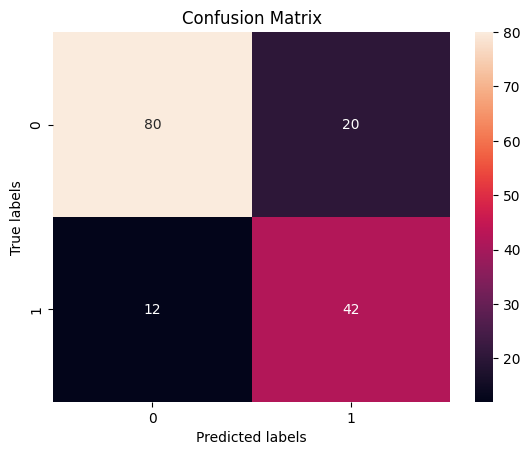

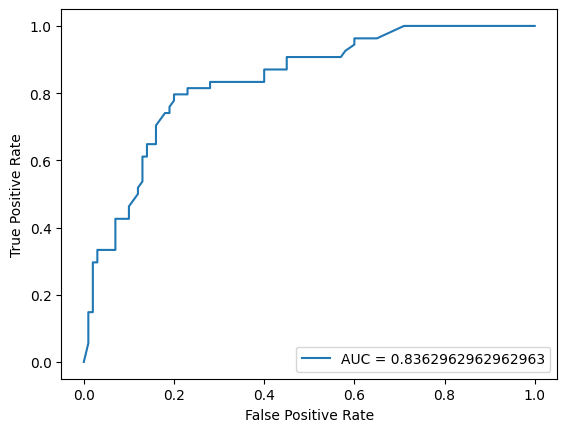

In [138]:
from sklearn import metrics
import seaborn as sns 

cf_matrix = metrics.confusion_matrix(y_test, prediz)
ax = plt.subplot()
sns.heatmap(cf_matrix, annot=True, ax=ax, fmt='g')
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')
y_test_pred_prob = rf.predict_proba(X_test)[:, 1]
fpr, tpr, _ = roc_curve(y_test, y_test_pred_prob)
auc = roc_auc_score(y_test, y_test_pred_prob)
plt.figure()
plt.plot(fpr, tpr, label="AUC = " + str(auc))
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend(loc=4)

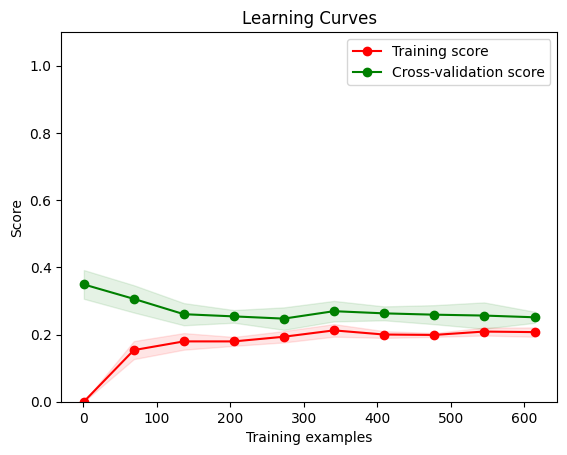

In [139]:

cv = KFold(n_splits=5, shuffle=True, random_state=42)
train_sizes = np.linspace(1, 614, 10).astype(int)

train_sizes, train_scores, test_scores = learning_curve(
    rf, np.concatenate([X_train, X_test]), np.concatenate([y_train, y_test]), cv=cv, train_sizes=train_sizes, scoring='accuracy')

train_scores_mean = 1-np.mean(train_scores, axis=1)
train_scores_std = np.std(train_scores, axis=1)
test_scores_mean = 1-np.mean(test_scores, axis=1)
test_scores_std = np.std(test_scores, axis=1)

plt.figure()
plt.title('Learning Curves')
plt.xlabel('Training examples')
plt.ylabel('Score')
plt.ylim(0.0, 1.1)

plt.fill_between(train_sizes, train_scores_mean - train_scores_std, train_scores_mean + train_scores_std, alpha=0.1, color='r')
plt.plot(train_sizes, train_scores_mean, 'o-', color='r', label='Training score')

plt.fill_between(train_sizes, test_scores_mean - test_scores_std, test_scores_mean + test_scores_std, alpha=0.1, color='g')
plt.plot(train_sizes, test_scores_mean, 'o-', color='g', label='Cross-validation score')

plt.legend(loc='best')
plt.show()

### AdaBoost

In [178]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report, roc_curve, roc_auc_score
from sklearn import metrics
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler

X = df_adj.drop(columns=['Outcome'])
y = df_adj['Outcome']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2,random_state=42)

scaler=StandardScaler()
scaler.fit(X_train)
X_train=scaler.transform(X_train)
X_test=scaler.transform(X_test)

In [179]:
from sklearn.svm import SVC
sig_svm = SVC(kernel='sigmoid', C=0.1, gamma=0.1, probability=True)
sig_svm.fit(X_train, y_train)
y_pred = sig_svm.predict(X_test)
print(classification_report(y_test,y_pred))

              precision    recall  f1-score   support

           0       0.80      0.87      0.83        99
           1       0.72      0.60      0.65        55

    accuracy                           0.77       154
   macro avg       0.76      0.73      0.74       154
weighted avg       0.77      0.77      0.77       154



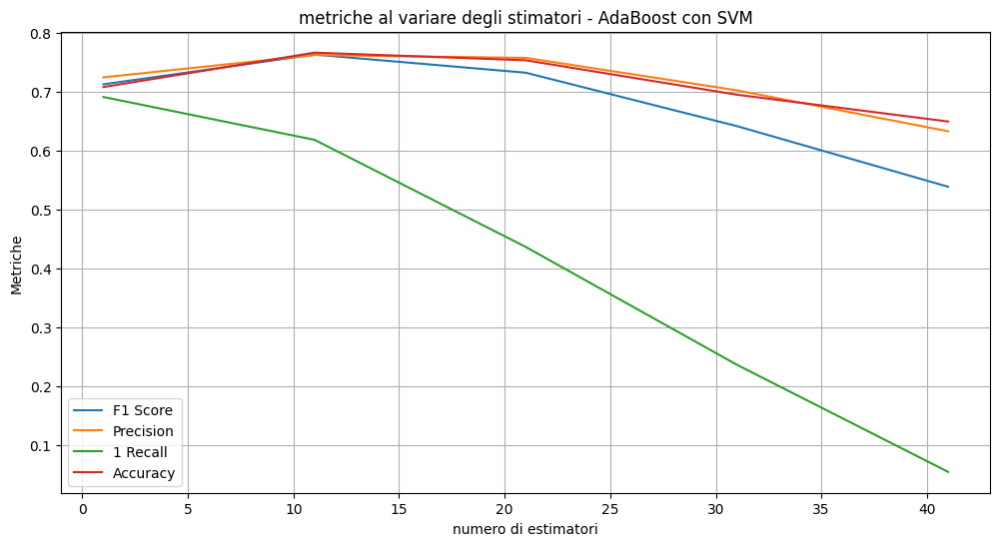

In [180]:
f1_scores = []
precisions = []
recalls = []
accuracy = []

for i in range(1, 51, 10):  
    svm_boost = AdaBoostClassifier(sig_svm,
                                   n_estimators=i, learning_rate=0.1)
    svm_boost.fit(X_train, y_train)
    prediz = svm_boost.predict(X_test)
    report = classification_report(y_test, prediz, output_dict=True)
    f1_scores.append(report['weighted avg']['f1-score'])
    precisions.append(report['weighted avg']['precision'])
    recalls.append(report['1']['recall'])
    accuracy.append(report['accuracy'])


plt.figure(figsize=(12, 6))
plt.plot(range(1, 51, 10), f1_scores, label='F1 Score')
plt.plot(range(1, 51, 10), precisions, label='Precision')
plt.plot(range(1, 51, 10), recalls, label='1 Recall')
plt.plot(range(1, 51, 10), accuracy, label='Accuracy')
plt.xlabel('numero di estimatori')
plt.ylabel('Metriche')
plt.title('metriche al variare degli stimatori - AdaBoost con SVM')
plt.legend()
plt.grid(True)
plt.show()

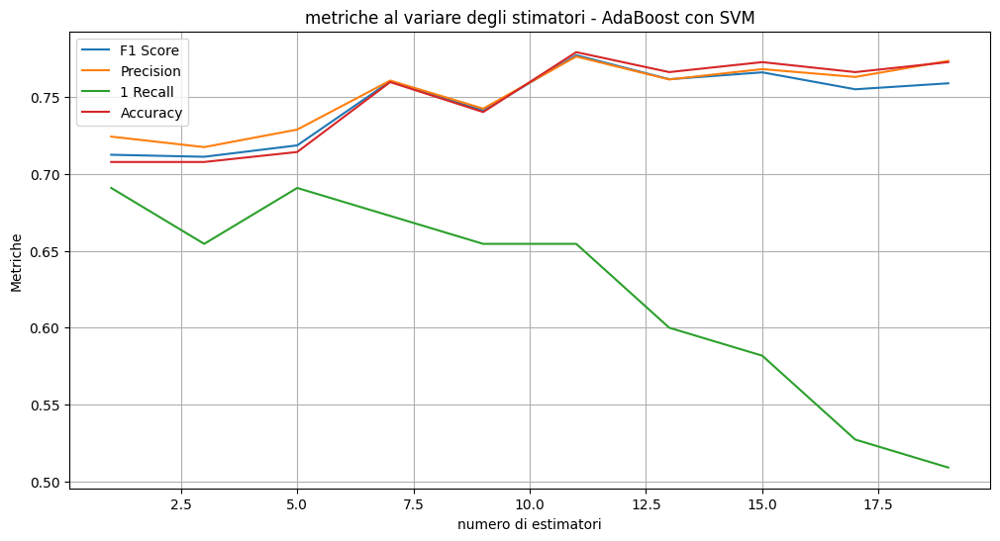

In [143]:
f1_scores = []
precisions = []
recalls = []
accuracy = []

for i in range(1, 21, 2):  
    svm_boost = AdaBoostClassifier(sig_svm,
                                   n_estimators=i, learning_rate=0.1)
    svm_boost.fit(X_train, y_train)
    prediz = svm_boost.predict(X_test)
    report = classification_report(y_test, prediz, output_dict=True)
    f1_scores.append(report['weighted avg']['f1-score'])
    precisions.append(report['weighted avg']['precision'])
    recalls.append(report['1']['recall'])
    accuracy.append(report['accuracy'])

plt.figure(figsize=(12, 6))
plt.plot(range(1, 21, 2), f1_scores, label='F1 Score')
plt.plot(range(1, 21, 2), precisions, label='Precision')
plt.plot(range(1, 21, 2), recalls, label='1 Recall')
plt.plot(range(1, 21, 2), accuracy, label='Accuracy')
plt.xlabel('numero di estimatori')
plt.ylabel('Metriche')
plt.title('metriche al variare degli stimatori - AdaBoost con SVM')
plt.legend()
plt.grid(True)
plt.show()

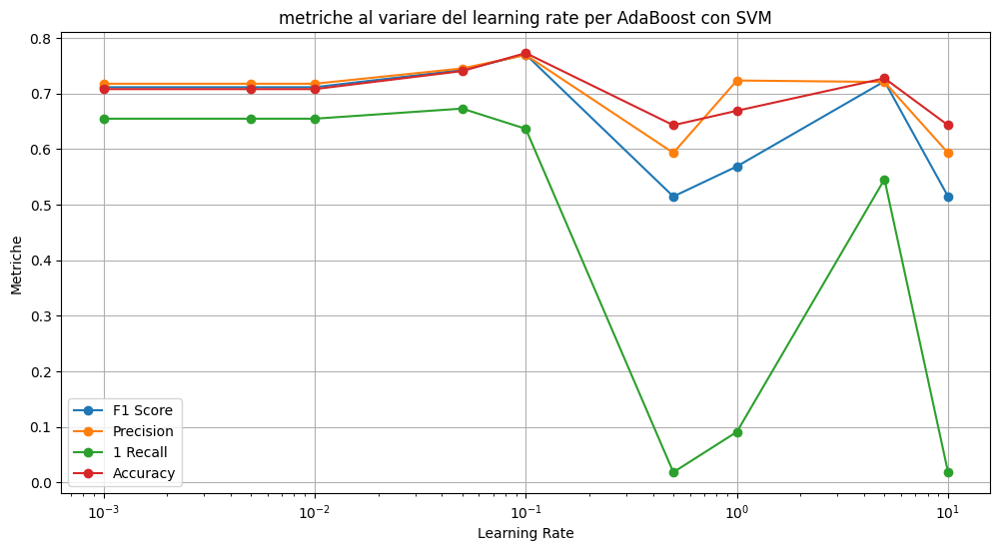

In [67]:
learning_rates = [0.001, 0.005, 0.01, 0.05, 0.1, 0.5, 1.0, 5.0, 10.0]
f1_scores = []
precisions = []
recalls = []
accuracy = []
for lr in learning_rates:
    svm_boost = AdaBoostClassifier(sig_svm,
                                   n_estimators=11, learning_rate=lr)
    svm_boost.fit(X_train, y_train)
    prediz = svm_boost.predict(X_test)
    report = classification_report(y_test, prediz, output_dict=True)
    f1_scores.append(report['weighted avg']['f1-score'])
    precisions.append(report['weighted avg']['precision'])
    recalls.append(report['1']['recall'])
    accuracy.append(report['accuracy'])


plt.figure(figsize=(12, 6))
plt.plot(learning_rates, f1_scores, label='F1 Score', marker='o')
plt.plot(learning_rates, precisions, label='Precision', marker='o')
plt.plot(learning_rates, recalls, label='1 Recall', marker='o')
plt.plot(learning_rates, accuracy, label='Accuracy', marker='o')
plt.xlabel('Learning Rate')
plt.ylabel('Metriche')
plt.xscale("log")
plt.title('metriche al variare del learning rate per AdaBoost con SVM')
plt.legend()
plt.grid(True)
plt.show()

In [181]:
start=time.time()
svm_boost = AdaBoostClassifier(sig_svm,
                                   n_estimators=11, learning_rate=0.1)
svm_boost.fit(X_train, y_train)
tempo_add=time.time()-start
print("Tempo di esecuzione: ", tempo_add,"sec",sep="")
prediz = svm_boost.predict(X_test)
report = classification_report(y_test, prediz)
print(report)

Tempo di esecuzione: 0.8032455444335938sec
              precision    recall  f1-score   support

           0       0.82      0.85      0.83        99
           1       0.71      0.65      0.68        55

    accuracy                           0.78       154
   macro avg       0.76      0.75      0.76       154
weighted avg       0.78      0.78      0.78       154



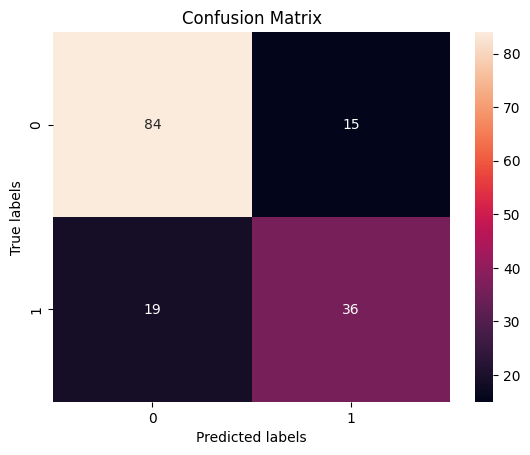

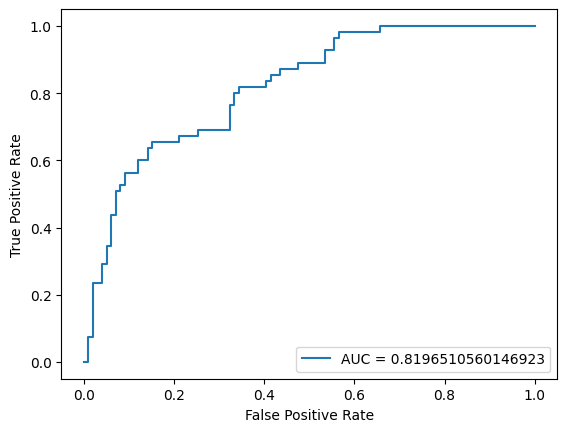

In [161]:
from sklearn import metrics
import seaborn as sns 

cf_matrix = metrics.confusion_matrix(y_test, prediz)
ax = plt.subplot()
sns.heatmap(cf_matrix, annot=True, ax=ax, fmt='g')
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')
y_test_pred_prob = svm_boost.predict_proba(X_test)[:, 1]
fpr, tpr, _ = roc_curve(y_test, y_test_pred_prob)
auc = roc_auc_score(y_test, y_test_pred_prob)
plt.figure()
plt.plot(fpr, tpr, label="AUC = " + str(auc))
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend(loc=4)

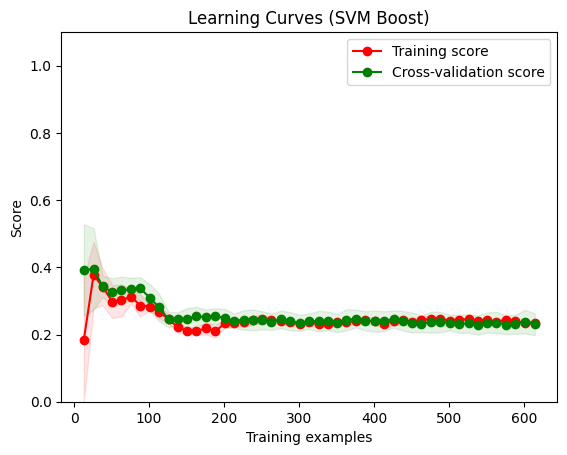

In [158]:
cv = KFold(n_splits=5, shuffle=True, random_state=42)
train_sizes = np.linspace(1, 614, 50).astype(int)

train_sizes, train_scores, test_scores = learning_curve(svm_boost, np.concatenate([X_train, X_test]), np.concatenate([y_train, y_test]), cv=cv, train_sizes=train_sizes, scoring='accuracy')

train_scores_mean = 1-np.mean(train_scores, axis=1)
train_scores_std = np.std(train_scores, axis=1)
test_scores_mean = 1-np.mean(test_scores, axis=1)
test_scores_std = np.std(test_scores, axis=1)

plt.figure()
plt.title('Learning Curves (SVM Boost)')
plt.xlabel('Training examples')
plt.ylabel('Score')
plt.ylim(0.0, 1.1)

plt.fill_between(train_sizes, train_scores_mean - train_scores_std, train_scores_mean + train_scores_std, alpha=0.1, color='r')
plt.plot(train_sizes, train_scores_mean, 'o-', color='r', label='Training score')

plt.fill_between(train_sizes, test_scores_mean - test_scores_std, test_scores_mean + test_scores_std, alpha=0.1, color='g')
plt.plot(train_sizes, test_scores_mean, 'o-', color='g', label='Cross-validation score')

plt.legend(loc='best')
plt.show()

### Ensemble a confronto

Volendo fare un sommario relativamente ai nostri risultati per i modelli Ensemble
| Metric               | AdaBoost      | RandomForest  |
|----------------------|---------------|---------------|
| **Precision (Class 0)** | 0.82          | 0.87          |
| **Recall (Class 0)**    | 0.85          | 0.80          |
| **F1-Score (Class 0)**  | 0.83          | 0.83          |
| **Precision (Class 1)** | 0.71          | 0.68          |
| **Recall (Class 1)**    | 0.65          | 0.78          |
| **F1-Score (Class 1)**  | 0.68          | 0.72          |
| **Accuracy**            | 0.78          | 0.79          |
| **Macro Avg Precision** | 0.76          | 0.77          |
| **Macro Avg Recall**    | 0.75          | 0.79          |
| **Macro Avg F1-Score**  | 0.76          | 0.78          |
| **Weighted Avg Precision** | 0.78      | 0.80          |
| **Weighted Avg Recall**    | 0.78      | 0.79          |
| **Weighted Avg F1-Score**  | 0.78      | 0.80          |
| **AUC**                 | 0.819         | 0.836         |
| **Tempo di Addestramento** | 0.80s        | 0.029s        |

Otteniamo che, i risultati migliori si ottengono per il nostro RandomForest che non solo ha una buona accuracy (79%) ma ha anche una Recall rispetto alla classe 1 molto maggiore rispetto al nostro modello AdaBoost, ha una migliore AUC ed è anche molto più performante in termini di tempo per l'addestramento (circa 30 volte più veloce) , quindi mediante questa tecnica noi stiamo migliorando sensibilmente l'accuracy, migliorando di molto la recall sulla classe malato che è quella che poi porta ad un miglior beneficio in termini di salute pubblica e del cittadino,  


## Confronto Decision Tree - Random Forest

Andando a confrontare i risultati di un Decision Tree semplice ed una foresta di alberi

| Metric               | Decision Tree (Entropy, max_depth=4, min_samples_leaf=10) | Random Forest(Entropy, max_depth=3, weigth='balanced') |
|----------------------|----------------------------------------------------------|---------------|
| **Classe 0**         |                                                          |               |
| Precision            | 0.89                                                     | 0.87          |
| Recall               | 0.79                                                     | 0.80          |
| F1-Score             | 0.84                                                     | 0.83          |
| **Classe 1**         |                                                          |               |
| Precision            | 0.68                                                     | 0.68          |
| Recall               | 0.81                                                     | 0.78          |
| F1-Score             | 0.74                                                     | 0.72          |
| **Generali**         |                                                          |               |
| Accuracy             | 0.80                                                     | 0.79          |
| Macro Avg Precision  | 0.78                                                     | 0.77          |
| Macro Avg Recall     | 0.80                                                     | 0.79          |
| Macro Avg F1-Score   | 0.79                                                     | 0.78          |
| Weighted Avg Precision | 0.81                                                   | 0.80          |
| Weighted Avg Recall  | 0.80                                                     | 0.79          |
| Weighted Avg F1-Score | 0.80                                                   | 0.80          |
| **AUC**              | 0.81                                                     | 0.836         |

Osserviamo come l'utilizzo di un modello Ensemble non abbia portato a un netto miglioramento, questo perchè il nostro dataset è di sole 729 osservazioni quindi non riusciamo ad utilizzare a pieno la potenza del RandomForest, al contrario invece il decision tree a valle di un opportuno pruning riesce a generalizzare bene sui nostri dati pur essendo un modello semplice



# Utility

In questa sezione ci sono funzioni che potrebbero tornare utili durante questo progetto

In [11]:
from collections import Counter
from sklearn.metrics import confusion_matrix
import random
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import KFold, learning_curve, StratifiedKFold
from sklearn.metrics import classification_report, precision_score, recall_score, f1_score, accuracy_score
import numpy as np
from sklearn import metrics
from sklearn.preprocessing import PolynomialFeatures

def df_distr(df, target_name):
	target_dict=Counter(df[target_name]) #ottengo un dizionario con coppie chiave valore con classe-conteggio classe

	dum=0
	for i in range (0,len(target_dict.keys())):
		dum=dum+list(target_dict.values())[i] #calcolo il denominatore

	l=[]
	for i in range(0,len(target_dict.keys())):
		l.append(list(target_dict.values())[i]/dum*100)
		print(f"percentuale di classe ",list(target_dict.keys())[i] ,": ",round(l[i]), "%", sep="" )

	if(l[0]<55 and l[0]>45):
		print("il dataset è bilanciato")
	else:
		print("il dataset non è bilanciato")


def target_plot(df, target_name):
	target_dict=Counter(df[target_name])
	fig,ax=plt.subplots()
	colors=[]
	for i in range(len(target_dict.keys())): #genero N colori casuali pari al numero di classi della colonna target in esadecimale
	 colors.append("#")
	 for j in range(6):
	  colors[i]=colors[i]+(random.choice('0123456789ABCDEF'))

	for labe, color in zip(list(target_dict.keys()), colors):
	  ax.hist(df[target_name][df[target_name]==labe],
	  label=labe,
	  color=color)


	ax.legend(loc="upper right")
	plt.show()

def feature_hist(df ,n_col=3):
	nfeat=df.shape[1]-1
	cols=round(nfeat/n_col+0.5)
	plt.figure(figsize=(15,round(2*(cols+1))))
	for i, feature in enumerate(zip(range(nfeat))):
	  plt.subplot(cols,n_col,i+1)
	  plt.hist(df.iloc[:,i],
	           label=df.columns[i],
	           color="blue")
	  plt.title(df.columns[i])
	  plt.tight_layout()

	plt.show()


def feature_in_labels(df, target_name, n_col=6):
	nfeat=df.shape[1]-1
	target_dict=Counter(df[target_name])
	if (len(target_dict.keys())>2):
		colors=[]
		for i in range(len(target_dict.keys())): #genero N colori casuali pari al numero di classi della colonna target in esadecimale
			colors.append("#")
			for j in range(6):
			 colors[i]=colors[i]+(random.choice('0123456789ABCDEF'))
	else:
			colors=["red","blue"]
	features=list(df.columns)
	features.remove(target_name)
	cols=round(nfeat/n_col+0.5)
	plt.figure(figsize=(15,round(2*(cols+1))))

	for i, feature in enumerate(zip(range(nfeat))):
	  plt.subplot(cols,n_col,i+1)
	  for label,color in zip(list(target_dict.keys()), colors):
	    plt.hist(df[df[target_name]==label].iloc[:,i],
	            label=label,
	            alpha=0.5,
	            color=color)
	    plt.title(features[i])
	    plt.legend(loc="upper right")

	    plt.tight_layout()

	plt.show()

def feature_in_labels_scatter(df, target_name, nfeat=None, n_col=8):
    target_dict = Counter(df[target_name])
    if (len(target_dict.keys())>2):
        colors = []
        for i in range(len(target_dict.keys())):  
            colors.append("#" + ''.join(random.choice('0123456789ABCDEF') for _ in range(6)))
    else:
        colors = ["red","blue"]
    features = list(df.columns)
    features.remove(target_name)

    if nfeat is None:
        nfeat = len(features)

    n = min(nfeat, len(features))

    fig, ax = plt.subplots(n, n, figsize=(16, 16))

    for x in range(n):
        for y in range(n):
            xname = features[x]
            yname = features[y]
            for label, color in zip(target_dict.keys(), colors):
                ax[x, y].scatter(df[df[target_name] == label][xname],
                                 df[df[target_name] == label][yname],
                                 label=label,
                                 alpha=0.5,
                                 color=color)
            ax[x, y].set_xlabel(xname)
            ax[x, y].set_ylabel(yname)
            if x == 0 and y == 0:
                ax[x, y].legend(loc="upper left")

    plt.tight_layout()
    plt.show()


def kfoldize(kf, rn, shift=.1):
    train=pd.DataFrame()
    test = pd.DataFrame()
    i=1
    for train_index, test_index in kf.split(rn):
        train_df = pd.DataFrame(train_index, columns=["x"])
        train_df["val"]= i - shift
        train = pd.concat([train,train_df])

        test_df = pd.DataFrame(test_index, columns=["x"])
        test_df["val"]= i + shift
        test = pd.concat([test,test_df])
        i += 1

    return train, test


def plot_svc_decision_function(model, df, feature1, feature2, target, ax=None, plot_support=True):
    """Plot the decision function for a 2D SVC"""
    if ax is None:
        ax = plt.gca()

    xlim = (df[feature1].min() - 1, df[feature1].max() + 1)
    ylim = (df[feature2].min() - 1, df[feature2].max() + 1)

   
    x = np.linspace(xlim[0], xlim[1], 30)
    y = np.linspace(ylim[0], ylim[1], 30)
    Y, X = np.meshgrid(y, x)
    xy = np.vstack([X.ravel(), Y.ravel()]).T

    
    n_features = model.n_features_in_
    mean_values = df.drop(columns=[target]).mean().values
    xy_full = np.ones((xy.shape[0], n_features)) * mean_values
    feature_indices = [df.columns.get_loc(feature1), df.columns.get_loc(feature2)]
    xy_full[:, feature_indices[0]] = xy[:, 0]
    xy_full[:, feature_indices[1]] = xy[:, 1]

    P = model.decision_function(xy_full).reshape(X.shape)

    ax.contour(X, Y, P, colors='k', levels=[-1, 0, 1], alpha=0.5, linestyles=['--', '-', '--'])

    if plot_support:
        support_vectors = model.support_vectors_[:, feature_indices]
        ax.scatter(support_vectors[:, 0], support_vectors[:, 1], s=300, linewidth=1, facecolors='none')


    ax.scatter(df[feature1], df[feature2], c=df[target], cmap=plt.cm.coolwarm, s=20, edgecolors='k')
    ax.set_xlim(xlim)
    ax.set_ylim(ylim)
    ax.set_title("SVM Borders dell'ultimo fold")
    ax.set_xlabel(feature1)
    ax.set_ylabel(feature2)

def plot_learning_curve(model, df, target, cv, title="Learning Curve"):
    X = df.drop(columns=[target])
    y = df[target]

    train_sizes, train_scores, test_scores = learning_curve(
        model, X, y, cv=cv, n_jobs=-1, train_sizes=np.linspace(0.01, 1.0, 50)
    )

    train_scores_mean = 1-np.mean(train_scores, axis=1)
    train_scores_std = np.std(train_scores, axis=1)
    test_scores_mean = 1-np.mean(test_scores, axis=1)
    test_scores_std = np.std(test_scores, axis=1)

    plt.figure()
    plt.grid()

    plt.title(title)
    plt.xlabel("Training examples")
    plt.ylabel("Score")
    plt.ylim(0.0, 1.1)

    plt.fill_between(train_sizes, train_scores_mean - train_scores_std, train_scores_mean + train_scores_std, alpha=0.1, color='r')
    plt.fill_between(train_sizes, test_scores_mean - test_scores_std, test_scores_mean + test_scores_std, alpha=0.1, color='g')
    plt.plot(train_sizes, train_scores_mean, 'o-', color="r", label="Training score")
    plt.plot(train_sizes, test_scores_mean, 'o-', color="g", label="Cross-validation score")

    plt.legend(loc="best")
    plt.show()

def svm_kfold(df, n_fold, target, feature1, feature2, kernel, C=1, additional=None):
 kf = KFold (n_splits=n_fold, shuffle=True, random_state=15)

 X=df.loc[:, df.columns != target]
 Y=df[target]
 if (kernel=='rbf'):
  svm = SVC(C=C, kernel=kernel, gamma=additional)
 if (kernel=='poly'):
  svm = SVC(C=C, kernel=kernel, degree=additional)
 if(kernel=='linear'):
  svm = SVC(C=C, kernel=kernel)
 accuracies = []
 precisions = []
 recalls = []
 f1s = []

 for train_index, test_index in kf.split(X):
     X_train, X_test = X.iloc[train_index], X.iloc[test_index]
     y_train, y_test = Y.iloc[train_index], Y.iloc[test_index]

     svm.fit(X_train, y_train)

     y_pred = svm.predict(X_test)

     accuracy = accuracy_score(y_test, y_pred)
     precision = precision_score(y_test, y_pred, average='weighted')
     recall = recall_score(y_test, y_pred, average='weighted')
     f1 = f1_score(y_test, y_pred, average='weighted')

     accuracies.append(accuracy)
     precisions.append(precision)
     recalls.append(recall)
     f1s.append(f1)

 for i, (accuracy, precision, recall, f1) in enumerate(zip(accuracies, precisions, recalls, f1s), 1):
     print(f'Fold {i}: Accuracy = {accuracy:.2f}, Precision = {precision:.2f}, Recall = {recall:.2f}, F1 Score = {f1:.2f}')

 print(f'Accuracy media: {np.mean(accuracies):.2f}')
 print(f'Precision media: {np.mean(precisions):.2f}')
 print(f'Recall media: {np.mean(recalls):.2f}')
 print(f'F1 Score medio: {np.mean(f1s):.2f}')
 return svm

